### Daniel Martínez

In [1]:
import numpy as np
import pandas as pd
import os
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.compose import make_column_transformer
from sklearn.pipeline import make_pipeline
from sklearn import preprocessing 
from sklearn.preprocessing import LabelEncoder
from sklearn import metrics
from sklearn.metrics import classification_report, plot_confusion_matrix
from sklearn.model_selection import cross_val_score
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix
from imblearn.over_sampling import RandomOverSampler, SMOTE, ADASYN
from IPython.display import Image

#### Merging datasets usgin https://www.kaggle.com/andresionek/joining-marketing-funnel-with-brazilian-e-commerce

In [2]:
print('### Marketing Funnel by Olist ###')
for i, file in enumerate(os.listdir(r'C:\Users\d-mar\Documents\DM-prueba-ML-Transfiriendo\marketing-funnel-olist')):
    print(i, '-', file)
print('\n---------------------------------------------\n')

print('### Marketing Funnel by Olist ###')
for i, file in enumerate (os.listdir(r'C:\Users\d-mar\Documents\DM-prueba-ML-Transfiriendo\brazilian-ecommerce')):
    print(i, " - ", file)

### Marketing Funnel by Olist ###
0 - olist_closed_deals_dataset.csv
1 - olist_marketing_qualified_leads_dataset.csv

---------------------------------------------

### Marketing Funnel by Olist ###
0  -  olist_customers_dataset.csv
1  -  olist_geolocation_dataset.csv
2  -  olist_orders_dataset.csv
3  -  olist_order_items_dataset.csv
4  -  olist_order_payments_dataset.csv
5  -  olist_order_reviews_dataset.csv
6  -  olist_products_dataset.csv
7  -  olist_sellers_dataset.csv
8  -  product_category_name_translation.csv


In [3]:
# Load marketing funnel dataset Marketing Qualified Leads
marketing_qualified_leads = pd.read_csv(r'C:\Users\d-mar\Documents\DM-prueba-ML-Transfiriendo\marketing-funnel-olist\olist_marketing_qualified_leads_dataset.csv')
marketing_qualified_leads.head(10)

,mql_id,first_contact_date,landing_page_id,origin
0,dac32acd4db4c29c230538b72f8dd87d,2018-02-01,88740e65d5d6b056e0cda098e1ea6313,social
1,8c18d1de7f67e60dbd64e3c07d7e9d5d,2017-10-20,007f9098284a86ee80ddeb25d53e0af8,paid_search
2,b4bc852d233dfefc5131f593b538befa,2018-03-22,a7982125ff7aa3b2054c6e44f9d28522,organic_search
3,6be030b81c75970747525b843c1ef4f8,2018-01-22,d45d558f0daeecf3cccdffe3c59684aa,email
4,5420aad7fec3549a85876ba1c529bd84,2018-02-21,b48ec5f3b04e9068441002a19df93c6c,organic_search
5,28bdfd5f057764b54c38770f95c69f2f,2018-01-14,22c29808c4f815213303f8933030604c,organic_search
6,126a0d10becbaafcb2e72ce6848cf32c,2018-05-15,6a110e795dd487f1cf8d7583671987af,email
7,f76136f54d14a3345951f25b7932366b,2018-05-24,d51b0d02f063ba1d053db6d97226eec3,email
8,2f838cade4a6012a6cb1016d1d8d95ed,2017-11-10,aeac92c0f5ae22a04ed3b746cce3a1b6,organic_search
9,7281942387a1a0c3f72a50a8b0bb0920,2017-12-25,88740e65d5d6b056e0cda098e1ea6313,social


In [4]:
# Load marketing funnel dataset Closed Deals
closed_deals = pd.read_csv(r'C:\Users\d-mar\Documents\DM-prueba-ML-Transfiriendo\marketing-funnel-olist\olist_closed_deals_dataset.csv')
closed_deals.head(10)

,mql_id,seller_id,sdr_id,sr_id,won_date,business_segment,lead_type,lead_behaviour_profile,has_company,has_gtin,average_stock,business_type,declared_product_catalog_size,declared_monthly_revenue
0,5420aad7fec3549a85876ba1c529bd84,2c43fb513632d29b3b58df74816f1b06,a8387c01a09e99ce014107505b92388c,4ef15afb4b2723d8f3d81e51ec7afefe,2018-02-26 19:58:54,pet,online_medium,cat,NaN,NaN,NaN,reseller,NaN,0.0
1,a555fb36b9368110ede0f043dfc3b9a0,bbb7d7893a450660432ea6652310ebb7,09285259593c61296eef10c734121d5b,d3d1e91a157ea7f90548eef82f1955e3,2018-05-08 20:17:59,car_accessories,industry,eagle,NaN,NaN,NaN,reseller,NaN,0.0
2,327174d3648a2d047e8940d7d15204ca,612170e34b97004b3ba37eae81836b4c,b90f87164b5f8c2cfa5c8572834dbe3f,6565aa9ce3178a5caf6171827af3a9ba,2018-06-05 17:27:23,home_appliances,online_big,cat,NaN,NaN,NaN,reseller,NaN,0.0
3,f5fee8f7da74f4887f5bcae2bafb6dd6,21e1781e36faf92725dde4730a88ca0f,56bf83c4bb35763a51c2baab501b4c67,d3d1e91a157ea7f90548eef82f1955e3,2018-01-17 13:51:03,food_drink,online_small,NaN,NaN,NaN,NaN,reseller,NaN,0.0
4,ffe640179b554e295c167a2f6be528e0,ed8cb7b190ceb6067227478e48cf8dde,4b339f9567d060bcea4f5136b9f5949e,d3d1e91a157ea7f90548eef82f1955e3,2018-07-03 20:17:45,home_appliances,industry,wolf,NaN,NaN,NaN,manufacturer,NaN,0.0
5,b94fba7670eeb44dce2a0d8eb790e9f5,1c742ac33582852aaf3bcfbf5893abcf,fdb16d3cbbeb5798f2f66c4096be026d,495d4e95a8cf8bbf8b432b612a2aa328,2018-02-07 18:04:05,health_beauty,online_medium,NaN,NaN,NaN,NaN,manufacturer,NaN,0.0
6,c3e30ed7ac989117c7e1e719b4ac128f,92d7568ad0c5c76fd7d341b2d46f24d6,4b339f9567d060bcea4f5136b9f5949e,85fc447d336637ba1df43e793199fbc8,2018-04-16 18:18:22,computers,online_medium,wolf,NaN,NaN,NaN,reseller,NaN,0.0
7,b02c89251106e1fdd9d92744be9f94f2,44ed138eca6214d572ce1d813fb0049b,34d40cdaf94010a1d05b0d6212f9e909,4ef15afb4b2723d8f3d81e51ec7afefe,2018-04-17 17:01:57,health_beauty,offline,cat,NaN,NaN,NaN,manufacturer,NaN,0.0
8,a90a37898cc5f2718385a2fb981caaff,0b28859cd04d23edefee9c591fb03cd8,f42a2bd194f7802ab052a815c8de65b7,6565aa9ce3178a5caf6171827af3a9ba,2018-05-14 18:37:15,household_utilities,offline,eagle,NaN,NaN,NaN,reseller,NaN,0.0
9,0173e8d8b1d94a355b440fb67388f532,87d73636a3acf123e842bb890a4db036,9d12ef1a7eca3ec58c545c678af7869c,9e4d1098a3b0f5da39b0bc48f9876645,2018-04-24 03:00:00,household_utilities,online_medium,eagle,NaN,NaN,NaN,manufacturer,NaN,0.0


In [5]:
# Merge marketing funnel datasets Marketing Qualified Leads and Closed Deals given the matching mql_id
marketing_funnel = marketing_qualified_leads.merge(closed_deals, on='mql_id', how='left')
marketing_funnel.head(10)

,mql_id,first_contact_date,landing_page_id,origin,seller_id,sdr_id,sr_id,won_date,business_segment,lead_type,lead_behaviour_profile,has_company,has_gtin,average_stock,business_type,declared_product_catalog_size,declared_monthly_revenue
0,dac32acd4db4c29c230538b72f8dd87d,2018-02-01,88740e65d5d6b056e0cda098e1ea6313,social,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,8c18d1de7f67e60dbd64e3c07d7e9d5d,2017-10-20,007f9098284a86ee80ddeb25d53e0af8,paid_search,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,b4bc852d233dfefc5131f593b538befa,2018-03-22,a7982125ff7aa3b2054c6e44f9d28522,organic_search,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,6be030b81c75970747525b843c1ef4f8,2018-01-22,d45d558f0daeecf3cccdffe3c59684aa,email,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,5420aad7fec3549a85876ba1c529bd84,2018-02-21,b48ec5f3b04e9068441002a19df93c6c,organic_search,2c43fb513632d29b3b58df74816f1b06,a8387c01a09e99ce014107505b92388c,4ef15afb4b2723d8f3d81e51ec7afefe,2018-02-26 19:58:54,pet,online_medium,cat,NaN,NaN,NaN,reseller,NaN,0.0
5,28bdfd5f057764b54c38770f95c69f2f,2018-01-14,22c29808c4f815213303f8933030604c,organic_search,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,126a0d10becbaafcb2e72ce6848cf32c,2018-05-15,6a110e795dd487f1cf8d7583671987af,email,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,f76136f54d14a3345951f25b7932366b,2018-05-24,d51b0d02f063ba1d053db6d97226eec3,email,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,2f838cade4a6012a6cb1016d1d8d95ed,2017-11-10,aeac92c0f5ae22a04ed3b746cce3a1b6,organic_search,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,7281942387a1a0c3f72a50a8b0bb0920,2017-12-25,88740e65d5d6b056e0cda098e1ea6313,social,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [6]:
# Load Sellers Dataset from Brazilian ECommerce
sellers = pd.read_csv(r'C:\Users\d-mar\Documents\DM-prueba-ML-Transfiriendo\brazilian-ecommerce\olist_sellers_dataset.csv')
sellers.head(10)

,seller_id,seller_zip_code_prefix,seller_city,seller_state
0,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP
1,d1b65fc7debc3361ea86b5f14c68d2e2,13844,mogi guacu,SP
2,ce3ad9de960102d0677a81f5d0bb7b2d,20031,rio de janeiro,RJ
3,c0f3eea2e14555b6faeea3dd58c1b1c3,4195,sao paulo,SP
4,51a04a8a6bdcb23deccc82b0b80742cf,12914,braganca paulista,SP
5,c240c4061717ac1806ae6ee72be3533b,20920,rio de janeiro,RJ
6,e49c26c3edfa46d227d5121a6b6e4d37,55325,brejao,PE
7,1b938a7ec6ac5061a66a3766e0e75f90,16304,penapolis,SP
8,768a86e36ad6aae3d03ee3c6433d61df,1529,sao paulo,SP
9,ccc4bbb5f32a6ab2b7066a4130f114e3,80310,curitiba,PR


In [7]:
# Merge the marketing_funnel dataset (previously merged) with the Sellers dataset given the seller_id to get seller_location
mf_sellers = marketing_funnel.merge(sellers, on='seller_id', how='left')
mf_sellers.head(10)

,mql_id,first_contact_date,landing_page_id,origin,seller_id,sdr_id,sr_id,won_date,business_segment,lead_type,lead_behaviour_profile,has_company,has_gtin,average_stock,business_type,declared_product_catalog_size,declared_monthly_revenue,seller_zip_code_prefix,seller_city,seller_state
0,dac32acd4db4c29c230538b72f8dd87d,2018-02-01,88740e65d5d6b056e0cda098e1ea6313,social,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,8c18d1de7f67e60dbd64e3c07d7e9d5d,2017-10-20,007f9098284a86ee80ddeb25d53e0af8,paid_search,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,b4bc852d233dfefc5131f593b538befa,2018-03-22,a7982125ff7aa3b2054c6e44f9d28522,organic_search,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,6be030b81c75970747525b843c1ef4f8,2018-01-22,d45d558f0daeecf3cccdffe3c59684aa,email,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,5420aad7fec3549a85876ba1c529bd84,2018-02-21,b48ec5f3b04e9068441002a19df93c6c,organic_search,2c43fb513632d29b3b58df74816f1b06,a8387c01a09e99ce014107505b92388c,4ef15afb4b2723d8f3d81e51ec7afefe,2018-02-26 19:58:54,pet,online_medium,cat,NaN,NaN,NaN,reseller,NaN,0.0,30421.0,belo horizonte,MG
5,28bdfd5f057764b54c38770f95c69f2f,2018-01-14,22c29808c4f815213303f8933030604c,organic_search,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,126a0d10becbaafcb2e72ce6848cf32c,2018-05-15,6a110e795dd487f1cf8d7583671987af,email,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,f76136f54d14a3345951f25b7932366b,2018-05-24,d51b0d02f063ba1d053db6d97226eec3,email,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,2f838cade4a6012a6cb1016d1d8d95ed,2017-11-10,aeac92c0f5ae22a04ed3b746cce3a1b6,organic_search,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,7281942387a1a0c3f72a50a8b0bb0920,2017-12-25,88740e65d5d6b056e0cda098e1ea6313,social,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [8]:
# Load the Order Items dataset from Brazilian ECommerce
items = pd.read_csv(r'C:\Users\d-mar\Documents\DM-prueba-ML-Transfiriendo\brazilian-ecommerce\olist_order_items_dataset.csv')
items.head(10)

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14
5,00048cc3ae777c65dbb7d2a0634bc1ea,1,ef92defde845ab8450f9d70c526ef70f,6426d21aca402a131fc0a5d0960a3c90,2017-05-23 03:55:27,21.90,12.69
6,00054e8431b9d7675808bcb819fb4a32,1,8d4f2bb7e93e6710a28f34fa83ee7d28,7040e82f899a04d1b434b795a43b4617,2017-12-14 12:10:31,19.90,11.85
7,000576fe39319847cbb9d288c5617fa6,1,557d850972a7d6f792fd18ae1400d9b6,5996cddab893a4652a15592fb58ab8db,2018-07-10 12:30:45,810.00,70.75
8,0005a1a1728c9d785b8e2b08b904576c,1,310ae3c140ff94b03219ad0adc3c778f,a416b6a846a11724393025641d4edd5e,2018-03-26 18:31:29,145.95,11.65
9,0005f50442cb953dcd1d21e1fb923495,1,4535b0e1091c278dfd193e5a1d63b39f,ba143b05f0110f0dc71ad71b4466ce92,2018-07-06 14:10:56,53.99,11.40


In [9]:
# Merge the marketing_funnel dataset (previously merged) with the Order Items dataset given the seller_id to get products sold by seller
mf_items = marketing_funnel.merge(items, on='seller_id', how='left')
mf_items.head(10)

,mql_id,first_contact_date,landing_page_id,origin,seller_id,sdr_id,sr_id,won_date,business_segment,lead_type,...,average_stock,business_type,declared_product_catalog_size,declared_monthly_revenue,order_id,order_item_id,product_id,shipping_limit_date,price,freight_value
0,dac32acd4db4c29c230538b72f8dd87d,2018-02-01,88740e65d5d6b056e0cda098e1ea6313,social,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,8c18d1de7f67e60dbd64e3c07d7e9d5d,2017-10-20,007f9098284a86ee80ddeb25d53e0af8,paid_search,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,b4bc852d233dfefc5131f593b538befa,2018-03-22,a7982125ff7aa3b2054c6e44f9d28522,organic_search,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,6be030b81c75970747525b843c1ef4f8,2018-01-22,d45d558f0daeecf3cccdffe3c59684aa,email,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,5420aad7fec3549a85876ba1c529bd84,2018-02-21,b48ec5f3b04e9068441002a19df93c6c,organic_search,2c43fb513632d29b3b58df74816f1b06,a8387c01a09e99ce014107505b92388c,4ef15afb4b2723d8f3d81e51ec7afefe,2018-02-26 19:58:54,pet,online_medium,...,NaN,reseller,NaN,0.0,1efcc6ba75b519535a510c53153a9256,1.0,e94df75b2e9a8b056be0c144a731f55c,2018-06-26 22:20:21,94.2,18.76
5,5420aad7fec3549a85876ba1c529bd84,2018-02-21,b48ec5f3b04e9068441002a19df93c6c,organic_search,2c43fb513632d29b3b58df74816f1b06,a8387c01a09e99ce014107505b92388c,4ef15afb4b2723d8f3d81e51ec7afefe,2018-02-26 19:58:54,pet,online_medium,...,NaN,reseller,NaN,0.0,d8d281c1a1398a1e835fdc4adfb81e2a,1.0,9e0873e9ac04b12f282b81af5daebd2e,2018-07-30 09:31:49,664.0,38.41
6,5420aad7fec3549a85876ba1c529bd84,2018-02-21,b48ec5f3b04e9068441002a19df93c6c,organic_search,2c43fb513632d29b3b58df74816f1b06,a8387c01a09e99ce014107505b92388c,4ef15afb4b2723d8f3d81e51ec7afefe,2018-02-26 19:58:54,pet,online_medium,...,NaN,reseller,NaN,0.0,e5858127da61f07285827883e605254b,1.0,9bb2d066e4b33b624cbdfec7d50b3dcb,2018-06-27 16:00:04,99.8,15.00
7,28bdfd5f057764b54c38770f95c69f2f,2018-01-14,22c29808c4f815213303f8933030604c,organic_search,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,126a0d10becbaafcb2e72ce6848cf32c,2018-05-15,6a110e795dd487f1cf8d7583671987af,email,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,f76136f54d14a3345951f25b7932366b,2018-05-24,d51b0d02f063ba1d053db6d97226eec3,email,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


#### Merge datasets to find which products are most likely to receive a bad review depending on the city where they are ordered

In [10]:
# Load Order Dataset
order = pd.read_csv(r'C:\Users\d-mar\Documents\DM-prueba-ML-Transfiriendo\brazilian-ecommerce\olist_orders_dataset.csv')
order.head(10)

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00
5,a4591c265e18cb1dcee52889e2d8acc3,503740e9ca751ccdda7ba28e9ab8f608,delivered,2017-07-09 21:57:05,2017-07-09 22:10:13,2017-07-11 14:58:04,2017-07-26 10:57:55,2017-08-01 00:00:00
6,136cce7faa42fdb2cefd53fdc79a6098,ed0271e0b7da060a393796590e7b737a,invoiced,2017-04-11 12:22:08,2017-04-13 13:25:17,NaN,NaN,2017-05-09 00:00:00
7,6514b8ad8028c9f2cc2374ded245783f,9bdf08b4b3b52b5526ff42d37d47f222,delivered,2017-05-16 13:10:30,2017-05-16 13:22:11,2017-05-22 10:07:46,2017-05-26 12:55:51,2017-06-07 00:00:00
8,76c6e866289321a7c93b82b54852dc33,f54a9f0e6b351c431402b8461ea51999,delivered,2017-01-23 18:29:09,2017-01-25 02:50:47,2017-01-26 14:16:31,2017-02-02 14:08:10,2017-03-06 00:00:00
9,e69bfb5eb88e0ed6a785585b27e16dbf,31ad1d1b63eb9962463f764d4e6e0c9d,delivered,2017-07-29 11:55:02,2017-07-29 12:05:32,2017-08-10 19:45:24,2017-08-16 17:14:30,2017-08-23 00:00:00


In [11]:
# Merge Order Dataset with Items Dataset
mg_order_item = order.merge(items, on="order_id", how="left")
mg_order_item.head(10)

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,1.0,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00,1.0,595fac2a385ac33a80bd5114aec74eb8,289cdb325fb7e7f891c38608bf9e0962,2018-07-30 03:24:27,118.70,22.76
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00,1.0,aa4383b373c6aca5d8797843e5594415,4869f7a5dfa277a7dca6462dcf3b52b2,2018-08-13 08:55:23,159.90,19.22
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00,1.0,d0b61bfb1de832b15ba9d266ca96e5b0,66922902710d126a0e7d26b0e3805106,2017-11-23 19:45:59,45.00,27.20
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00,1.0,65266b2da20d04dbe00c5c2d3bb7859e,2c9e548be18521d1c43cde1c582c6de8,2018-02-19 20:31:37,19.90,8.72
5,a4591c265e18cb1dcee52889e2d8acc3,503740e9ca751ccdda7ba28e9ab8f608,delivered,2017-07-09 21:57:05,2017-07-09 22:10:13,2017-07-11 14:58:04,2017-07-26 10:57:55,2017-08-01 00:00:00,1.0,060cb19345d90064d1015407193c233d,8581055ce74af1daba164fdbd55a40de,2017-07-13 22:10:13,147.90,27.36
6,136cce7faa42fdb2cefd53fdc79a6098,ed0271e0b7da060a393796590e7b737a,invoiced,2017-04-11 12:22:08,2017-04-13 13:25:17,NaN,NaN,2017-05-09 00:00:00,1.0,a1804276d9941ac0733cfd409f5206eb,dc8798cbf453b7e0f98745e396cc5616,2017-04-19 13:25:17,49.90,16.05
7,6514b8ad8028c9f2cc2374ded245783f,9bdf08b4b3b52b5526ff42d37d47f222,delivered,2017-05-16 13:10:30,2017-05-16 13:22:11,2017-05-22 10:07:46,2017-05-26 12:55:51,2017-06-07 00:00:00,1.0,4520766ec412348b8d4caa5e8a18c464,16090f2ca825584b5a147ab24aa30c86,2017-05-22 13:22:11,59.99,15.17
8,76c6e866289321a7c93b82b54852dc33,f54a9f0e6b351c431402b8461ea51999,delivered,2017-01-23 18:29:09,2017-01-25 02:50:47,2017-01-26 14:16:31,2017-02-02 14:08:10,2017-03-06 00:00:00,1.0,ac1789e492dcd698c5c10b97a671243a,63b9ae557efed31d1f7687917d248a8d,2017-01-27 18:29:09,19.90,16.05
9,e69bfb5eb88e0ed6a785585b27e16dbf,31ad1d1b63eb9962463f764d4e6e0c9d,delivered,2017-07-29 11:55:02,2017-07-29 12:05:32,2017-08-10 19:45:24,2017-08-16 17:14:30,2017-08-23 00:00:00,1.0,9a78fb9862b10749a117f7fc3c31f051,7c67e1448b00f6e969d365cea6b010ab,2017-08-11 12:05:32,149.99,19.77


In [12]:
# Load Order Reviews Dataset
order_review = pd.read_csv(r'C:\Users\d-mar\Documents\DM-prueba-ML-Transfiriendo\brazilian-ecommerce\olist_order_reviews_dataset.csv')
order_review.head(10)

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18 00:00:00,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10 00:00:00,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17 00:00:00,2018-02-18 14:36:24
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,NaN,Recebi bem antes do prazo estipulado.,2017-04-21 00:00:00,2017-04-21 22:02:06
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,NaN,Parabéns lojas lannister adorei comprar pela I...,2018-03-01 00:00:00,2018-03-02 10:26:53
5,15197aa66ff4d0650b5434f1b46cda19,b18dcdf73be66366873cd26c5724d1dc,1,NaN,NaN,2018-04-13 00:00:00,2018-04-16 00:39:37
6,07f9bee5d1b850860defd761afa7ff16,e48aa0d2dcec3a2e87348811bcfdf22b,5,NaN,NaN,2017-07-16 00:00:00,2017-07-18 19:30:34
7,7c6400515c67679fbee952a7525281ef,c31a859e34e3adac22f376954e19b39d,5,NaN,NaN,2018-08-14 00:00:00,2018-08-14 21:36:06
8,a3f6f7f6f433de0aefbb97da197c554c,9c214ac970e84273583ab523dfafd09b,5,NaN,NaN,2017-05-17 00:00:00,2017-05-18 12:05:37
9,8670d52e15e00043ae7de4c01cc2fe06,b9bf720beb4ab3728760088589c62129,4,recomendo,aparelho eficiente. no site a marca do aparelh...,2018-05-22 00:00:00,2018-05-23 16:45:47


In [13]:
# Merge Order Review with merged orders and items mg_order_item
mg_ord_review = mg_order_item.merge(order_review, on="order_id", how="left")
mg_ord_review.head(10)

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,1.0,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72,a54f0611adc9ed256b57ede6b6eb5114,4,NaN,"Não testei o produto ainda, mas ele veio corre...",2017-10-11 00:00:00,2017-10-12 03:43:48
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00,1.0,595fac2a385ac33a80bd5114aec74eb8,289cdb325fb7e7f891c38608bf9e0962,2018-07-30 03:24:27,118.70,22.76,8d5266042046a06655c8db133d120ba5,4,Muito boa a loja,Muito bom o produto.,2018-08-08 00:00:00,2018-08-08 18:37:50
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00,1.0,aa4383b373c6aca5d8797843e5594415,4869f7a5dfa277a7dca6462dcf3b52b2,2018-08-13 08:55:23,159.90,19.22,e73b67b67587f7644d5bd1a52deb1b01,5,NaN,NaN,2018-08-18 00:00:00,2018-08-22 19:07:58
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00,1.0,d0b61bfb1de832b15ba9d266ca96e5b0,66922902710d126a0e7d26b0e3805106,2017-11-23 19:45:59,45.00,27.20,359d03e676b3c069f62cadba8dd3f6e8,5,NaN,O produto foi exatamente o que eu esperava e e...,2017-12-03 00:00:00,2017-12-05 19:21:58
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00,1.0,65266b2da20d04dbe00c5c2d3bb7859e,2c9e548be18521d1c43cde1c582c6de8,2018-02-19 20:31:37,19.90,8.72,e50934924e227544ba8246aeb3770dd4,5,NaN,NaN,2018-02-17 00:00:00,2018-02-18 13:02:51
5,a4591c265e18cb1dcee52889e2d8acc3,503740e9ca751ccdda7ba28e9ab8f608,delivered,2017-07-09 21:57:05,2017-07-09 22:10:13,2017-07-11 14:58:04,2017-07-26 10:57:55,2017-08-01 00:00:00,1.0,060cb19345d90064d1015407193c233d,8581055ce74af1daba164fdbd55a40de,2017-07-13 22:10:13,147.90,27.36,89b738e70a1ce346db29a20fb2910161,4,NaN,NaN,2017-07-27 00:00:00,2017-07-27 22:48:30
6,136cce7faa42fdb2cefd53fdc79a6098,ed0271e0b7da060a393796590e7b737a,invoiced,2017-04-11 12:22:08,2017-04-13 13:25:17,NaN,NaN,2017-05-09 00:00:00,1.0,a1804276d9941ac0733cfd409f5206eb,dc8798cbf453b7e0f98745e396cc5616,2017-04-19 13:25:17,49.90,16.05,e07549ef5311abcc92ba1784b093fb56,2,NaN,fiquei triste por n ter me atendido.,2017-05-13 00:00:00,2017-05-13 20:25:42
7,6514b8ad8028c9f2cc2374ded245783f,9bdf08b4b3b52b5526ff42d37d47f222,delivered,2017-05-16 13:10:30,2017-05-16 13:22:11,2017-05-22 10:07:46,2017-05-26 12:55:51,2017-06-07 00:00:00,1.0,4520766ec412348b8d4caa5e8a18c464,16090f2ca825584b5a147ab24aa30c86,2017-05-22 13:22:11,59.99,15.17,07d67dd06ed5f88bef11ef6b464e79ae,5,NaN,NaN,2017-05-27 00:00:00,2017-05-28 02:59:57
8,76c6e866289321a7c93b82b54852dc33,f54a9f0e6b351c431402b8461ea51999,delivered,2017-01-23 18:29:09,2017-01-25 02:50:47,2017-01-26 14:16:31,2017-02-02 14:08:10,2017-03-06 00:00:00,1.0,ac1789e492dcd698c5c10b97a671243a,63b9ae557efed31d1f7687917d248a8d,2017-01-27 18:29:09,19.90,16.05,fc4af8aea8ec3f1a3cd181d3d0cadbd5,1,NaN,NaN,2017-02-03 00:00:00,2017-02-05 01:58:35
9,e69bfb5eb88e0ed6a785585b27e16dbf,31ad1d1b63eb9962463f764d4e6e0c9d,delivered,2017-07-29 11:55:02,2017-07-29 12:05:32,2017-08-10 19:45:24,2017-08-16 17:14:30,2017-08-23 00:00:00,1.0,9a78fb9862b10749a117f7fc3c31f051,7c67e1448b00f6e969d365cea6b010ab,2017-0

In [14]:
# Load Customer Dataset
customer = pd.read_csv(r'C:\Users\d-mar\Documents\DM-prueba-ML-Transfiriendo\brazilian-ecommerce\olist_customers_dataset.csv')
customer.head(10)

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP
5,879864dab9bc3047522c92c82e1212b8,4c93744516667ad3b8f1fb645a3116a4,89254,jaragua do sul,SC
6,fd826e7cf63160e536e0908c76c3f441,addec96d2e059c80c30fe6871d30d177,4534,sao paulo,SP
7,5e274e7a0c3809e14aba7ad5aae0d407,57b2a98a409812fe9618067b6b8ebe4f,35182,timoteo,MG
8,5adf08e34b2e993982a47070956c5c65,1175e95fb47ddff9de6b2b06188f7e0d,81560,curitiba,PR
9,4b7139f34592b3a31687243a302fa75b,9afe194fb833f79e300e37e580171f22,30575,belo horizonte,MG


In [15]:
# Merge Customer Dataset with previows merged dataset of orders, items and reviews
mg_customer_reviews = mg_ord_review.merge(customer, on="customer_id", how="left")
mg_customer_reviews.head(10)

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,order_item_id,product_id,...,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,1.0,87285b34884572647811a353c7ac498a,...,a54f0611adc9ed256b57ede6b6eb5114,4,NaN,"Não testei o produto ainda, mas ele veio corre...",2017-10-11 00:00:00,2017-10-12 03:43:48,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00,1.0,595fac2a385ac33a80bd5114aec74eb8,...,8d5266042046a06655c8db133d120ba5,4,Muito boa a loja,Muito bom o produto.,2018-08-08 00:00:00,2018-08-08 18:37:50,af07308b275d755c9edb36a90c618231,47813,barreiras,BA
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00,1.0,aa4383b373c6aca5d8797843e5594415,...,e73b67b67587f7644d5bd1a52deb1b01,5,NaN,NaN,2018-08-18 00:00:00,2018-08-22 19:07:58,3a653a41f6f9fc3d2a113cf8398680e8,75265,vianopolis,GO
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00,1.0,d0b61bfb1de832b15ba9d266ca96e5b0,...,359d03e676b3c069f62cadba8dd3f6e8,5,NaN,O produto foi exatamente o que eu esperava e e...,2017-12-03 00:00:00,2017-12-05 19:21:58,7c142cf63193a1473d2e66489a9ae977,59296,sao goncalo do amarante,RN
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00,1.0,65266b2da20d04dbe00c5c2d3bb7859e,...,e50934924e227544ba8246aeb3770dd4,5,NaN,NaN,2018-02-17 00:00:00,2018-02-18 13:02:51,72632f0f9dd73dfee390c9b22eb56dd6,9195,santo andre,SP
5,a4591c265e18cb1dcee52889e2d8acc3,503740e9ca751ccdda7ba28e9ab8f608,delivered,2017-07-09 21:57:05,2017-07-09 22:10:13,2017-07-11 14:58:04,2017-07-26 10:57:55,2017-08-01 00:00:00,1.0,060cb19345d90064d1015407193c233d,...,89b738e70a1ce346db29a20fb2910161,4,NaN,NaN,2017-07-27 00:00:00,2017-07-27 22:48:30,80bb27c7c16e8f973207a5086ab329e2,86320,congonhinhas,PR
6,136cce7faa42fdb2cefd53fdc79a6098,ed0271e0b7da060a393796590e7b737a,invoiced,2017-04-11 12:22:08,2017-04-13 13:25:17,NaN,NaN,2017-05-09 00:00:00,1.0,a1804276d9941ac0733cfd409f5206eb,...,e07549ef5311abcc92ba1784b093fb56,2,NaN,fiquei triste por n ter me atendido.,2017-05-13 00:00:00,2017-05-13 20:25:42,36edbb3fb164b1f16485364b6fb04c73,98900,santa rosa,RS
7,6514b8ad8028c9f2cc2374ded245783f,9bdf08b4b3b52b5526ff42d37d47f222,delivered,2017-05-16 13:10:30,2017-05-16 13:22:11,2017-05-22 10:07:46,2017-05-26 12:55:51,2017-06-07 00:00:00,1.0,4520766ec412348b8d4caa5e8a18c464,...,07d67dd06ed5f88bef11ef6b464e79ae,5,NaN,NaN,2017-05-27 00:00:00,2017-05-28 02:59:57,932afa1e708222e5821dac9cd5db4cae,26525,nilopolis,RJ
8,76c6e866289321a7c93b82b54852dc33,f54a9f0e6b351c431402b8461ea51999,delivered,2017-01-23 18:29:09,2017-01-25 02:50:47,2017-01-26 14:16:31,2017-02-02 14:08:10,2017-03-06 00:00:00,1.0,ac1789e492dcd698c5c10b97a671243a,...,fc4af8aea8ec3f1a3cd181d3d0cadbd5,1,NaN,NaN,2017-02-03 00:00:00,2017-02-05 01:58:35,39382392765b6dc74812866ee5ee92a7,99655,faxinalzinho,RS
9,e69bfb5eb88e0ed6a785585b27e16dbf,31ad1d1b63eb9962463f764d4e6e0c9d,delivered,2017-07-29 11:55:02,2017-07-29 12:05:32,2017-08-10 19:45:24,2017-08-16 17:14:30,2017-08-23 00:00:00,1.0,9a78fb9862b10749a117f7fc3c31f051,...,abc5655186d40772bd6e410420e6a3ed,5,NaN,NaN,2017-08-17 00:00:00,2017-

In [16]:
# Load Products Dataset
products_ds = pd.read_csv(r'C:\Users\d-mar\Documents\DM-prueba-ML-Transfiriendo\brazilian-ecommerce\olist_products_dataset.csv')
products_ds.head(10)

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,20.0,17.0,13.0
5,41d3672d4792049fa1779bb35283ed13,instrumentos_musicais,60.0,745.0,1.0,200.0,38.0,5.0,11.0
6,732bd381ad09e530fe0a5f457d81becb,cool_stuff,56.0,1272.0,4.0,18350.0,70.0,24.0,44.0
7,2548af3e6e77a690cf3eb6368e9ab61e,moveis_decoracao,56.0,184.0,2.0,900.0,40.0,8.0,40.0
8,37cc742be07708b53a98702e77a21a02,eletrodomesticos,57.0,163.0,1.0,400.0,27.0,13.0,17.0
9,8c92109888e8cdf9d66dc7e463025574,brinquedos,36.0,1156.0,1.0,600.0,17.0,10.0,12.0


In [17]:
# Merge Products Dataset with previows merged dataset
olist_product_mg = mg_customer_reviews.merge(products_ds, on="product_id", how="left")
olist_product_mg.head(10)

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,order_item_id,product_id,...,customer_city,customer_state,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,1.0,87285b34884572647811a353c7ac498a,...,sao paulo,SP,utilidades_domesticas,40.0,268.0,4.0,500.0,19.0,8.0,13.0
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00,1.0,595fac2a385ac33a80bd5114aec74eb8,...,barreiras,BA,perfumaria,29.0,178.0,1.0,400.0,19.0,13.0,19.0
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00,1.0,aa4383b373c6aca5d8797843e5594415,...,vianopolis,GO,automotivo,46.0,232.0,1.0,420.0,24.0,19.0,21.0
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00,1.0,d0b61bfb1de832b15ba9d266ca96e5b0,...,sao goncalo do amarante,RN,pet_shop,59.0,468.0,3.0,450.0,30.0,10.0,20.0
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00,1.0,65266b2da20d04dbe00c5c2d3bb7859e,...,santo andre,SP,papelaria,38.0,316.0,4.0,250.0,51.0,15.0,15.0
5,a4591c265e18cb1dcee52889e2d8acc3,503740e9ca751ccdda7ba28e9ab8f608,delivered,2017-07-09 21:57:05,2017-07-09 22:10:13,2017-07-11 14:58:04,2017-07-26 10:57:55,2017-08-01 00:00:00,1.0,060cb19345d90064d1015407193c233d,...,congonhinhas,PR,automotivo,49.0,608.0,1.0,7150.0,65.0,10.0,65.0
6,136cce7faa42fdb2cefd53fdc79a6098,ed0271e0b7da060a393796590e7b737a,invoiced,2017-04-11 12:22:08,2017-04-13 13:25:17,NaN,NaN,2017-05-09 00:00:00,1.0,a1804276d9941ac0733cfd409f5206eb,...,santa rosa,RS,NaN,NaN,NaN,NaN,600.0,35.0,35.0,15.0
7,6514b8ad8028c9f2cc2374ded245783f,9bdf08b4b3b52b5526ff42d37d47f222,delivered,2017-05-16 13:10:30,2017-05-16 13:22:11,2017-05-22 10:07:46,2017-05-26 12:55:51,2017-06-07 00:00:00,1.0,4520766ec412348b8d4caa5e8a18c464,...,nilopolis,RJ,automotivo,59.0,956.0,1.0,50.0,16.0,16.0,17.0
8,76c6e866289321a7c93b82b54852dc33,f54a9f0e6b351c431402b8461ea51999,delivered,2017-01-23 18:29:09,2017-01-25 02:50:47,2017-01-26 14:16:31,2017-02-02 14:08:10,2017-03-06 00:00:00,1.0,ac1789e492dcd698c5c10b97a671243a,...,faxinalzinho,RS,moveis_decoracao,41.0,432.0,2.0,300.0,35.0,35.0,15.0
9,e69bfb5eb88e0ed6a785585b27e16dbf,31ad1d1b63eb9962463f764d4e6e0c9d,delivered,2017-07-29 11:55:02,2017-07-29 12:05:32,2017-08-10 19:45:24,2017-08-16 17:14:30,2017-08-23 00:00:00,1.0,9a78fb9862b10749a117f7fc3c31f051,...,sorocaba,SP,moveis_escritorio,45.0,527.0,1.0,9750.0,42.0,41.0,42.0


In [18]:
list(olist_product_mg)

['order_id',
 'customer_id',
 'order_status',
 'order_purchase_timestamp',
 'order_approved_at',
 'order_delivered_carrier_date',
 'order_delivered_customer_date',
 'order_estimated_delivery_date',
 'order_item_id',
 'product_id',
 'seller_id',
 'shipping_limit_date',
 'price',
 'freight_value',
 'review_id',
 'review_score',
 'review_comment_title',
 'review_comment_message',
 'review_creation_date',
 'review_answer_timestamp',
 'customer_unique_id',
 'customer_zip_code_prefix',
 'customer_city',
 'customer_state',
 'product_category_name',
 'product_name_lenght',
 'product_description_lenght',
 'product_photos_qty',
 'product_weight_g',
 'product_length_cm',
 'product_height_cm',
 'product_width_cm']

In [19]:
# Load Sellers Dataset
sellers_ds = pd.read_csv(r'C:\Users\d-mar\Documents\DM-prueba-ML-Transfiriendo\brazilian-ecommerce\olist_sellers_dataset.csv')
sellers_ds.head(10)

,seller_id,seller_zip_code_prefix,seller_city,seller_state
0,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP
1,d1b65fc7debc3361ea86b5f14c68d2e2,13844,mogi guacu,SP
2,ce3ad9de960102d0677a81f5d0bb7b2d,20031,rio de janeiro,RJ
3,c0f3eea2e14555b6faeea3dd58c1b1c3,4195,sao paulo,SP
4,51a04a8a6bdcb23deccc82b0b80742cf,12914,braganca paulista,SP
5,c240c4061717ac1806ae6ee72be3533b,20920,rio de janeiro,RJ
6,e49c26c3edfa46d227d5121a6b6e4d37,55325,brejao,PE
7,1b938a7ec6ac5061a66a3766e0e75f90,16304,penapolis,SP
8,768a86e36ad6aae3d03ee3c6433d61df,1529,sao paulo,SP
9,ccc4bbb5f32a6ab2b7066a4130f114e3,80310,curitiba,PR


In [20]:
# Merge Sellers Dataset with previows merged dataset
olist_sellers_mg = olist_product_mg.merge(sellers_ds, on="seller_id", how="left")
olist_sellers_mg.head(50)

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,order_item_id,product_id,...,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,seller_city,seller_state
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,1.0,87285b34884572647811a353c7ac498a,...,40.0,268.0,4.0,500.0,19.0,8.0,13.0,9350.0,maua,SP
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00,1.0,595fac2a385ac33a80bd5114aec74eb8,...,29.0,178.0,1.0,400.0,19.0,13.0,19.0,31570.0,belo horizonte,SP
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00,1.0,aa4383b373c6aca5d8797843e5594415,...,46.0,232.0,1.0,420.0,24.0,19.0,21.0,14840.0,guariba,SP
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00,1.0,d0b61bfb1de832b15ba9d266ca96e5b0,...,59.0,468.0,3.0,450.0,30.0,10.0,20.0,31842.0,belo horizonte,MG
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00,1.0,65266b2da20d04dbe00c5c2d3bb7859e,...,38.0,316.0,4.0,250.0,51.0,15.0,15.0,8752.0,mogi das cruzes,SP
5,a4591c265e18cb1dcee52889e2d8acc3,503740e9ca751ccdda7ba28e9ab8f608,delivered,2017-07-09 21:57:05,2017-07-09 22:10:13,2017-07-11 14:58:04,2017-07-26 10:57:55,2017-08-01 00:00:00,1.0,060cb19345d90064d1015407193c233d,...,49.0,608.0,1.0,7150.0,65.0,10.0,65.0,7112.0,guarulhos,SP
6,136cce7faa42fdb2cefd53fdc79a6098,ed0271e0b7da060a393796590e7b737a,invoiced,2017-04-11 12:22:08,2017-04-13 13:25:17,NaN,NaN,2017-05-09 00:00:00,1.0,a1804276d9941ac0733cfd409f5206eb,...,NaN,NaN,NaN,600.0,35.0,35.0,15.0,5455.0,sao paulo,SP
7,6514b8ad8028c9f2cc2374ded245783f,9bdf08b4b3b52b5526ff42d37d47f222,delivered,2017-05-16 13:10:30,2017-05-16 13:22:11,2017-05-22 10:07:46,2017-05-26 12:55:51,2017-06-07 00:00:00,1.0,4520766ec412348b8d4caa5e8a18c464,...,59.0,956.0,1.0,50.0,16.0,16.0,17.0,12940.0,atibaia,SP
8,76c6e866289321a7c93b82b54852dc33,f54a9f0e6b351c431402b8461ea51999,delivered,2017-01-23 18:29:09,2017-01-25 02:50:47,2017-01-26 14:16:31,2017-02-02 14:08:10,2017-03-06 00:00:00,1.0,ac1789e492dcd698c5c10b97a671243a,...,41.0,432.0,2.0,300.0,35.0,35.0,15.0,13720.0,sao jose do rio pardo,SP
9,e69bfb5eb88e0ed6a785585b27e16dbf,31ad1d1b63eb9962463f764d4e6e0c9d,delivered,2017-07-29 11:55:02,2017-07-29 12:05:32,2017-08-10 19:45:24,2017-08-16 17:14:30,2017-08-23 00:00:00,1.0,9a78fb9862b10749a117f7fc3c31f051,...,45.0,527.0,1.0,9750.0,42.0,41.0,42.0,8577.0,itaquaquecetuba,SP


In [21]:
list(olist_sellers_mg)

['order_id',
 'customer_id',
 'order_status',
 'order_purchase_timestamp',
 'order_approved_at',
 'order_delivered_carrier_date',
 'order_delivered_customer_date',
 'order_estimated_delivery_date',
 'order_item_id',
 'product_id',
 'seller_id',
 'shipping_limit_date',
 'price',
 'freight_value',
 'review_id',
 'review_score',
 'review_comment_title',
 'review_comment_message',
 'review_creation_date',
 'review_answer_timestamp',
 'customer_unique_id',
 'customer_zip_code_prefix',
 'customer_city',
 'customer_state',
 'product_category_name',
 'product_name_lenght',
 'product_description_lenght',
 'product_photos_qty',
 'product_weight_g',
 'product_length_cm',
 'product_height_cm',
 'product_width_cm',
 'seller_zip_code_prefix',
 'seller_city',
 'seller_state']

In [22]:
# Load Closed Deals Dataset
#closed_deals_ds = pd.read_csv(r'C:\Users\d-mar\Documents\DM-prueba-ML-Transfiriendo\marketing-funnel-olist\olist_closed_deals_dataset.csv')
#closed_deals_ds.head(10)

In [23]:
# Merge cloesd Deals DS
#olist_cd_mg = olist_sellers_mg.merge(closed_deals_ds, on="seller_id", how="left")
#olist_cd_mg.tail(50)

In [24]:
olist_sellers_mg.shape

(114100, 35)

In [25]:
import pandas_profiling
pandas_profiling.ProfileReport(olist_sellers_mg)

Summarize dataset:   0%|          | 0/48 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [26]:
olist_sellers_mg.dtypes

order_id                          object
customer_id                       object
order_status                      object
order_purchase_timestamp          object
order_approved_at                 object
order_delivered_carrier_date      object
order_delivered_customer_date     object
order_estimated_delivery_date     object
order_item_id                    float64
product_id                        object
seller_id                         object
shipping_limit_date               object
price                            float64
freight_value                    float64
review_id                         object
review_score                       int64
review_comment_title              object
review_comment_message            object
review_creation_date              object
review_answer_timestamp           object
customer_unique_id                object
customer_zip_code_prefix           int64
customer_city                     object
customer_state                    object
product_category

#### We want to predict the classification of a product.
##### order_status
##### order_delivered_carrier_date
##### order_delivered_customer_date
##### order_estimated_delivery_date
##### product_id
##### seller_id
##### shipping_limit_date
##### price
##### freight_value
##### review_score
##### customer_city
##### product_category_name
##### seller_city
#### Categorical features must be converted to continuous.

In [27]:
# Columns that do not influence the rating of the review are eliminated.
olist_sellers_mg = olist_sellers_mg.drop(columns=['order_id','customer_id','order_item_id',
                                                       'review_id','review_comment_title','review_comment_message'
                                                       ,'review_creation_date','review_answer_timestamp','customer_unique_id',
                                                       'customer_zip_code_prefix','product_name_lenght'
                                                 ,'product_description_lenght','product_photos_qty','product_weight_g',
                                                 'product_length_cm','product_height_cm','product_width_cm',
                                                 'seller_zip_code_prefix'], axis=1)

In [28]:
olist_sellers_mg.head(10)

,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,product_id,seller_id,shipping_limit_date,price,freight_value,review_score,customer_city,customer_state,product_category_name,seller_city,seller_state
0,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72,4,sao paulo,SP,utilidades_domesticas,maua,SP
1,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00,595fac2a385ac33a80bd5114aec74eb8,289cdb325fb7e7f891c38608bf9e0962,2018-07-30 03:24:27,118.70,22.76,4,barreiras,BA,perfumaria,belo horizonte,SP
2,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00,aa4383b373c6aca5d8797843e5594415,4869f7a5dfa277a7dca6462dcf3b52b2,2018-08-13 08:55:23,159.90,19.22,5,vianopolis,GO,automotivo,guariba,SP
3,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00,d0b61bfb1de832b15ba9d266ca96e5b0,66922902710d126a0e7d26b0e3805106,2017-11-23 19:45:59,45.00,27.20,5,sao goncalo do amarante,RN,pet_shop,belo horizonte,MG
4,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00,65266b2da20d04dbe00c5c2d3bb7859e,2c9e548be18521d1c43cde1c582c6de8,2018-02-19 20:31:37,19.90,8.72,5,santo andre,SP,papelaria,mogi das cruzes,SP
5,delivered,2017-07-09 21:57:05,2017-07-09 22:10:13,2017-07-11 14:58:04,2017-07-26 10:57:55,2017-08-01 00:00:00,060cb19345d90064d1015407193c233d,8581055ce74af1daba164fdbd55a40de,2017-07-13 22:10:13,147.90,27.36,4,congonhinhas,PR,automotivo,guarulhos,SP
6,invoiced,2017-04-11 12:22:08,2017-04-13 13:25:17,NaN,NaN,2017-05-09 00:00:00,a1804276d9941ac0733cfd409f5206eb,dc8798cbf453b7e0f98745e396cc5616,2017-04-19 13:25:17,49.90,16.05,2,santa rosa,RS,NaN,sao paulo,SP
7,delivered,2017-05-16 13:10:30,2017-05-16 13:22:11,2017-05-22 10:07:46,2017-05-26 12:55:51,2017-06-07 00:00:00,4520766ec412348b8d4caa5e8a18c464,16090f2ca825584b5a147ab24aa30c86,2017-05-22 13:22:11,59.99,15.17,5,nilopolis,RJ,automotivo,atibaia,SP
8,delivered,2017-01-23 18:29:09,2017-01-25 02:50:47,2017-01-26 14:16:31,2017-02-02 14:08:10,2017-03-06 00:00:00,ac1789e492dcd698c5c10b97a671243a,63b9ae557efed31d1f7687917d248a8d,2017-01-27 18:29:09,19.90,16.05,1,faxinalzinho,RS,moveis_decoracao,sao jose do rio pardo,SP
9,delivered,2017-07-29 11:55:02,2017-07-29 12:05:32,2017-08-10 19:45:24,2017-08-16 17:14:30,2017-08-23 00:00:00,9a78fb9862b10749a117f7fc3c31f051,7c67e1448b00f6e969d365cea6b010ab,2017-08-11 12:05:32,149.99,19.77,5,sorocaba,SP,moveis_escritorio,itaquaquecetuba,SP


In [29]:
# The number of days it takes for a product to be delivered from the date of purchase is calculated.
olist_sellers_mg['diff_purchase_deliver_customer'] = olist_sellers_mg.apply(lambda row:
                                                                                   np.abs(pd.to_datetime(row['order_delivered_customer_date']).day
                                                                                         - pd.to_datetime(row['order_purchase_timestamp']).day), axis=1)

In [30]:
# It calculates the number of days it takes for a product to be delivered to the carrier and the deadline for shipment from the seller to the carrier.
olist_sellers_mg['diff_handling_shipping_carrier'] = olist_sellers_mg.apply(lambda row:
                                                                                   np.abs(pd.to_datetime(row['order_delivered_carrier_date']).day
                                                                                         - pd.to_datetime(row['shipping_limit_date']).day), axis=1)

In [31]:
# The number of days it takes for a product to be delivered to the customer since the order was delivered to the carrier is calculated.
olist_sellers_mg['diff_delivered_customer_carrier'] = olist_sellers_mg.apply(lambda row:
                                                                                   np.abs(pd.to_datetime(row['order_delivered_customer_date']).day
                                                                                         - pd.to_datetime(row['order_delivered_carrier_date']).day), axis=1)

In [32]:
# Rows with any NaN data are deleted.
olist_sellers_mg = olist_sellers_mg.dropna()

In [33]:
olist_sellers_mg = olist_sellers_mg.drop(columns=['order_purchase_timestamp','order_delivered_customer_date',
                                                'order_delivered_carrier_date','shipping_limit_date',
                                                 'order_delivered_customer_date','order_delivered_carrier_date',
                                                 'order_approved_at','order_estimated_delivery_date'], axis=1)

In [34]:
olist_sellers_mg.head(20)

,order_status,product_id,seller_id,price,freight_value,review_score,customer_city,customer_state,product_category_name,seller_city,seller_state,diff_purchase_deliver_customer,diff_handling_shipping_carrier,diff_delivered_customer_carrier
0,delivered,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,29.99,8.72,4,sao paulo,SP,utilidades_domesticas,maua,SP,8.0,2.0,6.0
1,delivered,595fac2a385ac33a80bd5114aec74eb8,289cdb325fb7e7f891c38608bf9e0962,118.70,22.76,4,barreiras,BA,perfumaria,belo horizonte,SP,17.0,4.0,19.0
2,delivered,aa4383b373c6aca5d8797843e5594415,4869f7a5dfa277a7dca6462dcf3b52b2,159.90,19.22,5,vianopolis,GO,automotivo,guariba,SP,9.0,5.0,9.0
3,delivered,d0b61bfb1de832b15ba9d266ca96e5b0,66922902710d126a0e7d26b0e3805106,45.00,27.20,5,sao goncalo do amarante,RN,pet_shop,belo horizonte,MG,16.0,1.0,20.0
4,delivered,65266b2da20d04dbe00c5c2d3bb7859e,2c9e548be18521d1c43cde1c582c6de8,19.90,8.72,5,santo andre,SP,papelaria,mogi das cruzes,SP,3.0,5.0,2.0
5,delivered,060cb19345d90064d1015407193c233d,8581055ce74af1daba164fdbd55a40de,147.90,27.36,4,congonhinhas,PR,automotivo,guarulhos,SP,17.0,2.0,15.0
7,delivered,4520766ec412348b8d4caa5e8a18c464,16090f2ca825584b5a147ab24aa30c86,59.99,15.17,5,nilopolis,RJ,automotivo,atibaia,SP,10.0,0.0,4.0
8,delivered,ac1789e492dcd698c5c10b97a671243a,63b9ae557efed31d1f7687917d248a8d,19.90,16.05,1,faxinalzinho,RS,moveis_decoracao,sao jose do rio pardo,SP,21.0,1.0,24.0
9,delivered,9a78fb9862b10749a117f7fc3c31f051,7c67e1448b00f6e969d365cea6b010ab,149.99,19.77,5,sorocaba,SP,moveis_escritorio,itaquaquecetuba,SP,13.0,1.0,6.0
10,delivered,08574b074924071f4e201e151b152b4e,001cca7ae9ae17fb1caed9dfb1094831,99.00,30.53,1,rio de janeiro,RJ,ferramentas_jardim,cariacica,ES,13.0,4.0,11.0


In [35]:
olist_sellers_mg.shape

(109287, 14)

In [36]:
olist_sellers_mg.dtypes

order_status                        object
product_id                          object
seller_id                           object
price                              float64
freight_value                      float64
review_score                         int64
customer_city                       object
customer_state                      object
product_category_name               object
seller_city                         object
seller_state                        object
diff_purchase_deliver_customer     float64
diff_handling_shipping_carrier     float64
diff_delivered_customer_carrier    float64
dtype: object

In [37]:
# The data set is separated in order to transform the categorical attributes into continuous attributes for training the model.
object_mg = olist_sellers_mg.select_dtypes(include=['object']).copy()
int_mg = olist_sellers_mg.select_dtypes(include=['int64']).copy()
float_mg = olist_sellers_mg.select_dtypes(include=['float64']).copy()

mg_int_float = pd.concat([float_mg,int_mg], axis=1)

mg_int_float.head(10)

,price,freight_value,diff_purchase_deliver_customer,diff_handling_shipping_carrier,diff_delivered_customer_carrier,review_score
0,29.99,8.72,8.0,2.0,6.0,4
1,118.70,22.76,17.0,4.0,19.0,4
2,159.90,19.22,9.0,5.0,9.0,5
3,45.00,27.20,16.0,1.0,20.0,5
4,19.90,8.72,3.0,5.0,2.0,5
5,147.90,27.36,17.0,2.0,15.0,4
7,59.99,15.17,10.0,0.0,4.0,5
8,19.90,16.05,21.0,1.0,24.0,1
9,149.99,19.77,13.0,1.0,6.0,5
10,99.00,30.53,13.0,4.0,11.0,1


In [38]:
# The attributes of type Object are transformed to numeric and then joined with the existing numeric data to have the new transformed set.
label_encoder = preprocessing.LabelEncoder()
object_mg_transformed = object_mg.astype(str).apply(label_encoder.fit_transform)

mg_final = pd.concat([mg_int_float,object_mg_transformed], axis=1)

mg_final.head(10)

,price,freight_value,diff_purchase_deliver_customer,diff_handling_shipping_carrier,diff_delivered_customer_carrier,review_score,order_status,product_id,seller_id,customer_city,customer_state,product_category_name,seller_city,seller_state
0,29.99,8.72,8.0,2.0,6.0,4,1,16730,605,3554,25,72,318,21
1,118.70,22.76,17.0,4.0,19.0,4,1,11129,456,413,4,62,61,21
2,159.90,19.22,9.0,5.0,9.0,5,1,20936,821,4005,8,8,212,21
3,45.00,27.20,16.0,1.0,20.0,5,1,25832,1188,3432,19,63,61,7
4,19.90,8.72,3.0,5.0,2.0,5,1,12538,506,3338,25,59,328,21
5,147.90,27.36,17.0,2.0,15.0,4,1,725,1548,1022,17,8,214,21
7,59.99,15.17,10.0,0.0,4.0,5,1,8650,246,2432,18,8,36,21
8,19.90,16.05,21.0,1.0,24.0,1,1,21162,1158,1307,22,54,486,21
9,149.99,19.77,13.0,1.0,6.0,5,1,19065,1452,3715,25,55,250,21
10,99.00,30.53,13.0,4.0,11.0,1,1,1023,1,3118,18,40,115,4


In [39]:
mg_final.shape

(109287, 14)

In [40]:
# Split Dataset
X = mg_final.drop(columns='review_score', axis=1)
y = mg_final['review_score']

In [41]:
print(y.value_counts().sort_index())

1    12798
2     3741
3     9255
4    20941
5    62552
Name: review_score, dtype: int64


In [42]:
print(y.value_counts().sum())

109287


In [43]:
# As there is an imbalance in the classes to be classified, a balancing of the data must be done.
# For this purpose, three methods were tested, the results of which can be seen below: RandomOverSampler(), SMOTE() and ADASYN().
ros = SMOTE()
X_ros, y_ros = ros.fit_resample(X, y)

In [44]:
print(y_ros.value_counts().sort_index())

1    62552
2    62552
3    62552
4    62552
5    62552
Name: review_score, dtype: int64


In [45]:
print(y_ros.value_counts().sum())

312760


In [46]:
# Variables are prepared to separate the data set into training data and test data.
X_train, X_test, y_train, y_test = train_test_split(X_ros, y_ros, test_size=0.2, random_state=42)

In [47]:
scaler = StandardScaler()

In [48]:
X_train = scaler.fit_transform(X_train)

In [49]:
X_test = scaler.transform(X_test)

In [50]:
classifier = RandomForestClassifier(n_estimators = 200, criterion='entropy', random_state=42)

In [51]:
classifier.fit(X_train, y_train)

RandomForestClassifier(criterion='entropy', n_estimators=200, random_state=42)

In [52]:
prediction = classifier.predict(X_test)
#prediction = np.around(prediction)

In [53]:
pred=pd.DataFrame({'Actual':y_test, 'Predicted':prediction})
pred.sort_index()

,Actual,Predicted
0,4,5
2,5,5
6,5,5
12,5,5
16,4,4
...,...,...
312722,4,4
312736,4,4
312752,4,4
312757,4,2


In [54]:
score = cross_val_score(classifier, X_train,y_train)

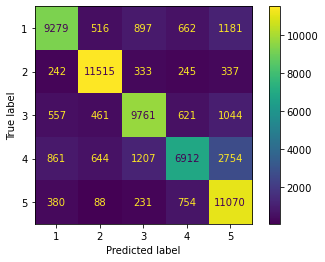

Accuracy: 0.7759464125847295
Classification report: 
               precision    recall  f1-score   support

           1       0.82      0.74      0.78     12535
           2       0.87      0.91      0.89     12672
           3       0.79      0.78      0.78     12444
           4       0.75      0.56      0.64     12378
           5       0.68      0.88      0.77     12523

    accuracy                           0.78     62552
   macro avg       0.78      0.78      0.77     62552
weighted avg       0.78      0.78      0.77     62552



In [55]:
#print(pd.crosstab(y_test, prediction, rownames=['Actual Calification'], colnames=['Predicted Calification']))
plot_confusion_matrix(classifier, X_test, y_test)
plt.show()
print("Accuracy:",metrics.accuracy_score(y_test, prediction))
print("Classification report: \n",classification_report(y_test, prediction))
#print("Other CM: ", confusion_matrix(y_test, prediction))
#print("CV Score: ", score.mean())

#### Differences between RandomOverSampler(), SMOTE(), ADASYN() respectively.

RandomOverSampler()


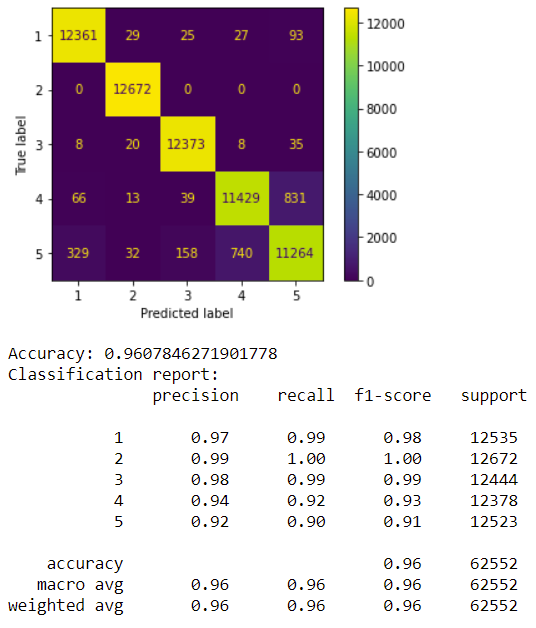

In [56]:
print("RandomOverSampler()")
Image(filename = "RandomOverSampler.png", width = 400, height = 200)


SMOTE()


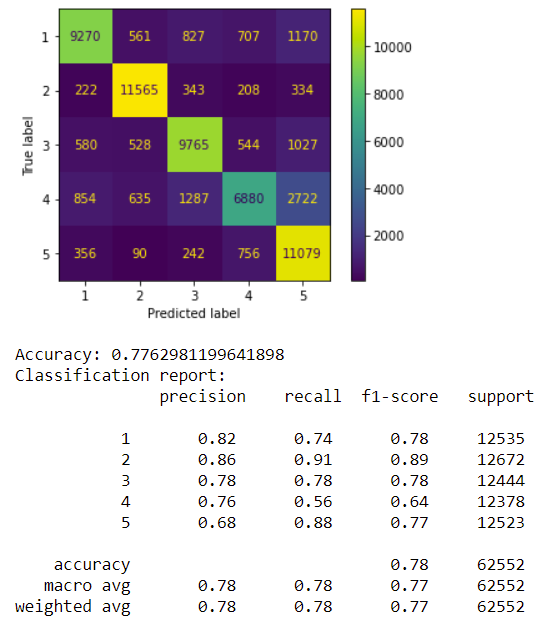

In [57]:
print("SMOTE()")
Image(filename = "SMOTE.png", width = 400, height = 200)

ADASYN()


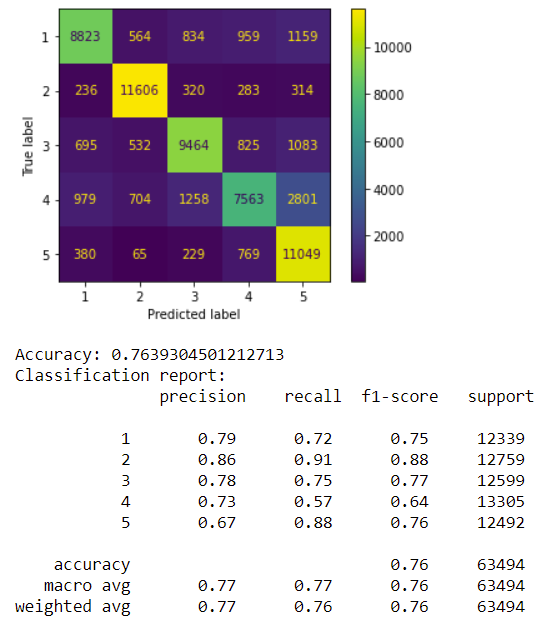

In [58]:
print("ADASYN()")
Image(filename = "ADASYN.png", width = 400, height = 200)

# Overall category rating average

In [59]:
country2=olist_sellers_mg.groupby(['product_category_name'])['review_score'].mean().sort_values(ascending=False)
country2

product_category_name
fashion_roupa_infanto_juvenil                    5.000000
cds_dvds_musicais                                4.642857
livros_importados                                4.508772
livros_interesse_geral                           4.503731
portateis_casa_forno_e_cafe                      4.438356
                                                   ...   
moveis_escritorio                                3.508343
portateis_cozinha_e_preparadores_de_alimentos    3.428571
fraldas_higiene                                  3.378378
casa_conforto_2                                  3.366667
seguros_e_servicos                               2.500000
Name: review_score, Length: 73, dtype: float64

<AxesSubplot:xlabel='product_category_name'>

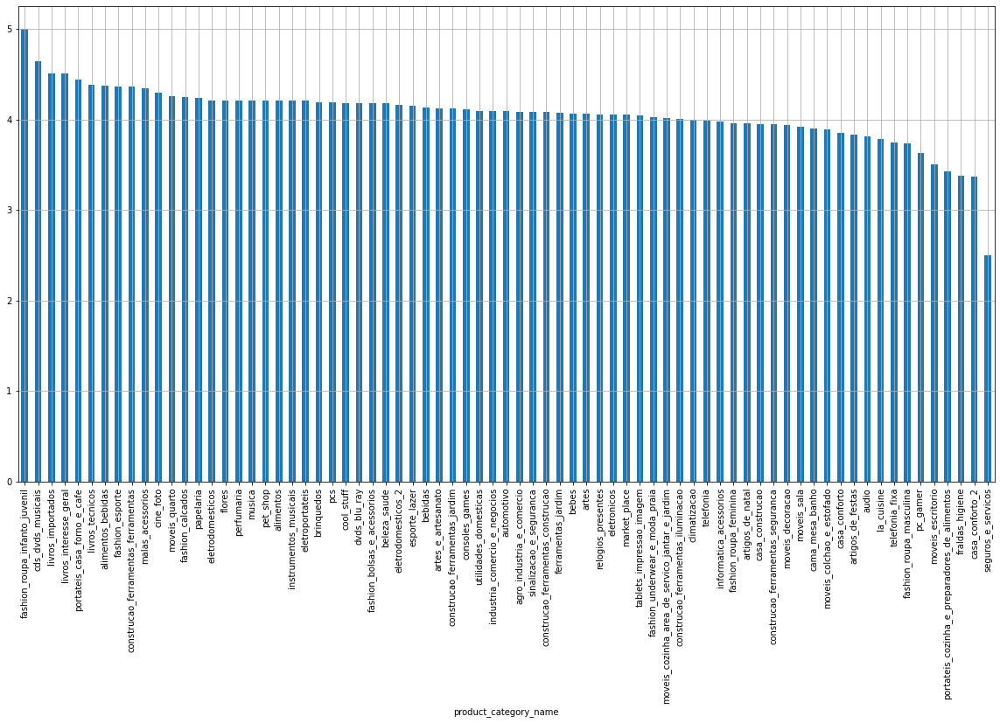

In [60]:
country2.plot(kind='bar',figsize=(20,10), grid=True)

# Average delivery time in days for a global product category

In [61]:
country_delivery=olist_sellers_mg.groupby(['product_category_name'])["diff_purchase_deliver_customer"].mean().sort_values(ascending=False)
country_delivery

product_category_name
fraldas_higiene                  13.918919
casa_conforto_2                  13.800000
pc_gamer                         13.375000
pcs                              13.095477
moveis_sala                      12.677355
                                   ...    
cine_foto                         8.802817
alimentos                         8.785571
livros_importados                 8.403509
artes_e_artesanato                7.833333
fashion_roupa_infanto_juvenil     4.571429
Name: diff_purchase_deliver_customer, Length: 73, dtype: float64

<AxesSubplot:xlabel='product_category_name'>

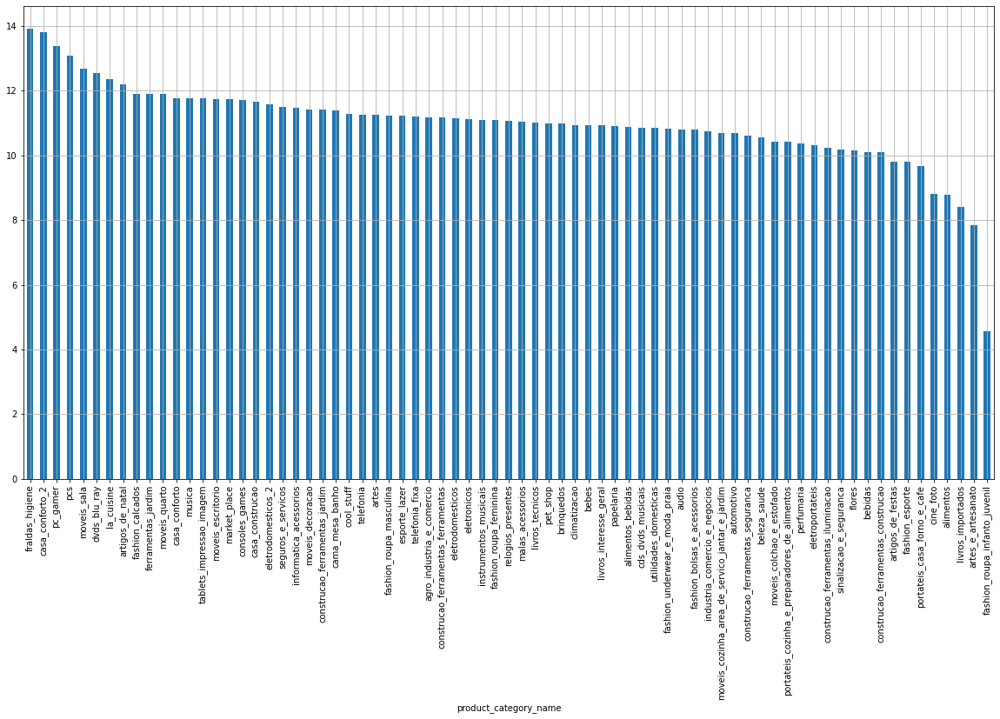

In [62]:
country_delivery.plot(kind='bar',figsize=(20,10), grid=True)

# Number of products sold by global category

In [63]:
country_quant=olist_sellers_mg.groupby(["product_category_name"])['product_category_name'].count().sort_values(ascending=False)
country_quant

product_category_name
cama_mesa_banho                                  11108
beleza_saude                                      9522
esporte_lazer                                     8488
moveis_decoracao                                  8236
informatica_acessorios                            7708
                                                 ...  
portateis_cozinha_e_preparadores_de_alimentos       14
la_cuisine                                          14
pc_gamer                                             8
fashion_roupa_infanto_juvenil                        7
seguros_e_servicos                                   2
Name: product_category_name, Length: 73, dtype: int64

<AxesSubplot:xlabel='product_category_name'>

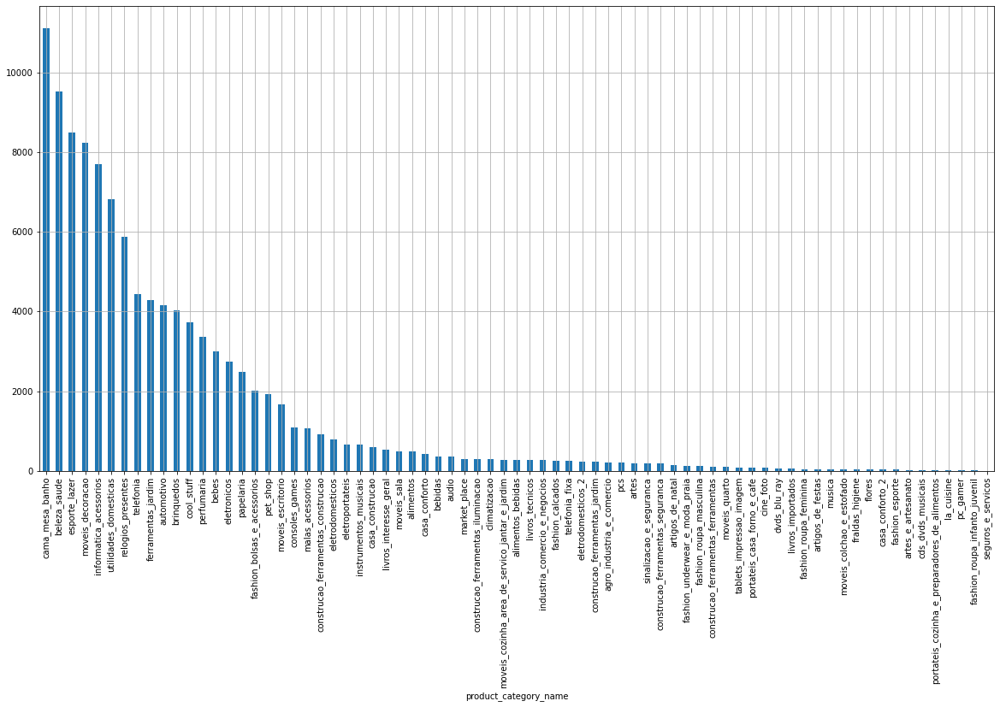

In [64]:
country_quant.plot(kind='bar',figsize=(20,10), grid=True)

# Average rating of a category by state (Grouped by category)

In [65]:
country=olist_sellers_mg.groupby(['product_category_name','customer_state'])['review_score'].mean().sort_values(ascending=False)
country

product_category_name      customer_state
market_place               PB                5.0
dvds_blu_ray               PI                5.0
consoles_games             AC                5.0
eletrodomesticos           SE                5.0
bebidas                    CE                5.0
                                            ... 
telefonia_fixa             SE                1.0
fashion_calcados           RN                1.0
                           PI                1.0
pc_gamer                   MG                1.0
agro_industria_e_comercio  AL                1.0
Name: review_score, Length: 1362, dtype: float64

<AxesSubplot:xlabel='product_category_name'>

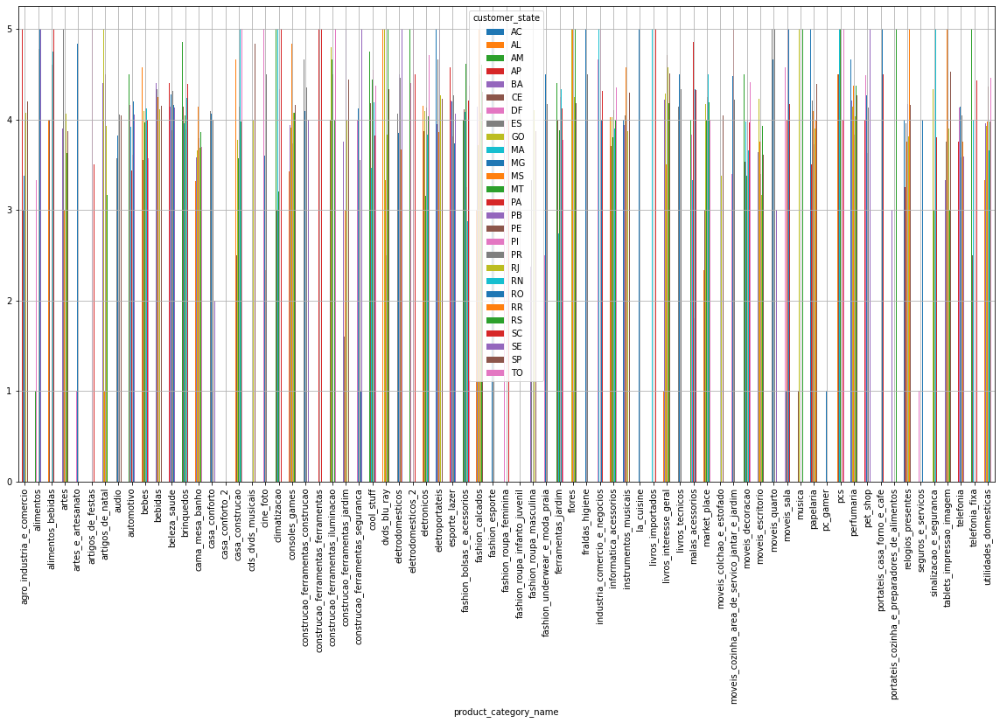

In [66]:
country.unstack().plot(kind='bar',figsize=(20,10), grid=True)

D:\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:337: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


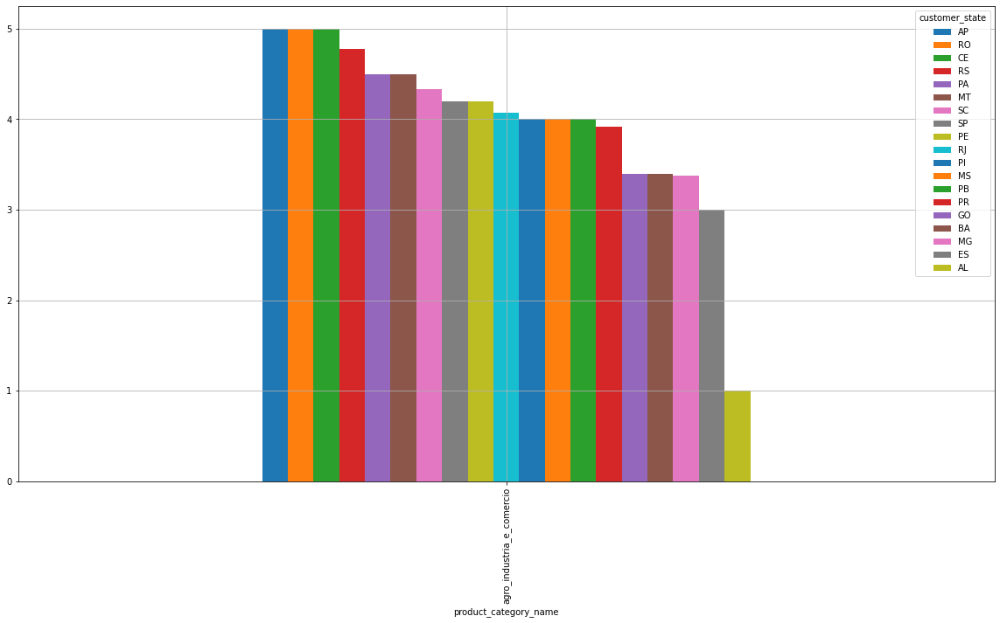

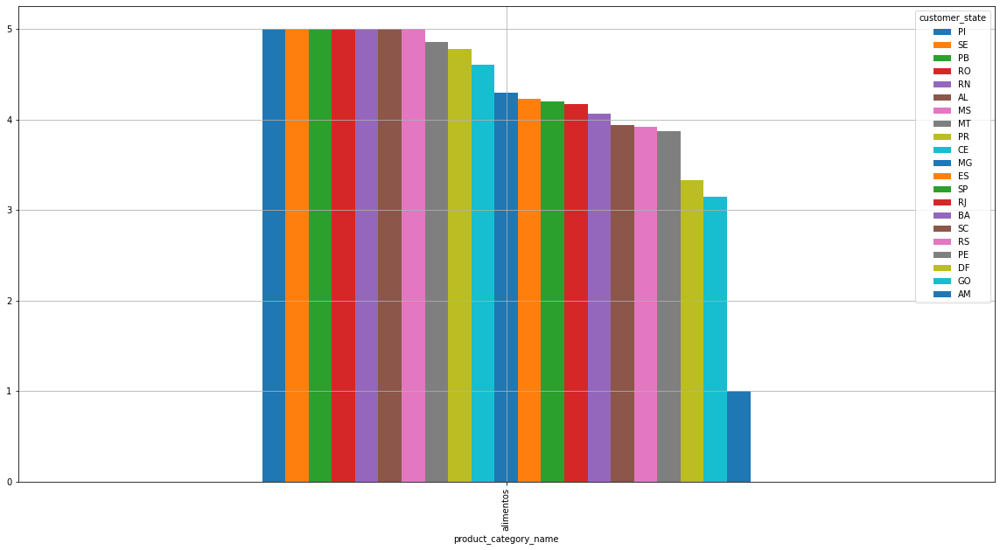

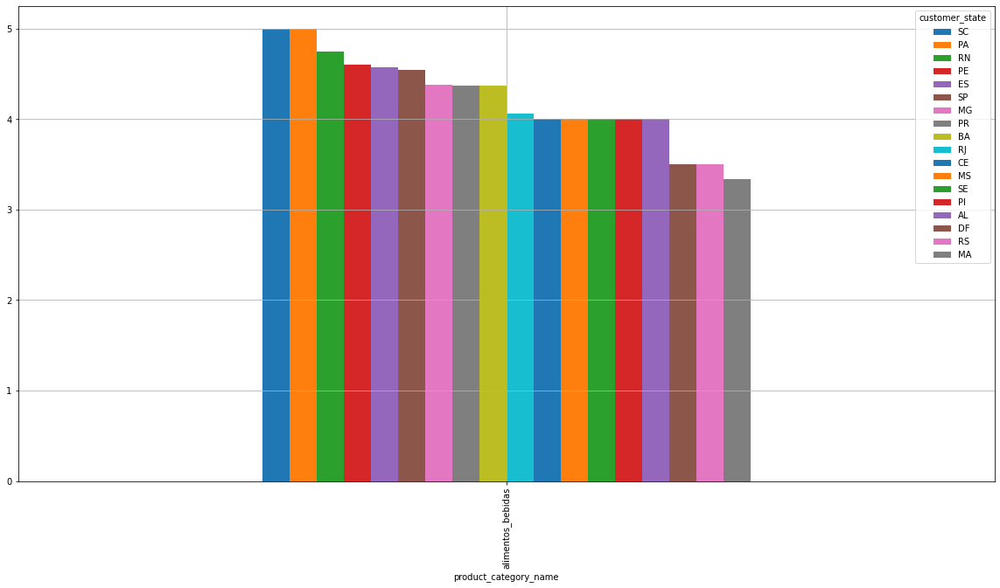

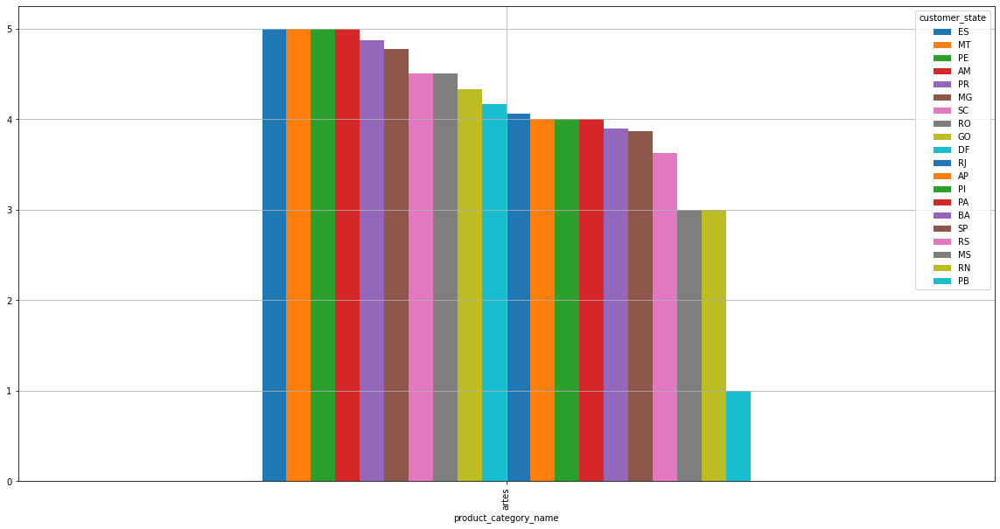

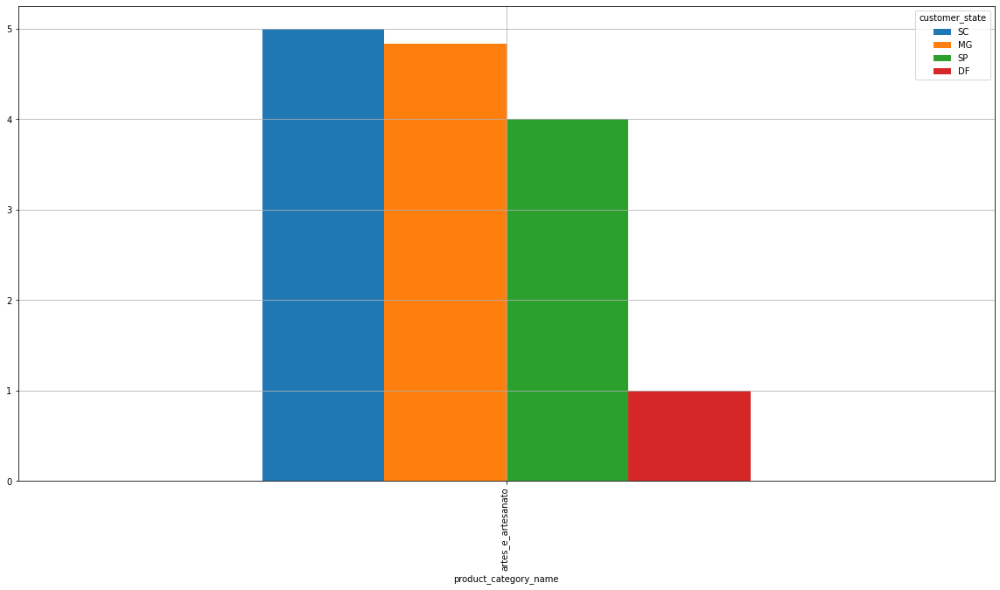

...

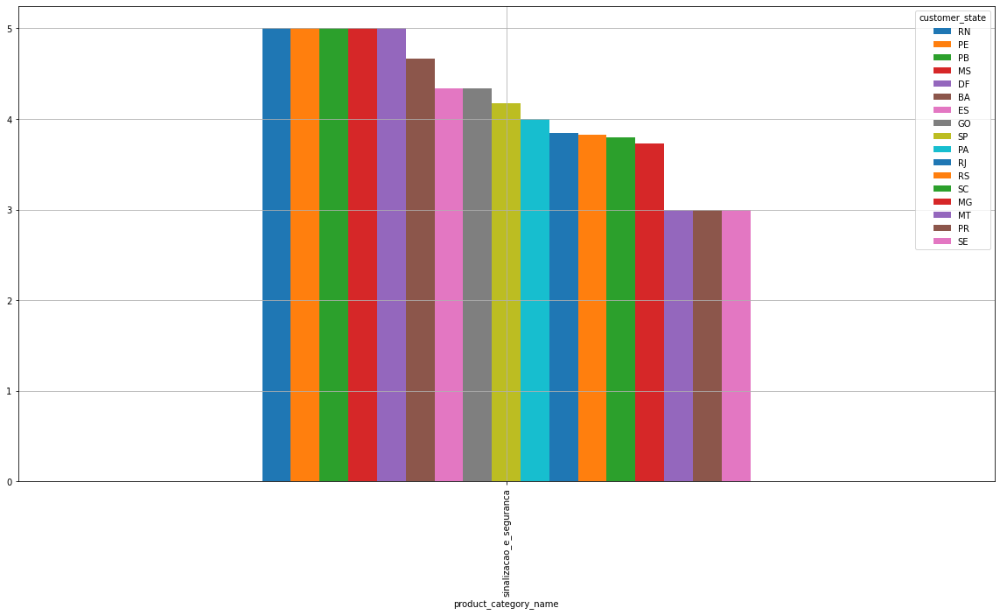

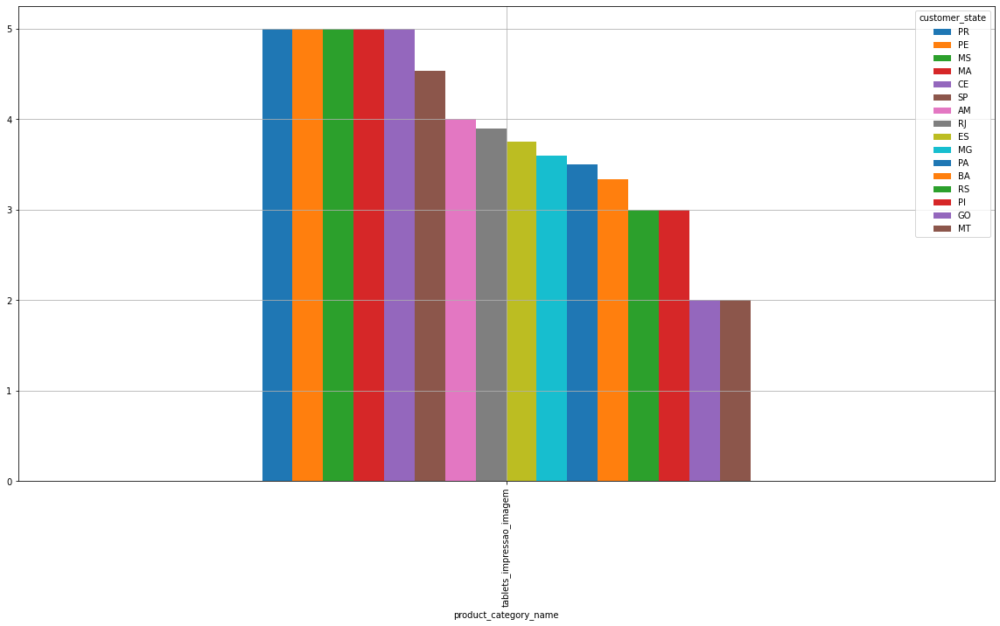

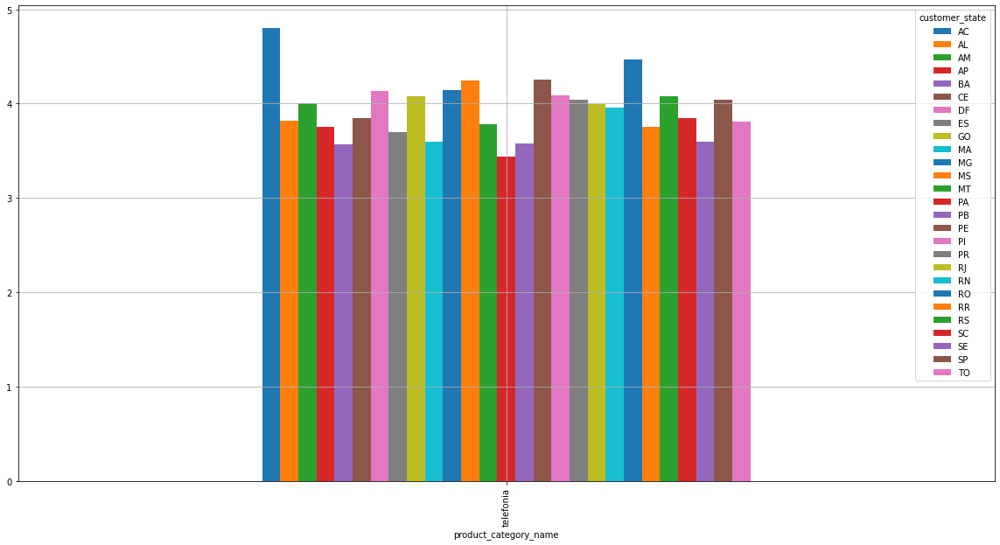

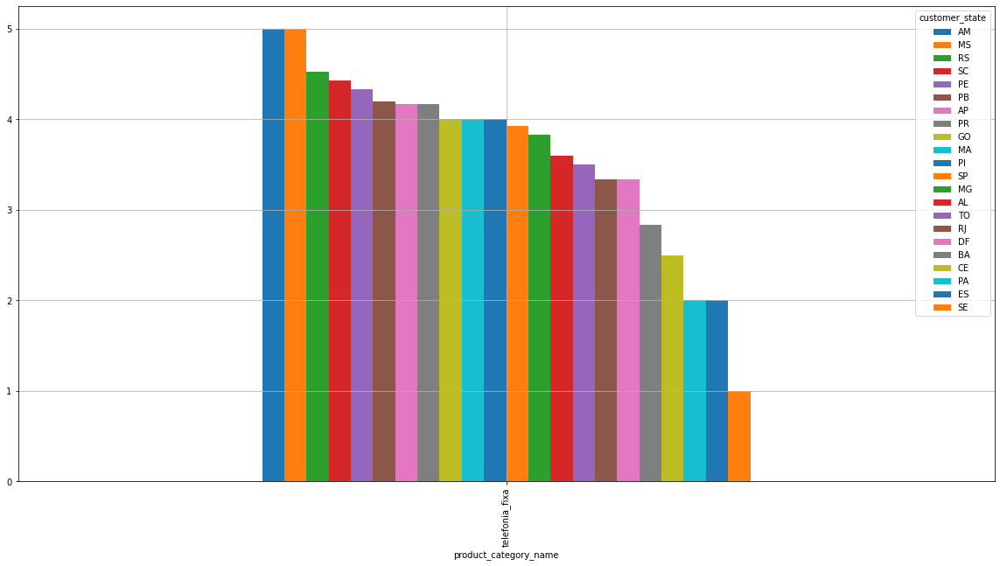

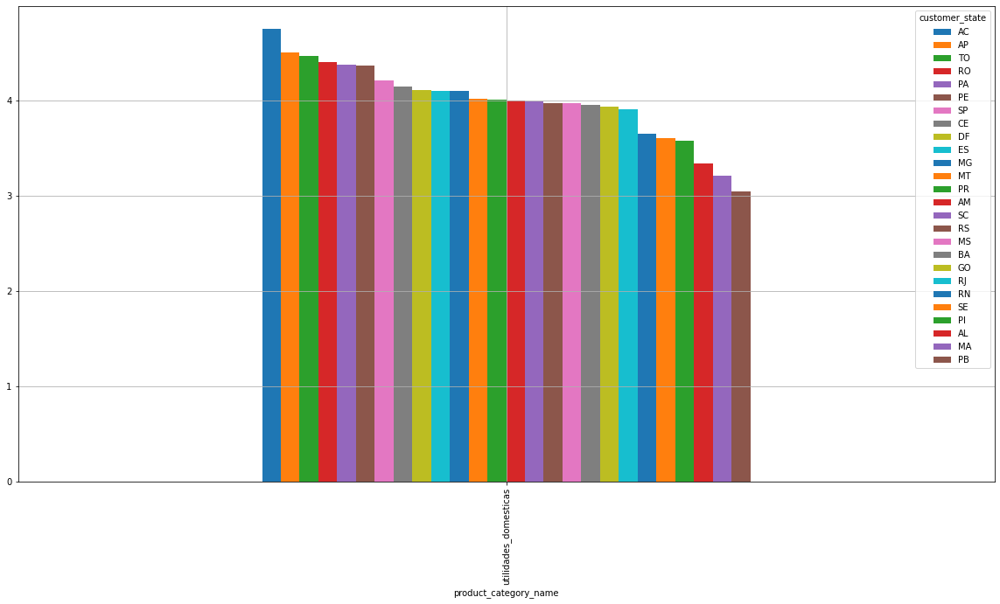

In [67]:
for title, group in country.groupby('product_category_name'):
    group.unstack().plot(kind='bar',figsize=(20,10), grid=True)

# Average Category Rating by Buyer Status (Grouped by Buyer Status)

In [68]:
df3=olist_sellers_mg.groupby(["customer_state", "product_category_name"])["review_score"].mean().sort_values(ascending=False)
df3

customer_state  product_category_name             
MT              artigos_de_natal                      5.0
                pcs                                   5.0
PA              construcao_ferramentas_ferramentas    5.0
MA              tablets_impressao_imagem              5.0
PR              fashion_esporte                       5.0
                                                     ... 
PA              artigos_de_natal                      1.0
                construcao_ferramentas_jardim         1.0
DF              seguros_e_servicos                    1.0
MS              artigos_de_natal                      1.0
RO              construcao_ferramentas_seguranca      1.0
Name: review_score, Length: 1362, dtype: float64

<AxesSubplot:xlabel='customer_state'>

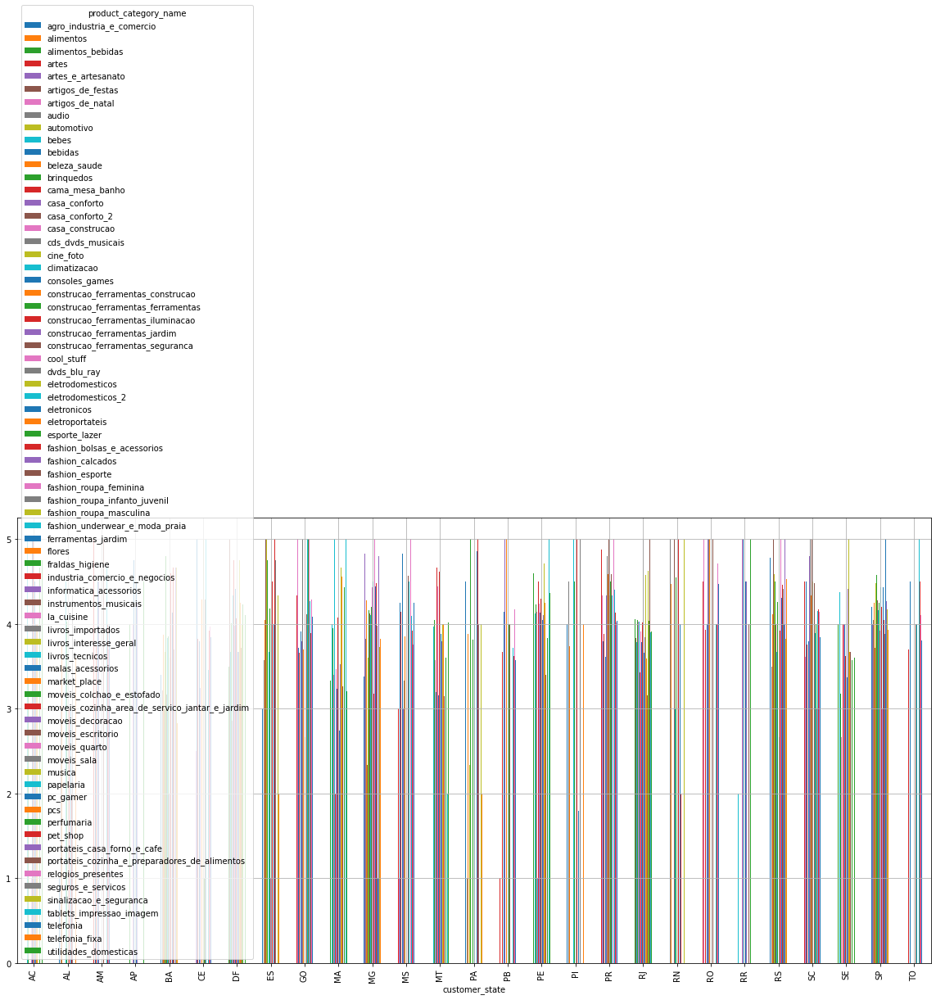

In [69]:
df3.unstack().plot(kind='bar',figsize=(20,10), grid=True)

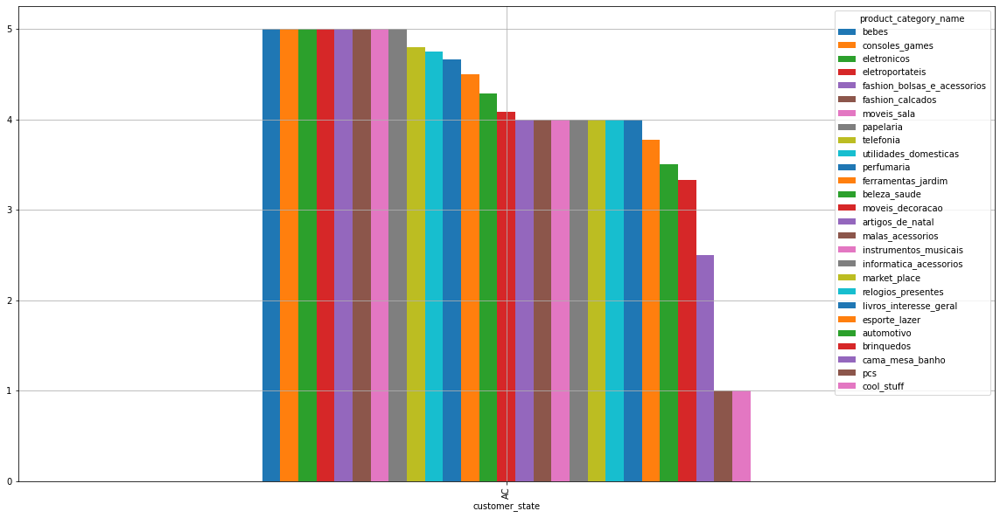

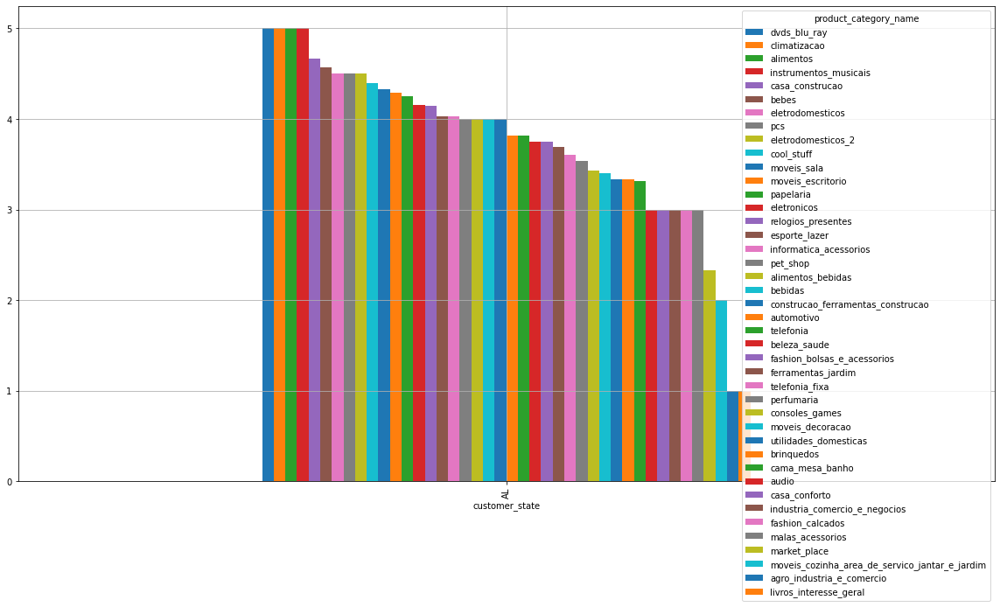

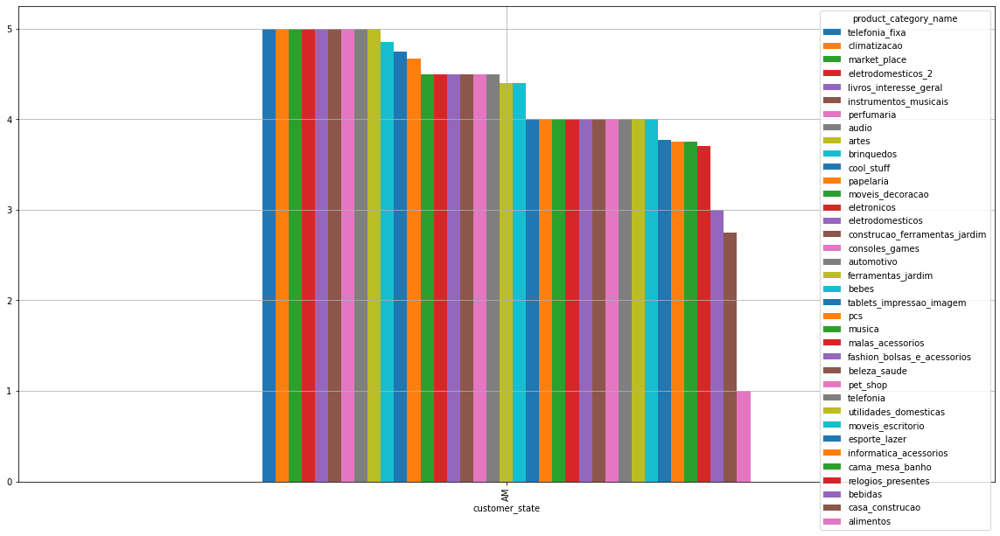

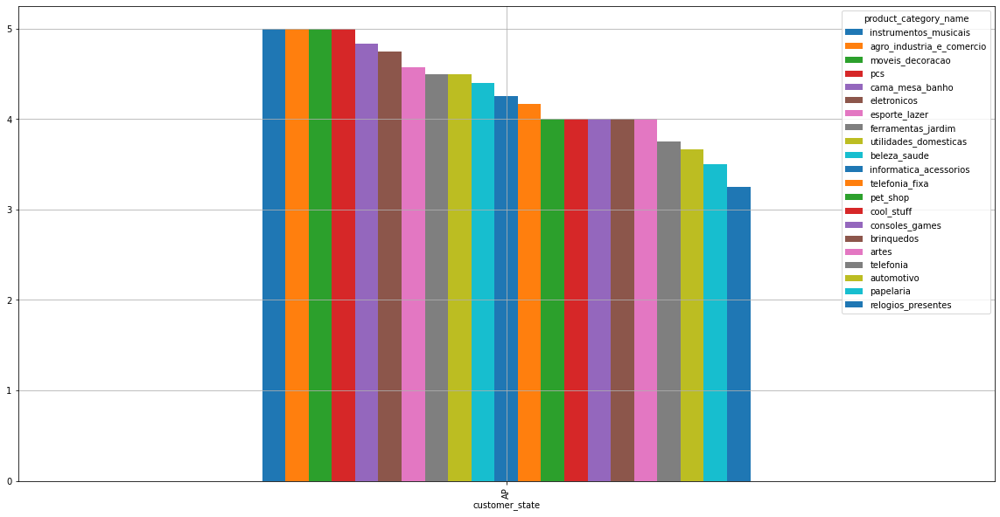

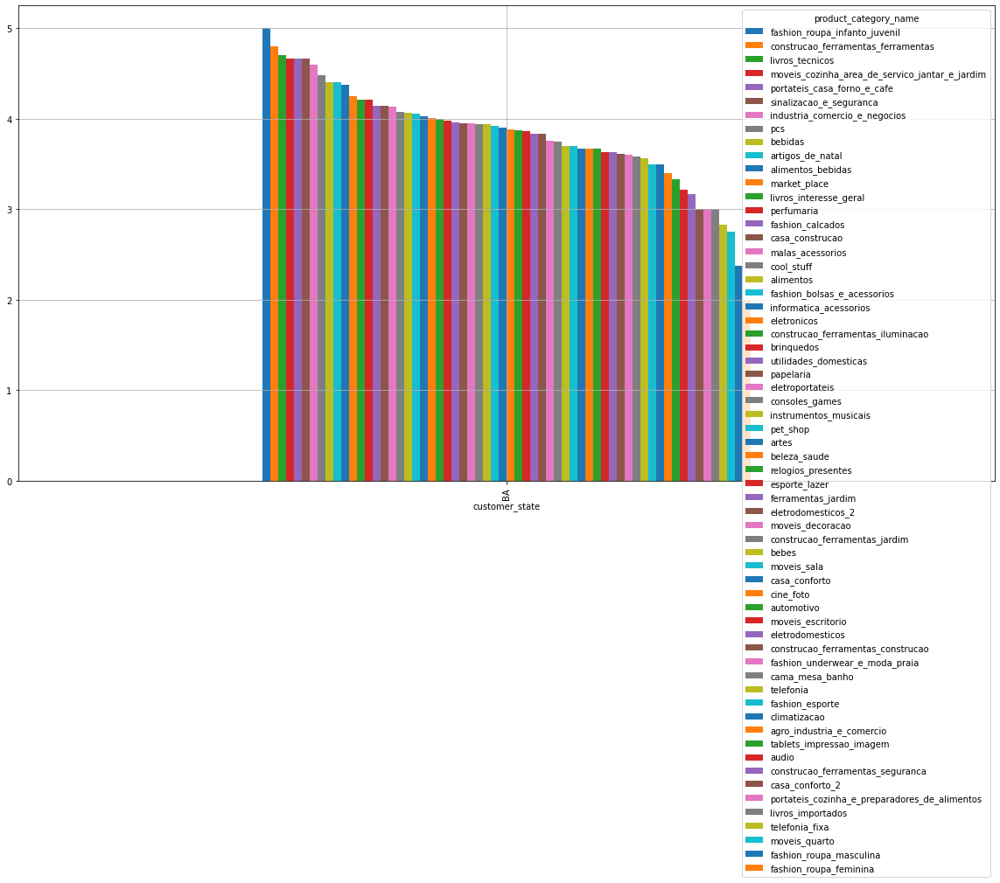

...

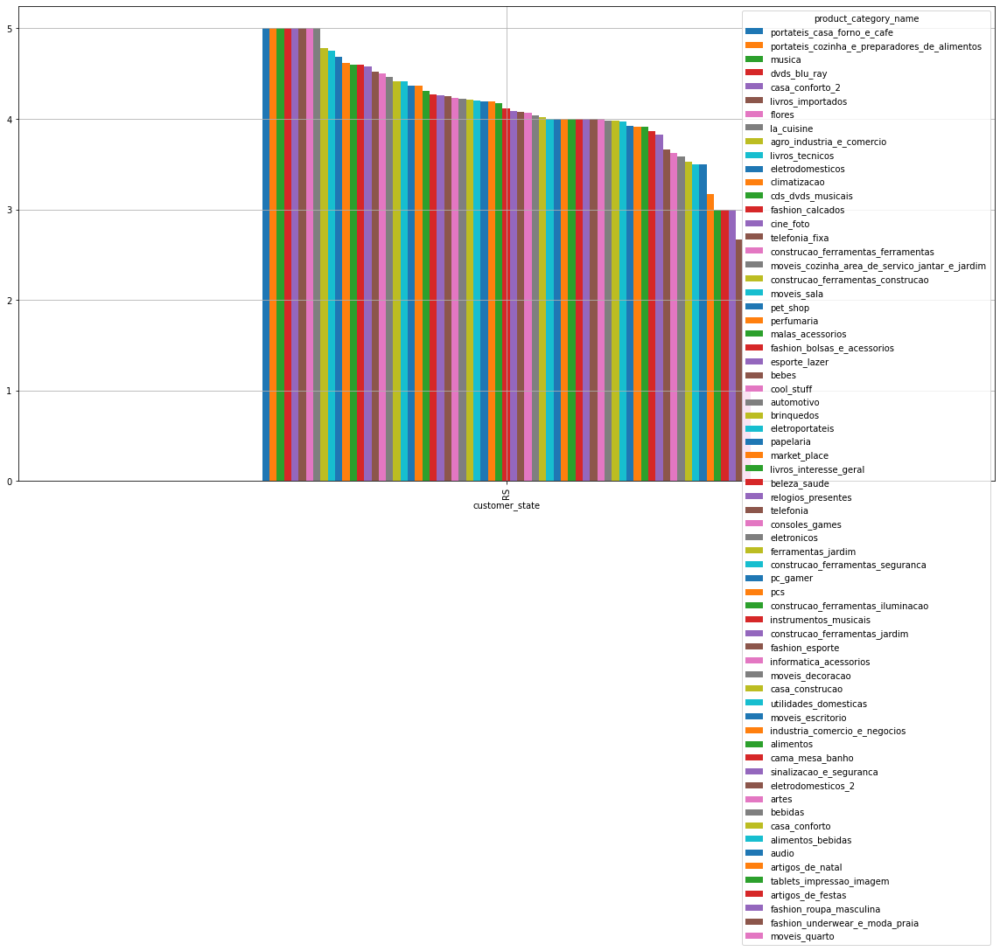

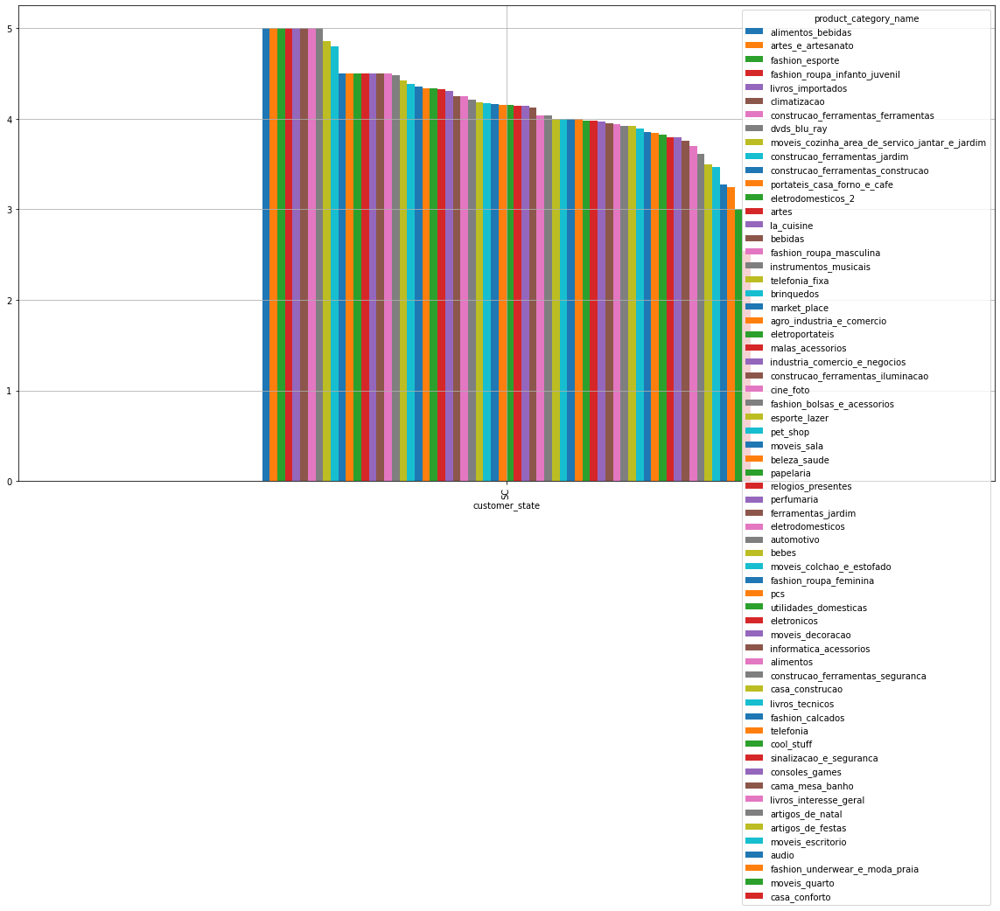

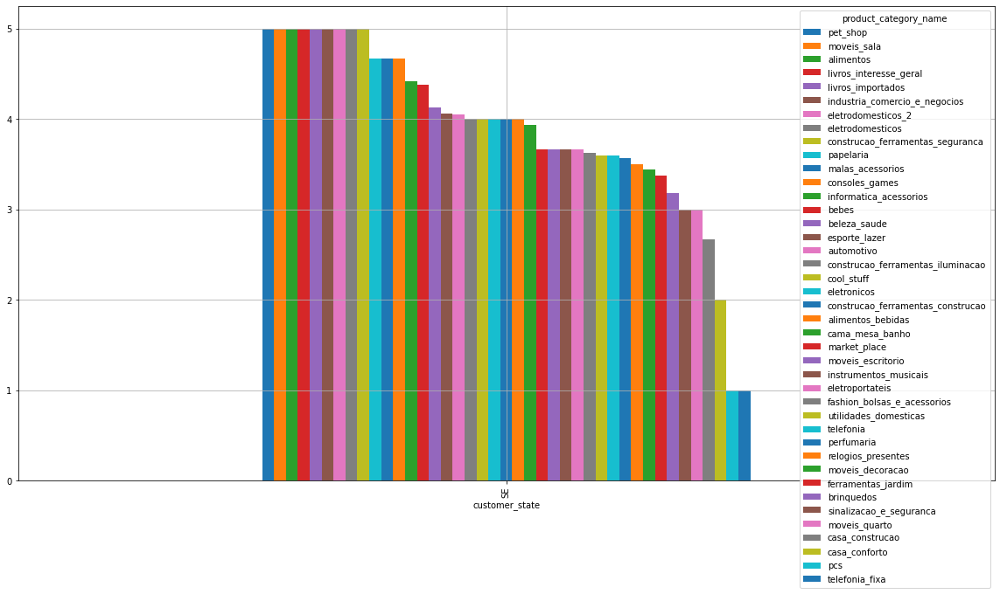

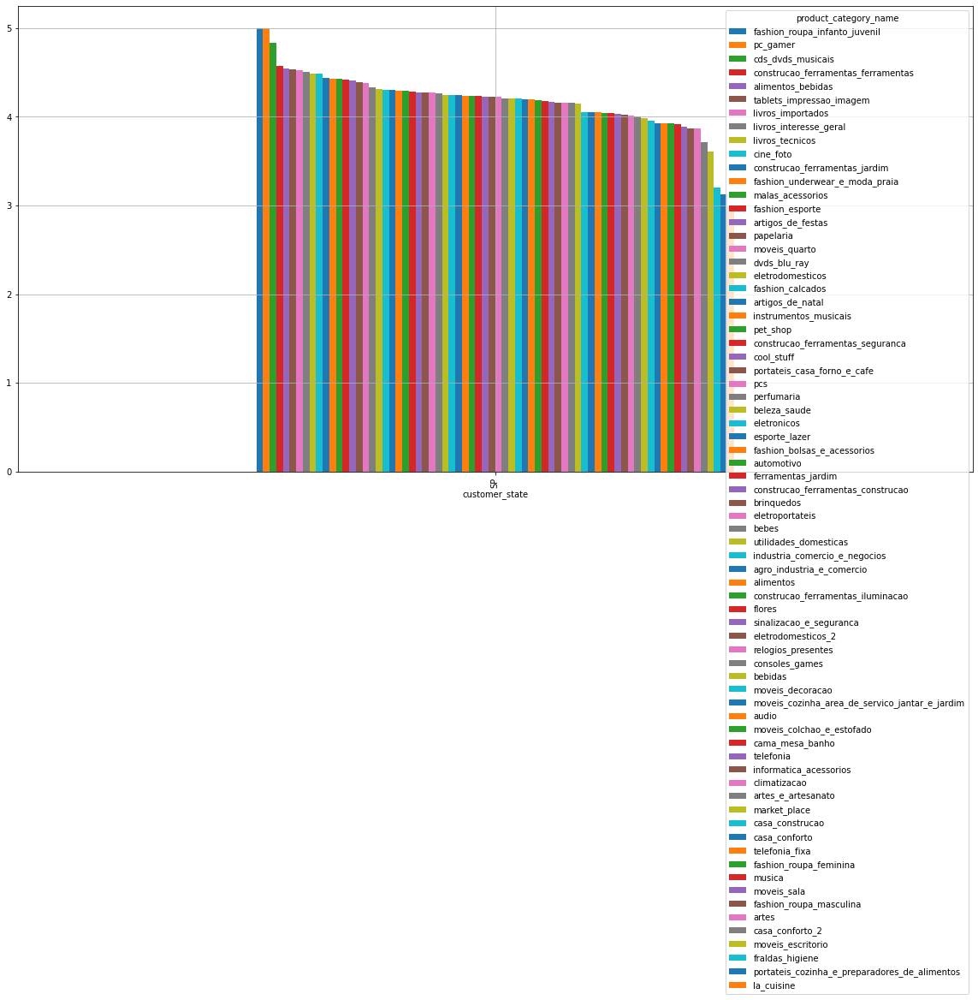

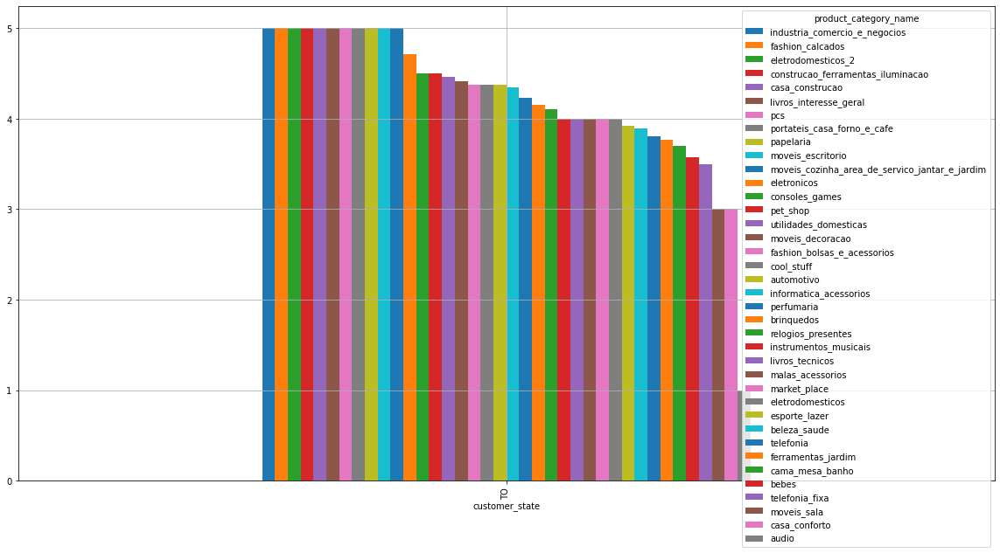

In [70]:
for title, group in df3.groupby('customer_state'):
    group.unstack().plot(kind='bar',figsize=(20,10), grid=True)

# Average Category Rating by Vendor Status (Grouped by Vendor Status)

In [71]:
df4=olist_sellers_mg.groupby(["seller_state","product_category_name"])["review_score"].mean().sort_values(ascending=False)
df4

seller_state  product_category_name                         
PE            casa_conforto                                     5.0
DF            bebidas                                           5.0
RJ            moveis_cozinha_area_de_servico_jantar_e_jardim    5.0
              musica                                            5.0
DF            cine_foto                                         5.0
                                                               ... 
PR            pcs                                               1.0
GO            papelaria                                         1.0
BA            ferramentas_jardim                                1.0
PR            dvds_blu_ray                                      1.0
MG            tablets_impressao_imagem                          1.0
Name: review_score, Length: 495, dtype: float64

<AxesSubplot:xlabel='seller_state'>

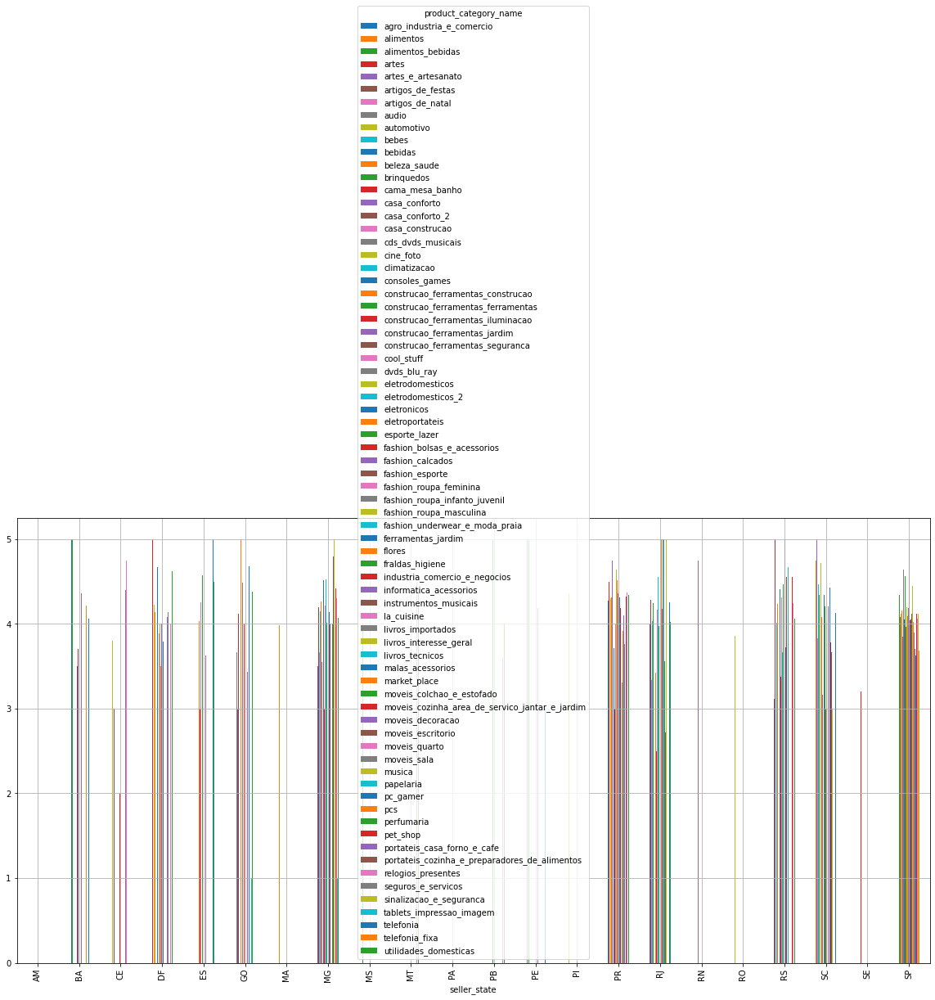

In [72]:
df4.unstack().plot(kind='bar',figsize=(20,10), grid=True)

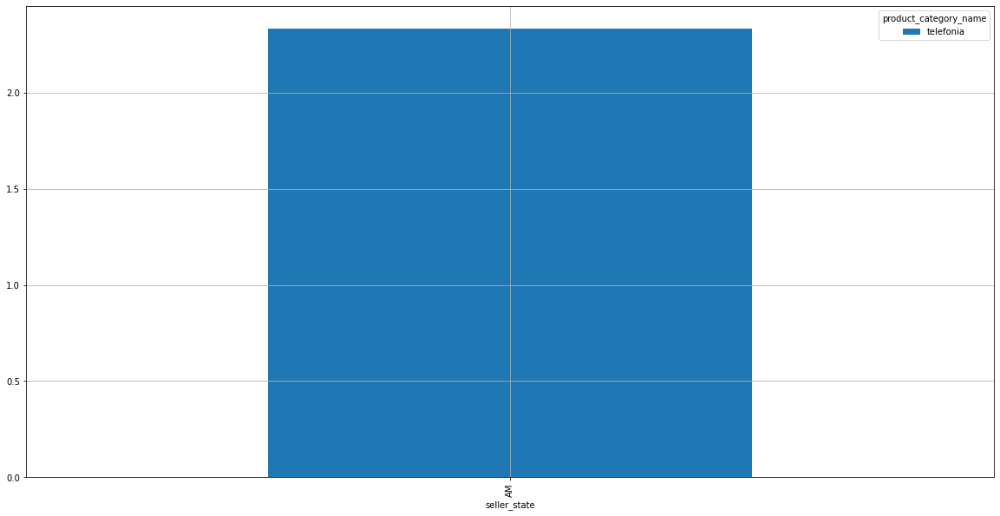

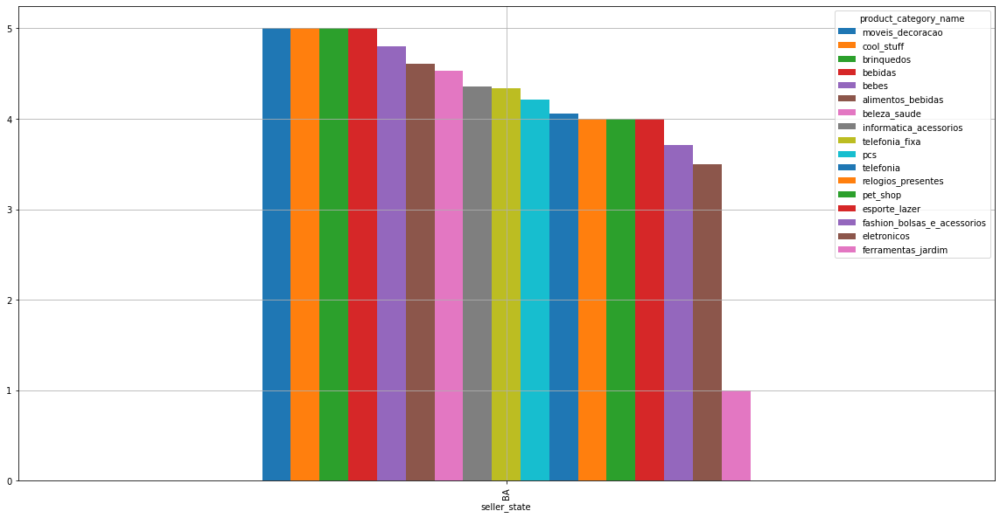

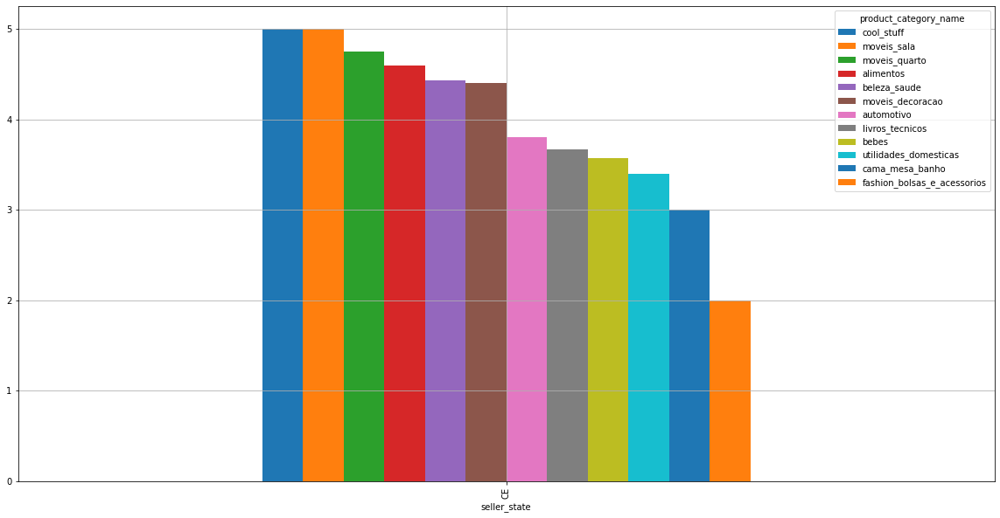

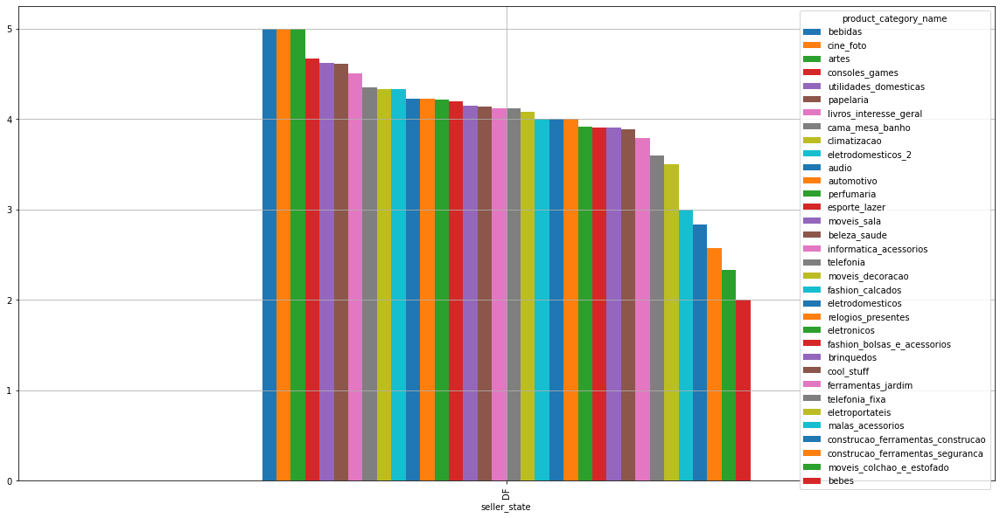

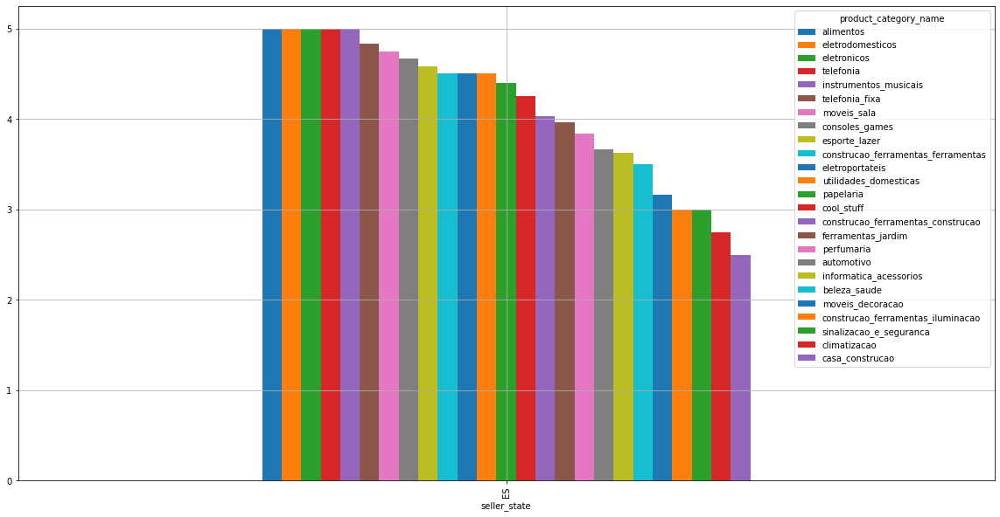

...

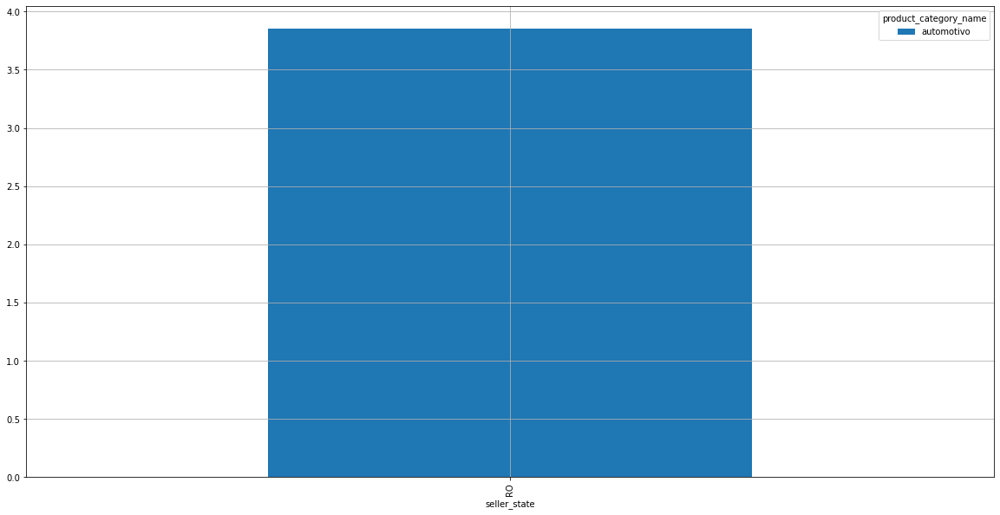

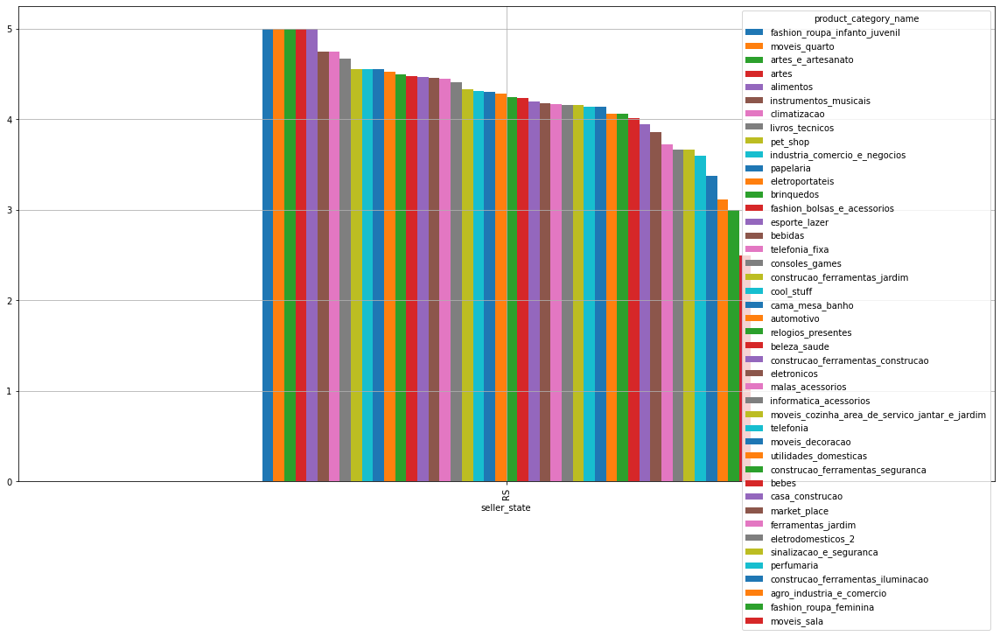

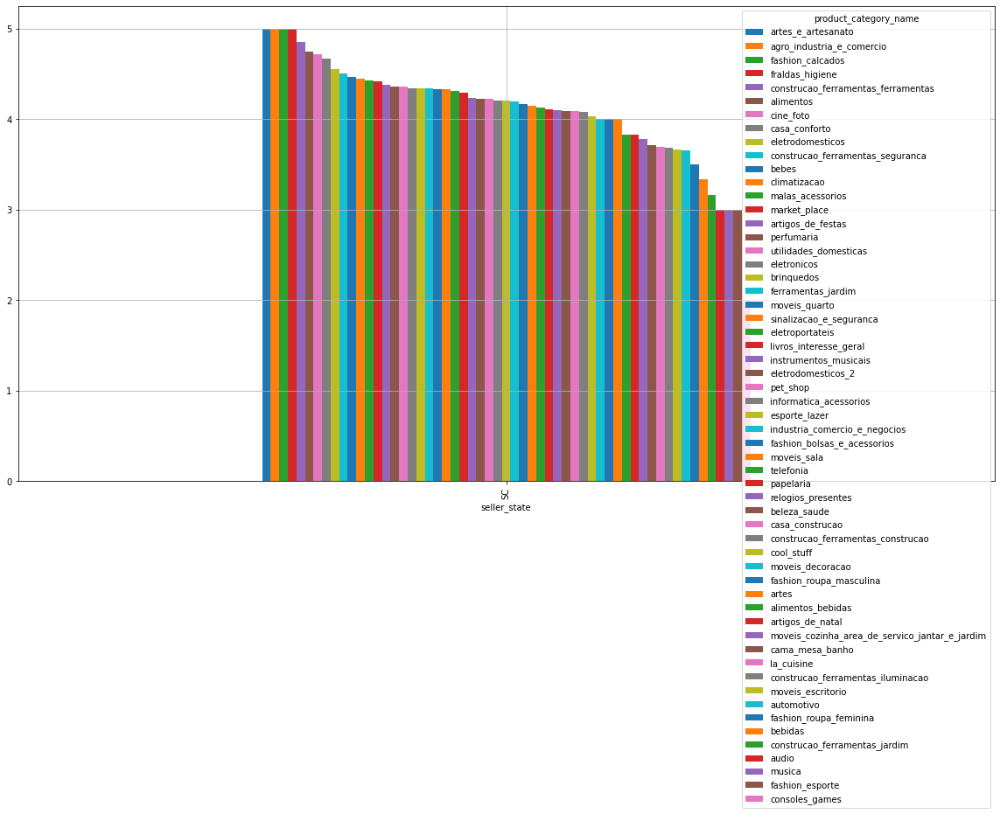

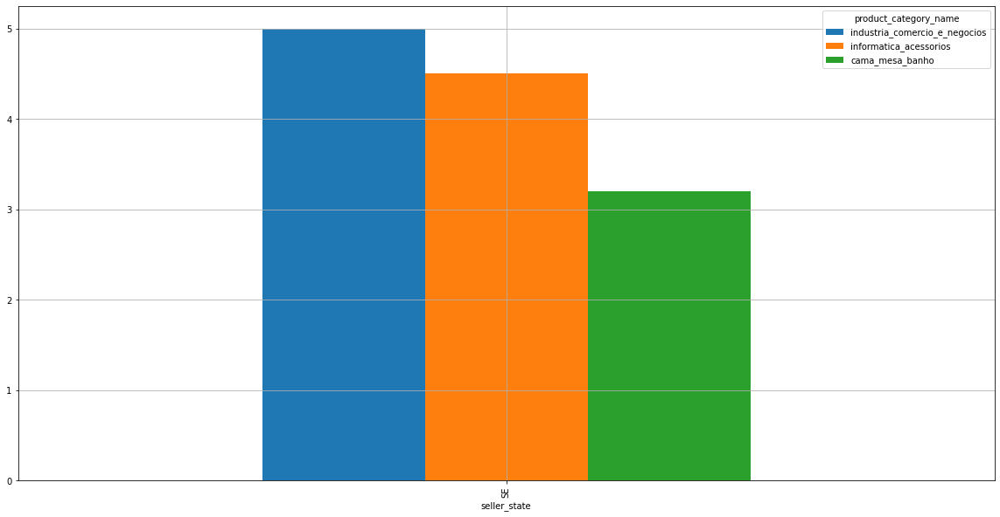

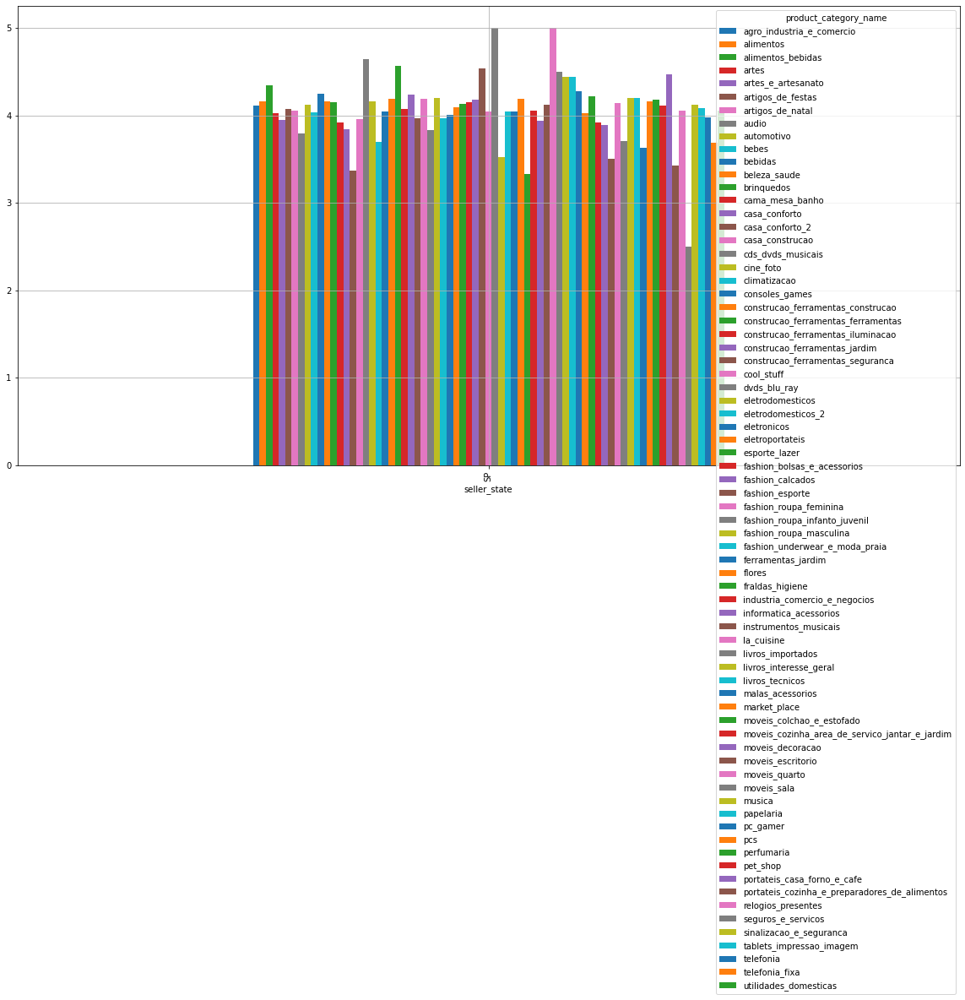

In [73]:
for title, group in df4.groupby('seller_state'):
    group.unstack().plot(kind='bar',figsize=(20,10), grid=True)

# Average seller rating by buyer status and seller status (Grouped by buyer status)

In [74]:
df5=olist_sellers_mg.groupby(["customer_state","seller_state"])["review_score"].mean().sort_values(ascending=False)
df5

customer_state  seller_state
RJ              PB              5.0
SC              RN              5.0
SE              PB              5.0
MS              CE              5.0
                MA              5.0
                               ... 
GO              PB              1.0
DF              PB              1.0
AM              CE              1.0
AL              AM              1.0
PA              PB              1.0
Name: review_score, Length: 410, dtype: float64

<AxesSubplot:xlabel='customer_state'>

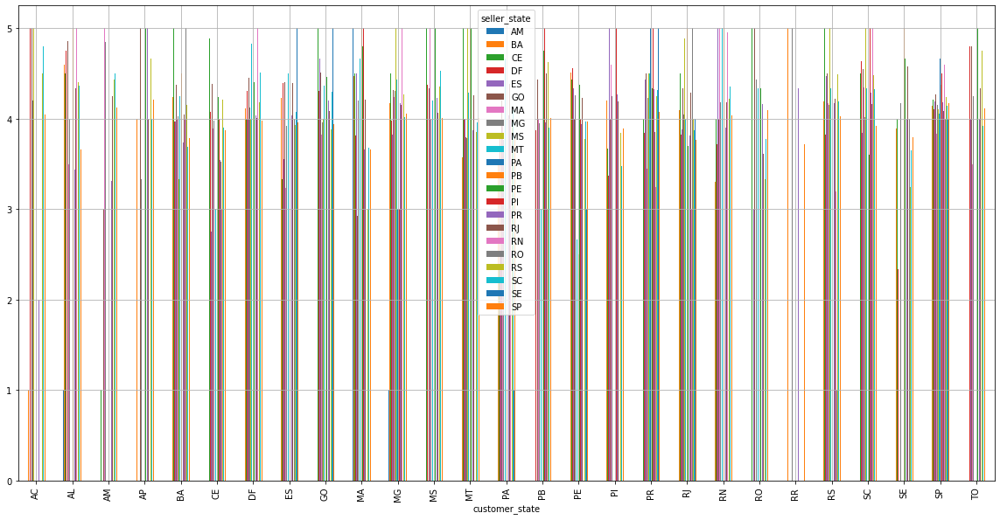

In [75]:
df5.unstack().plot(kind='bar',figsize=(20,10), grid=True)

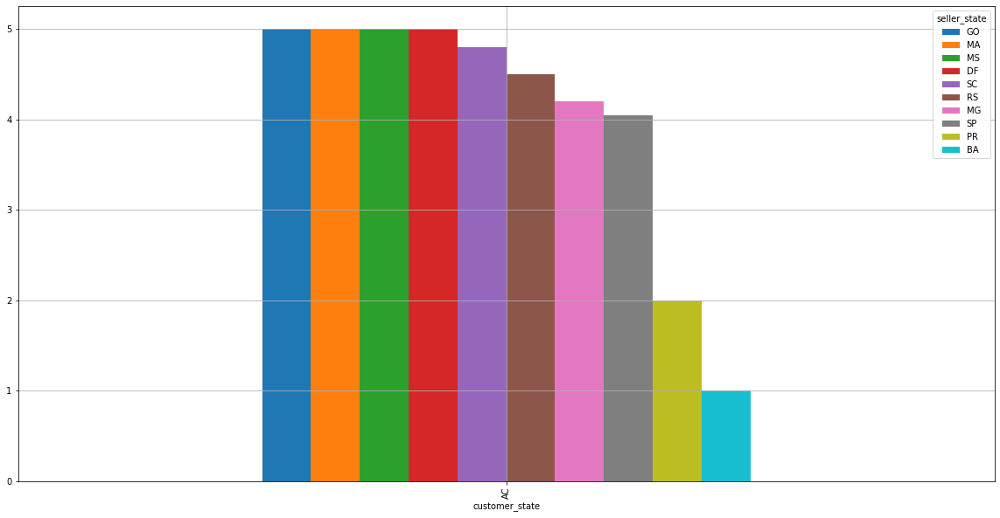

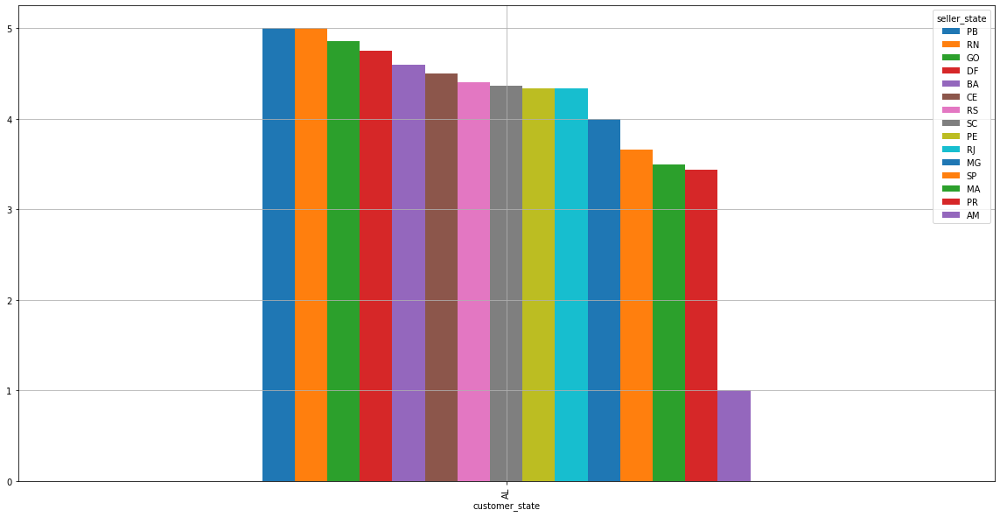

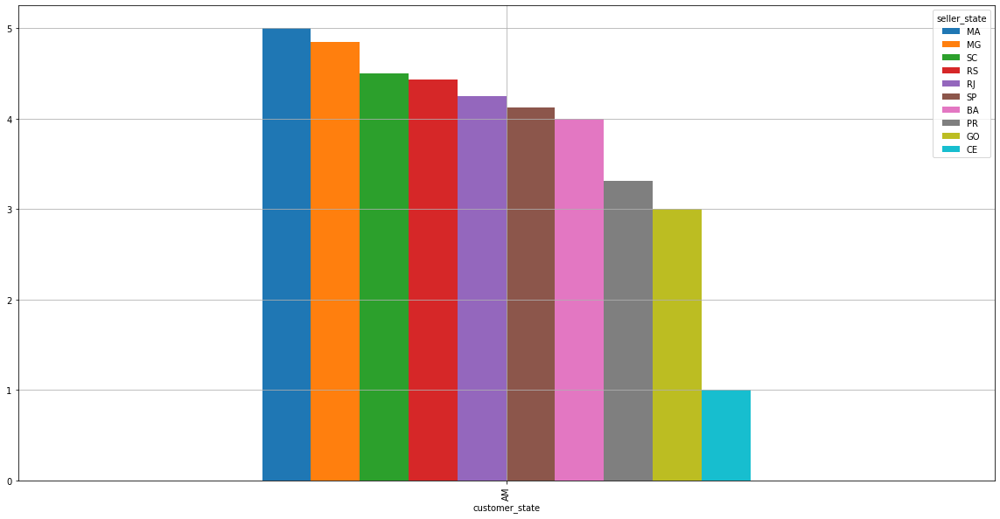

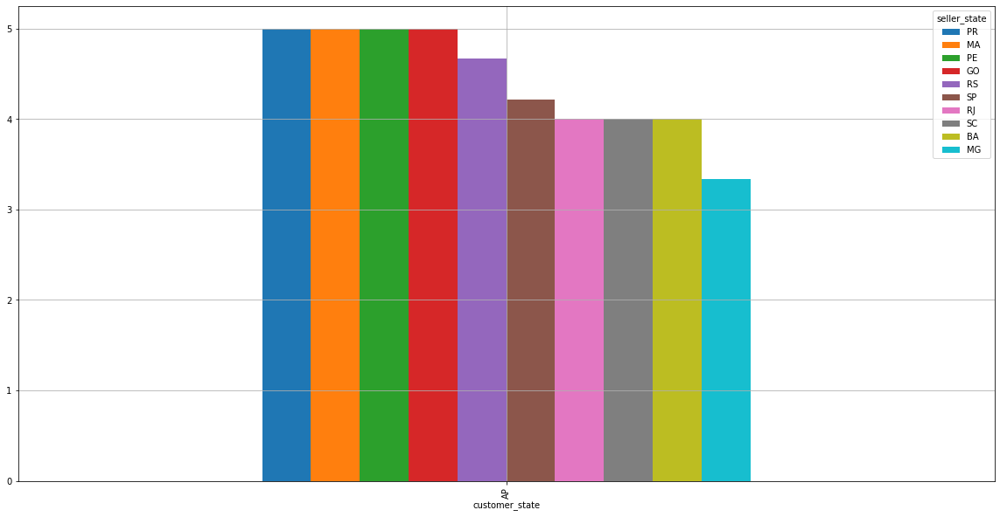

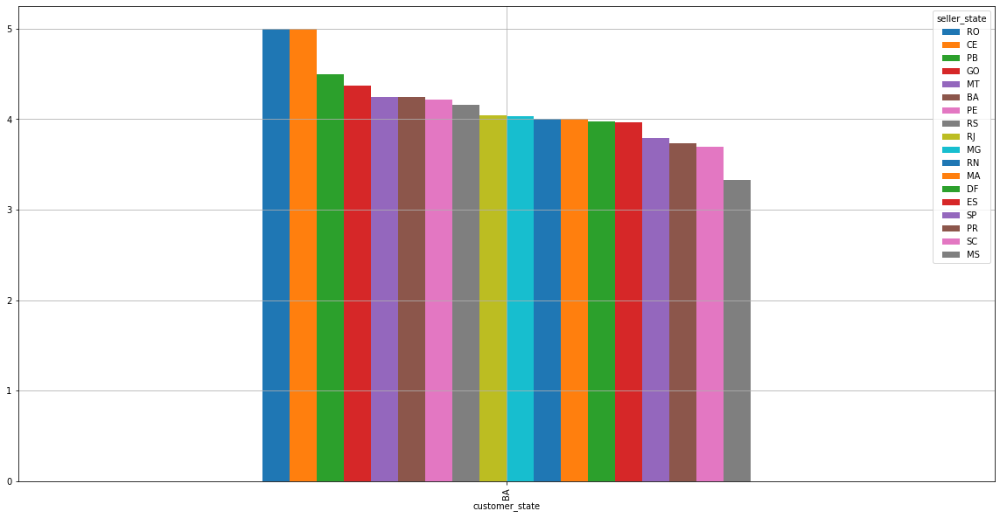

...

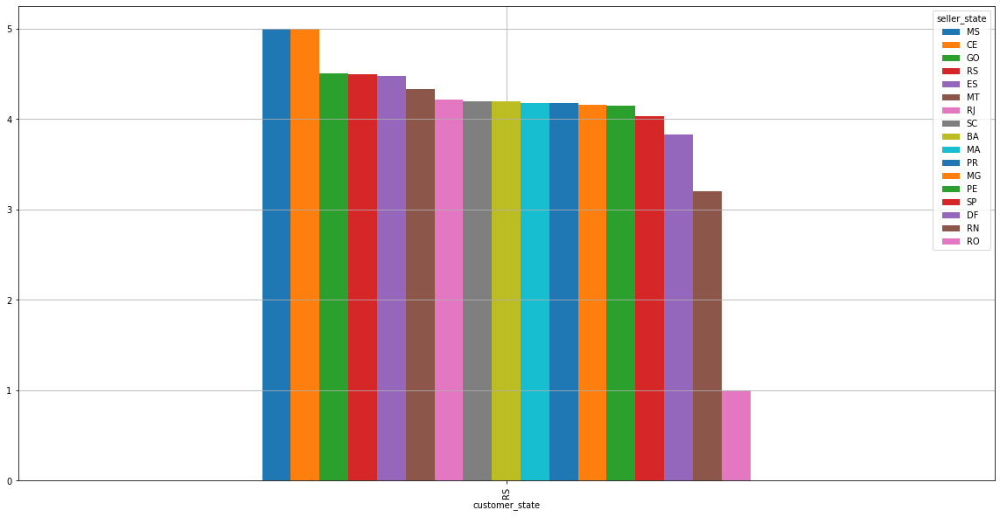

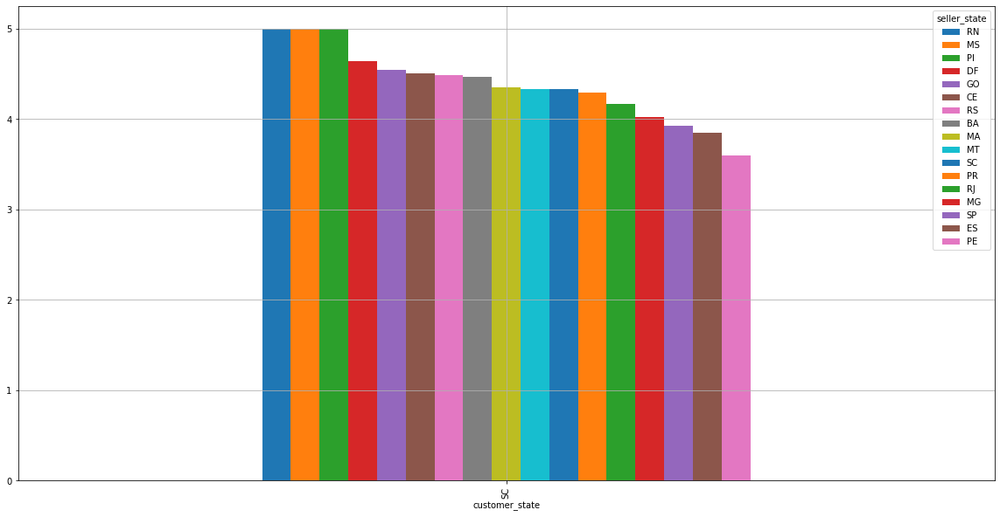

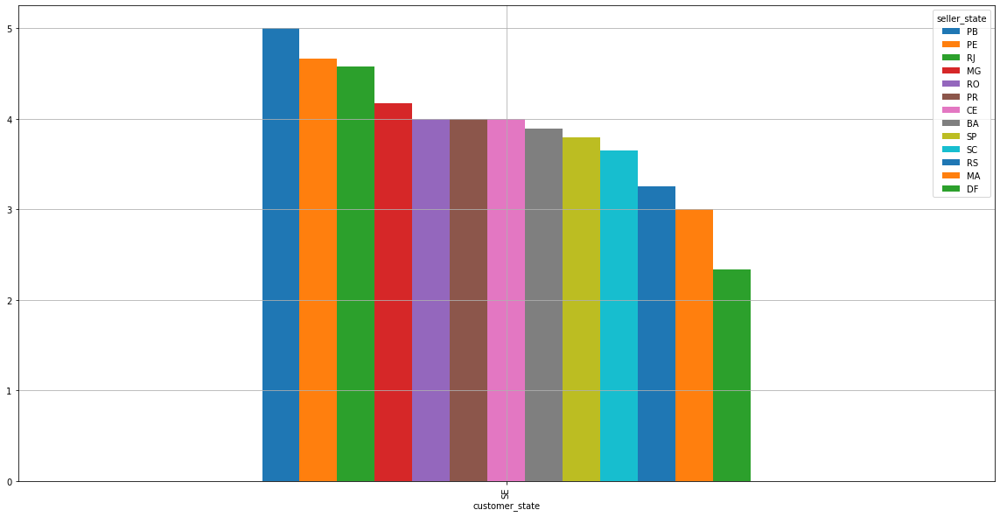

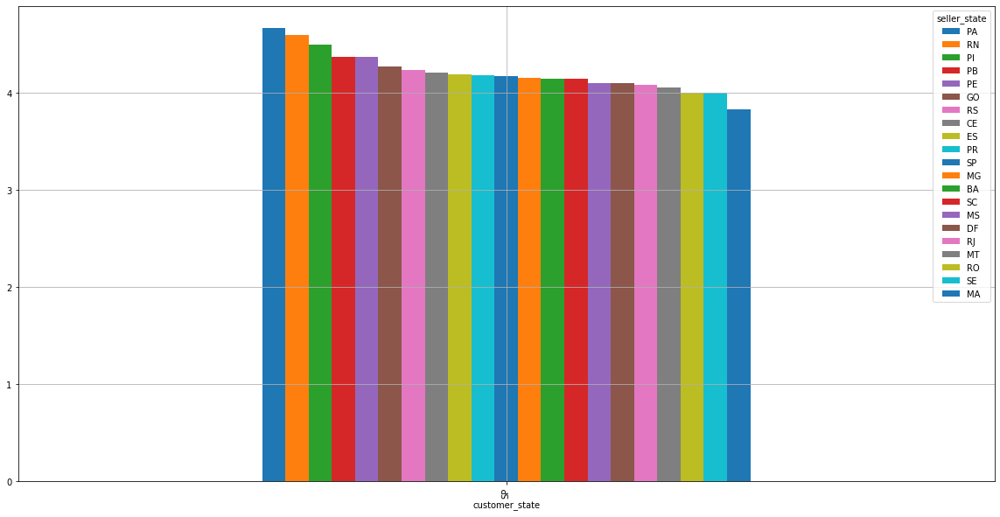

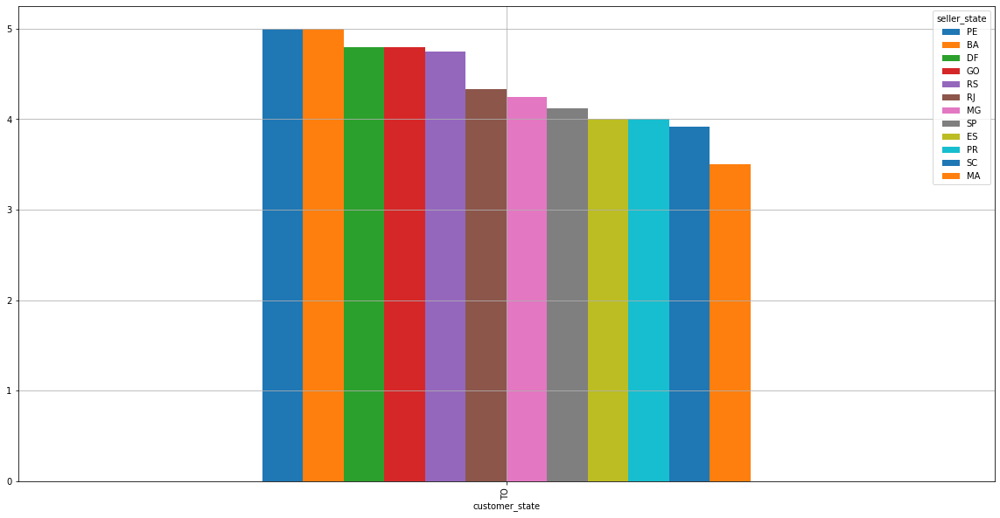

In [76]:
for title, group in df5.groupby('customer_state'):
    group.unstack().plot(kind='bar',figsize=(20,10), grid=True)

# Average category rating by buyer status and by seller status

In [77]:
df6=olist_sellers_mg.groupby(["customer_state","seller_state","product_category_name"])["review_score"].mean().sort_values(ascending=False)
df6

customer_state  seller_state  product_category_name           
PB              DF            brinquedos                          5.0
DF              SP            cine_foto                           5.0
SE              RJ            livros_interesse_geral              5.0
DF              SP            construcao_ferramentas_seguranca    5.0
RJ              ES            instrumentos_musicais               5.0
                                                                 ... 
CE              PR            eletronicos                         1.0
                              fashion_bolsas_e_acessorios         1.0
                              market_place                        1.0
PA              MG            artigos_de_natal                    1.0
AC              BA            pcs                                 1.0
Name: review_score, Length: 4549, dtype: float64

<AxesSubplot:xlabel='customer_state,seller_state'>

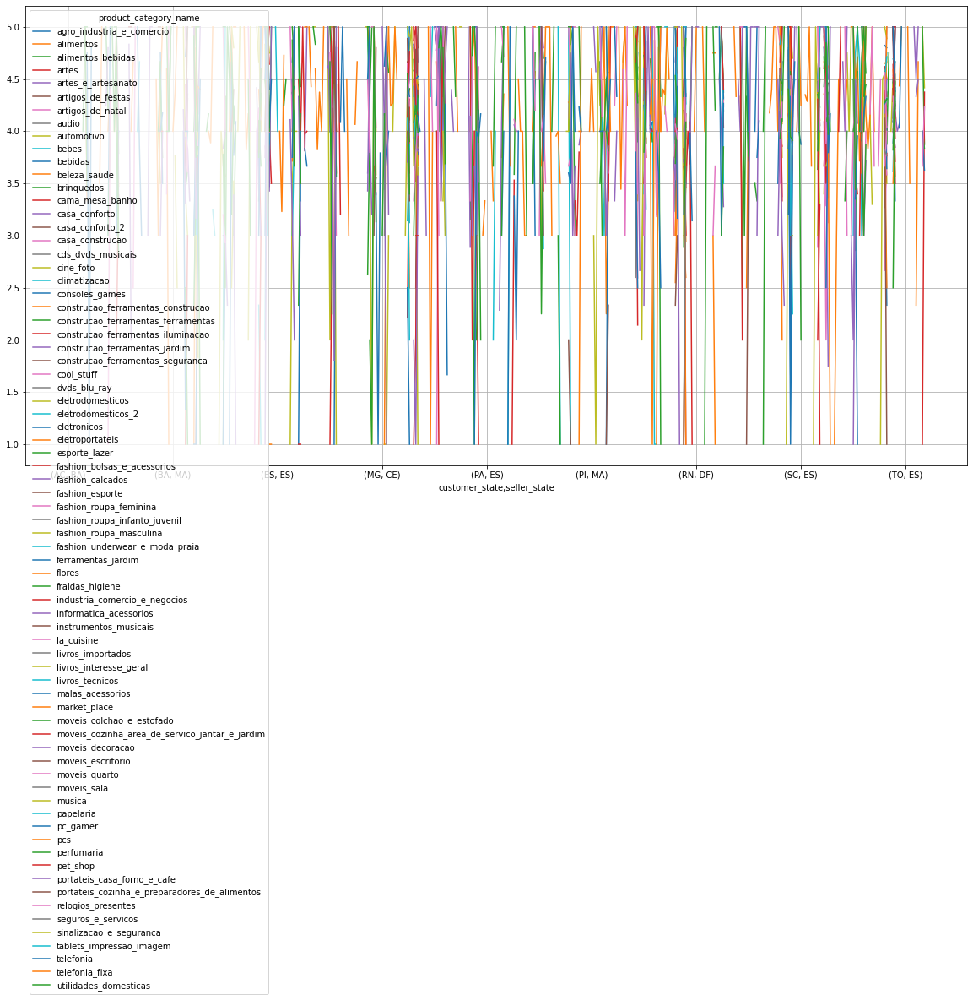

In [78]:
df6.unstack().plot(kind='line',figsize=(20,10), grid=True)

D:\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:337: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


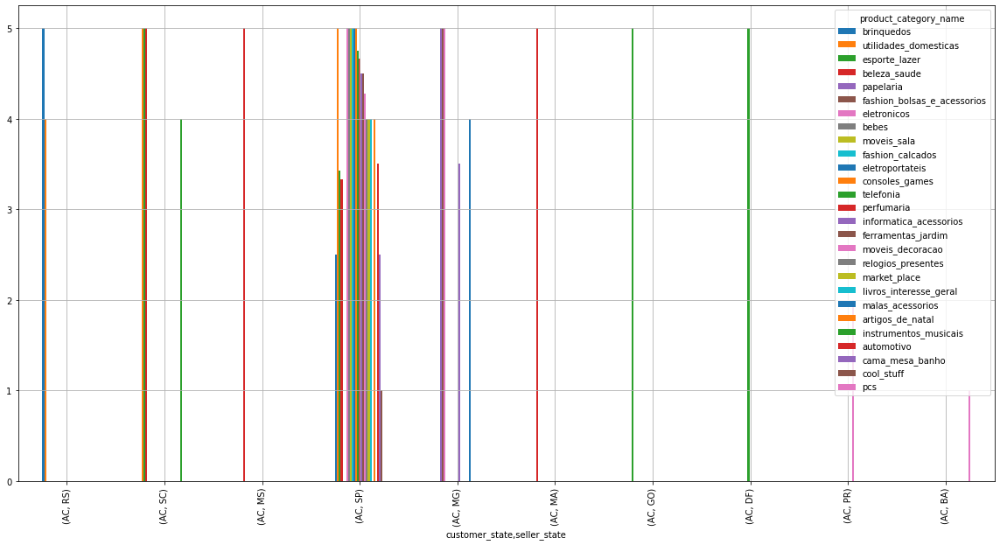

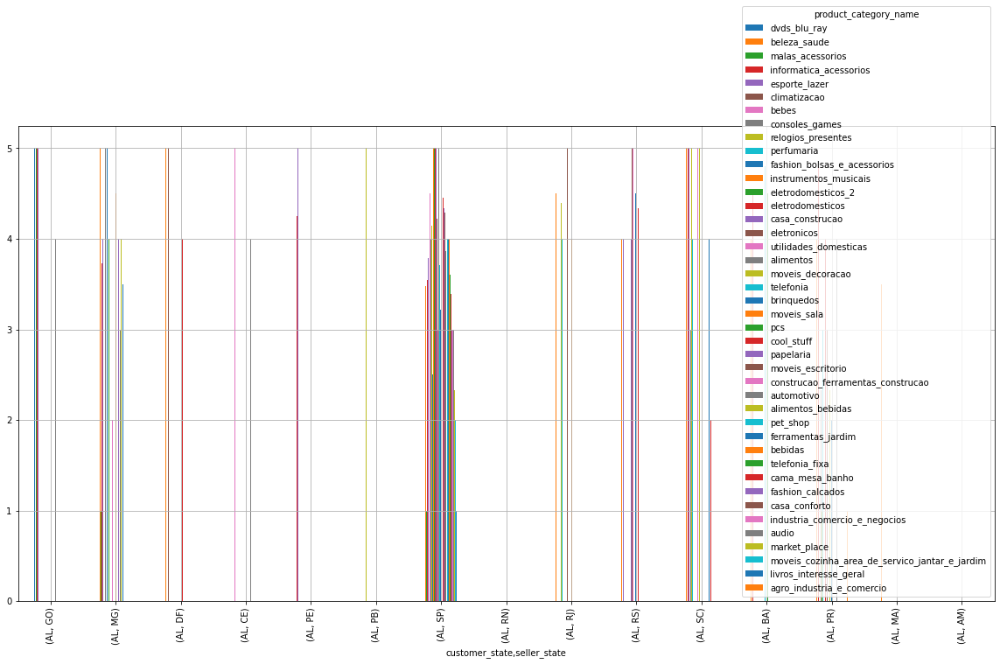

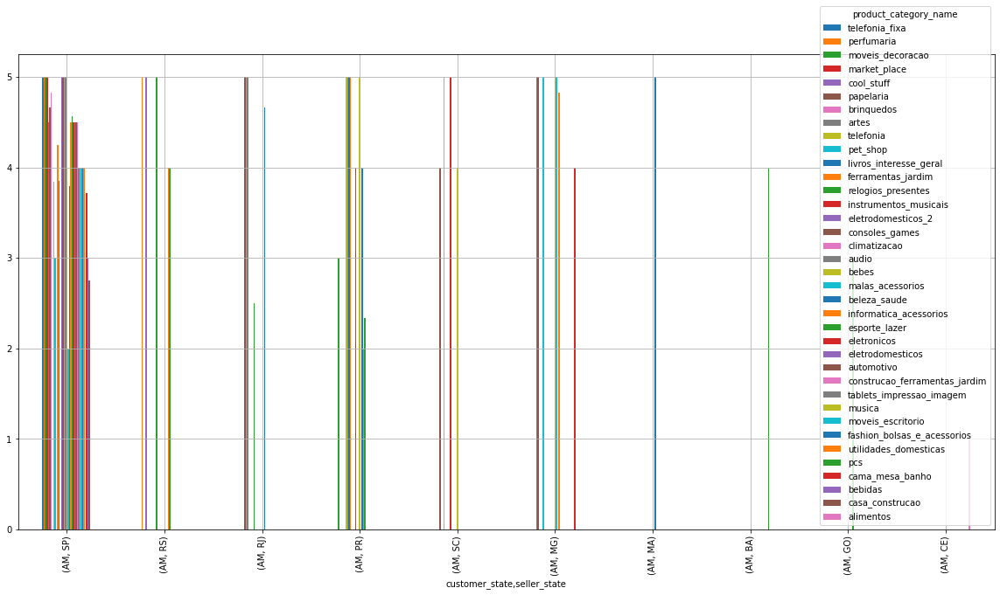

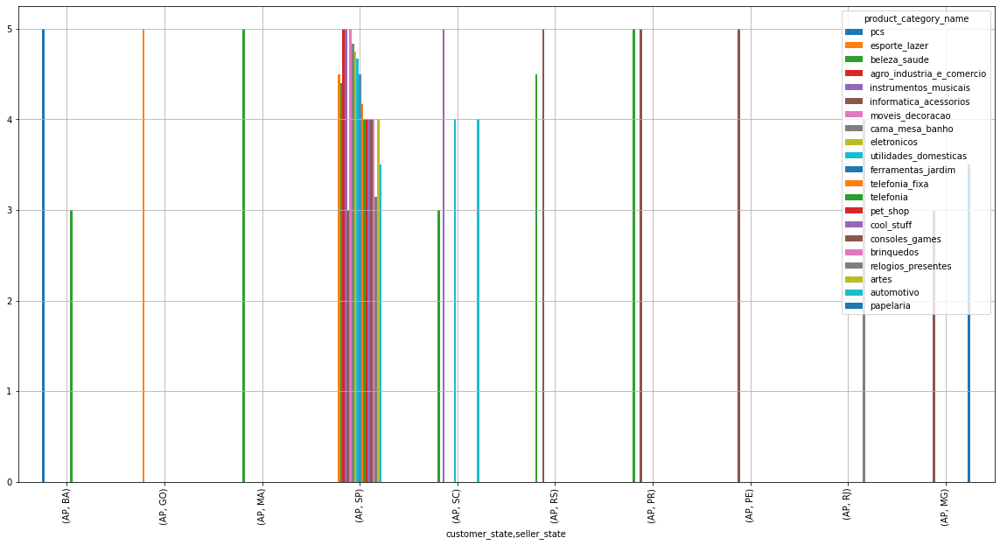

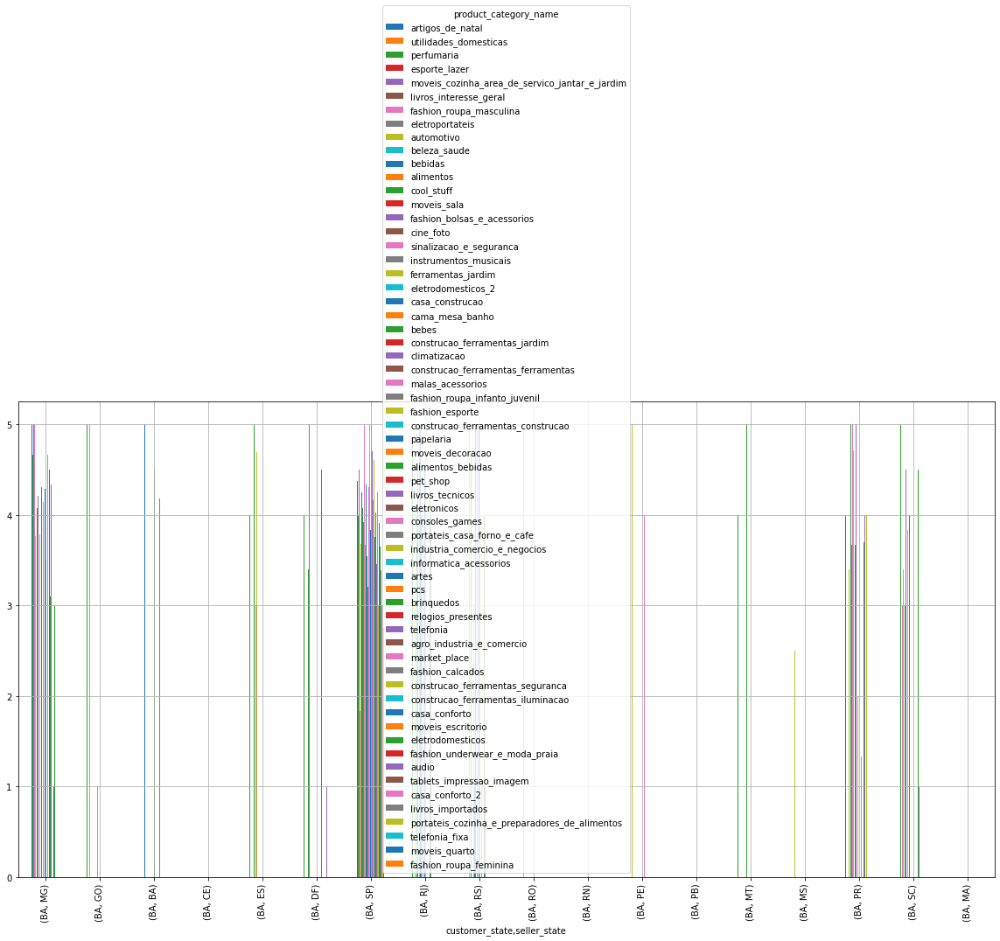

...

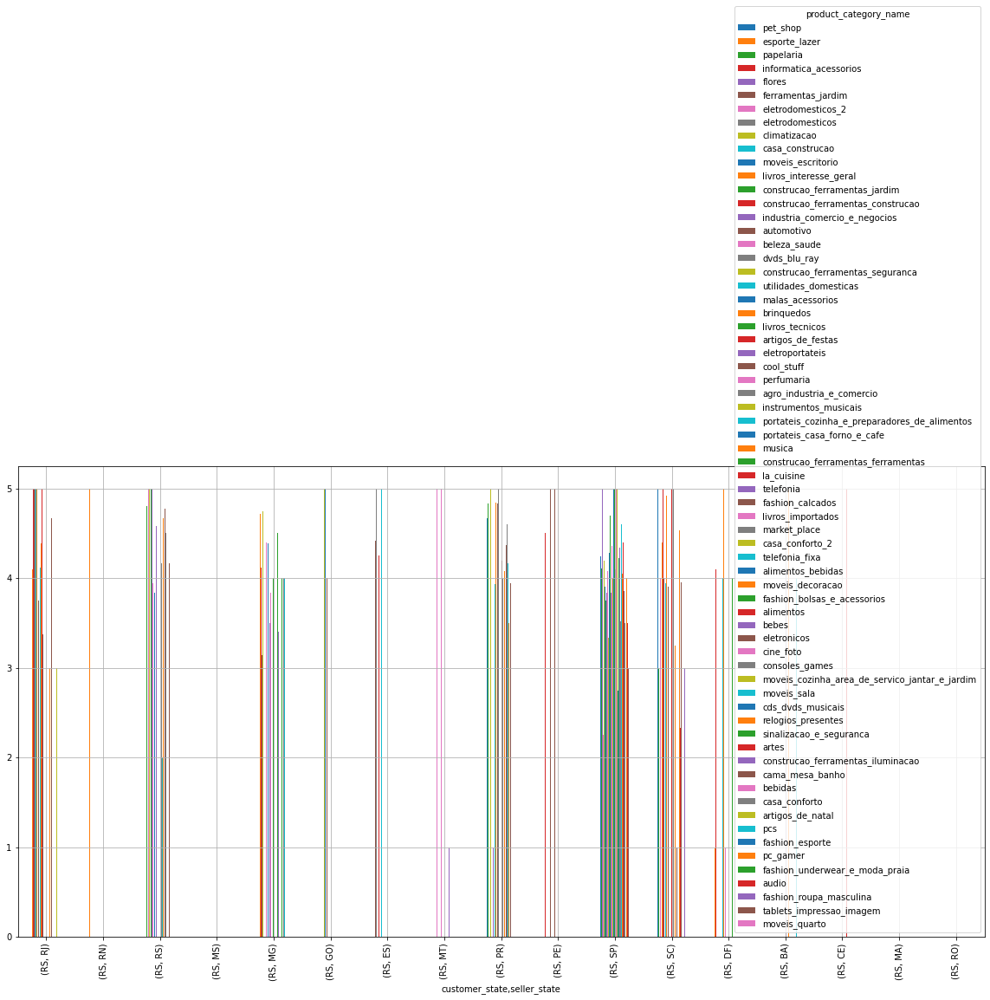

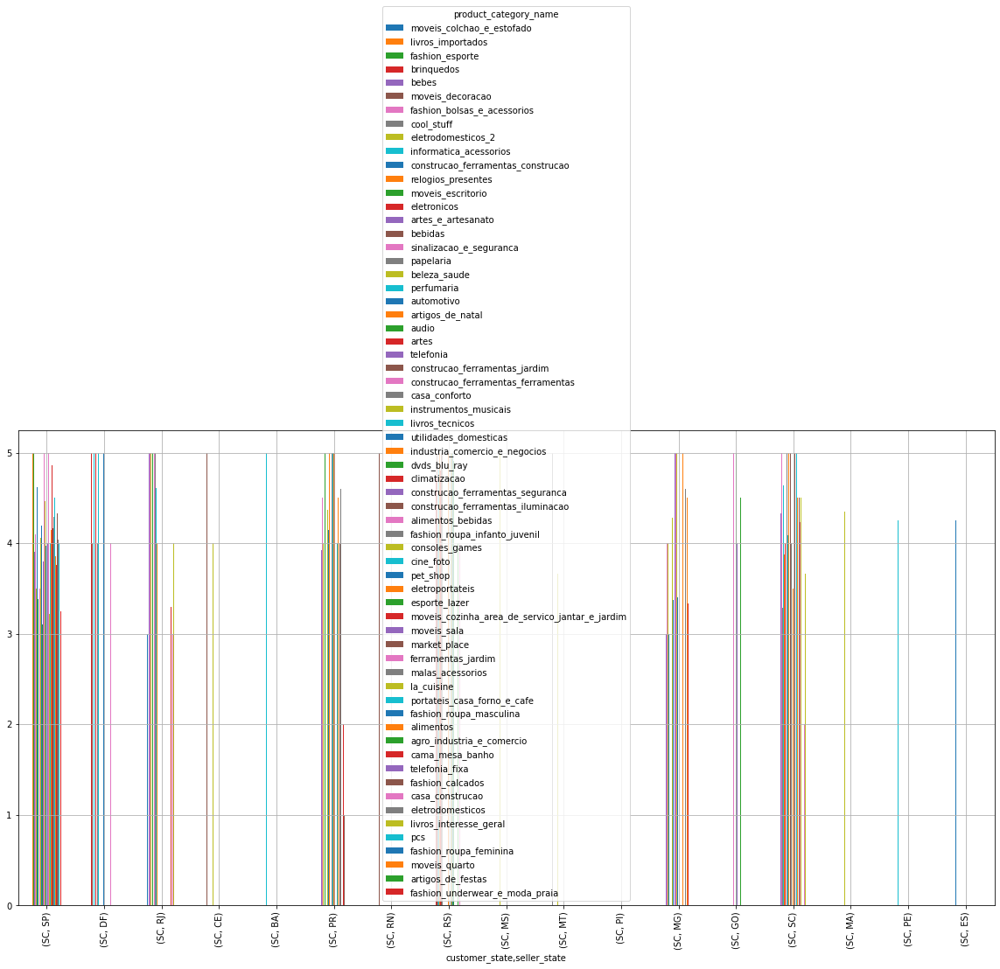

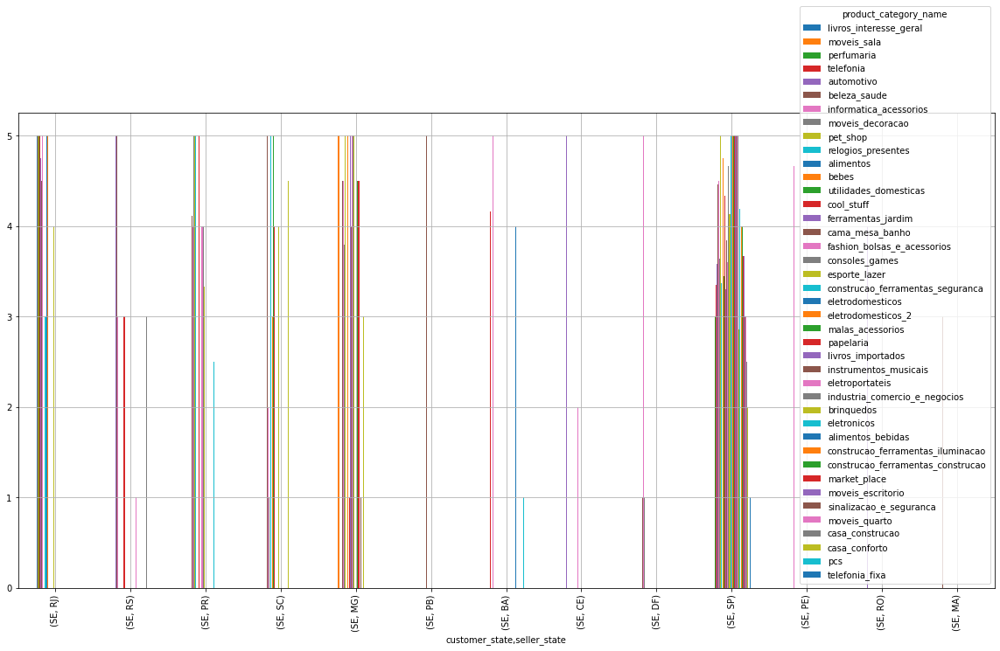

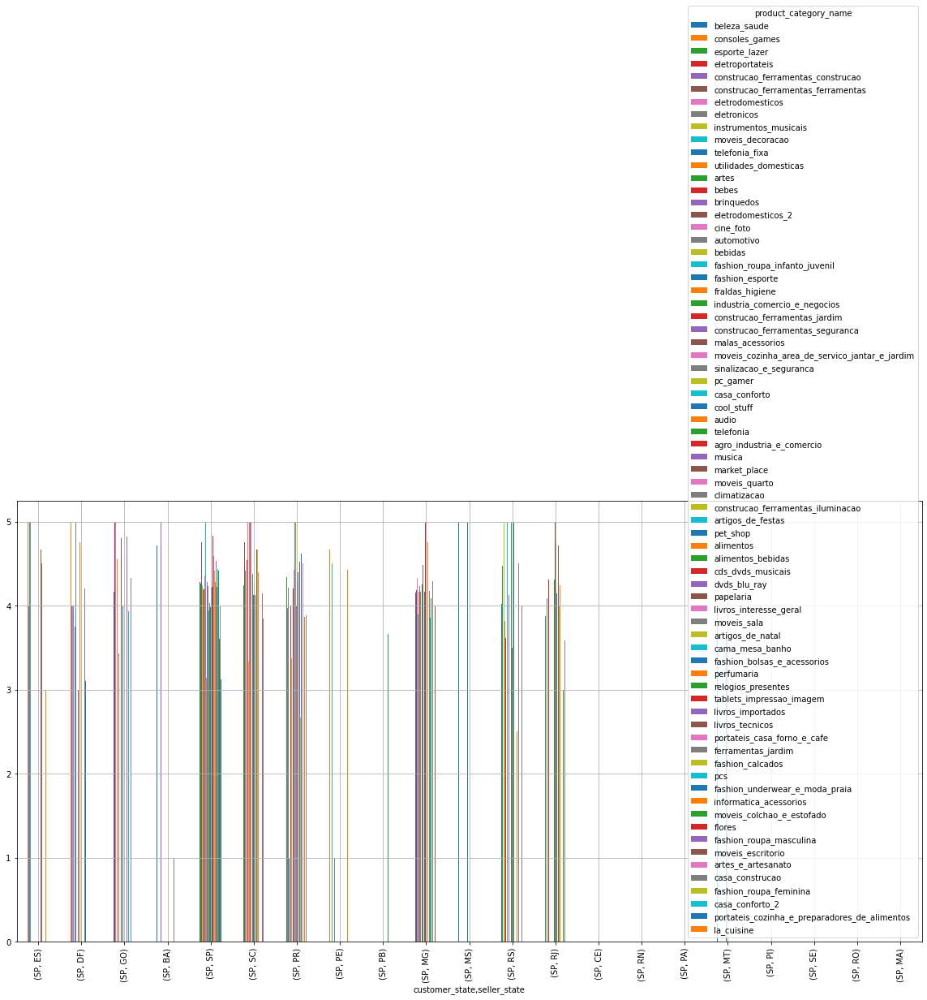

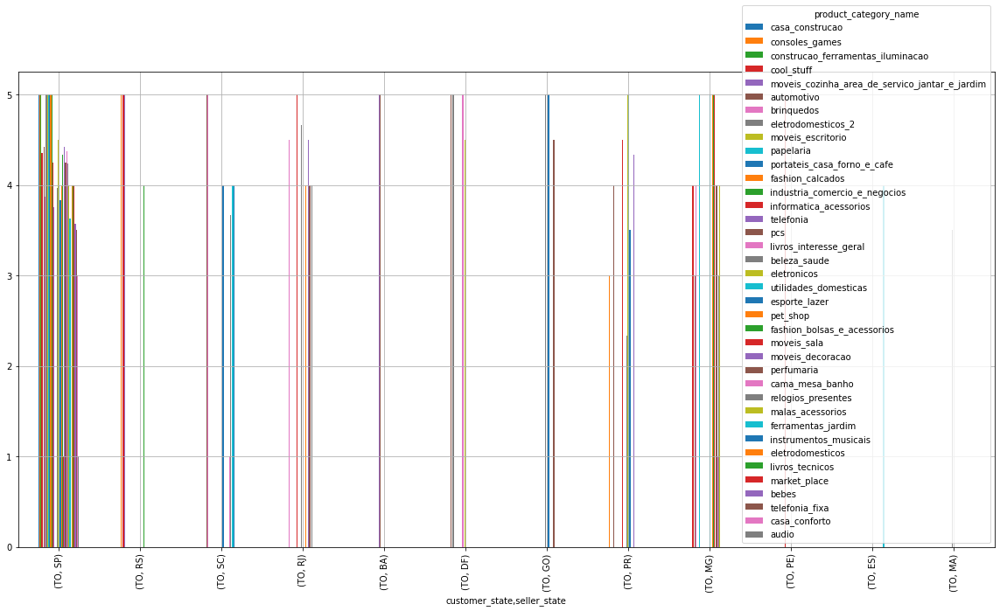

In [79]:
for title, group in df6.groupby('customer_state'):
    group.unstack().plot(kind='bar',figsize=(20,10), grid=True)

# Average category rating by buyer status and by delivery time

In [80]:
df8=olist_sellers_mg.groupby(["product_category_name","customer_state","review_score",])['diff_purchase_deliver_customer'].mean().sort_values(ascending=False)
df8

product_category_name               customer_state  review_score
construcao_ferramentas_iluminacao   MA              2               29.0
pet_shop                            AL              5               29.0
fashion_bolsas_e_acessorios         PI              1               28.0
musica                              MG              1               28.0
construcao_ferramentas_ferramentas  RS              1               28.0
                                                                    ... 
moveis_escritorio                   MS              4                0.0
portateis_casa_forno_e_cafe         MT              3                0.0
moveis_escritorio                   SC              2                0.0
pet_shop                            RO              1                0.0
beleza_saude                        SE              2                0.0
Name: diff_purchase_deliver_customer, Length: 4247, dtype: float64

<AxesSubplot:xlabel='product_category_name,customer_state'>

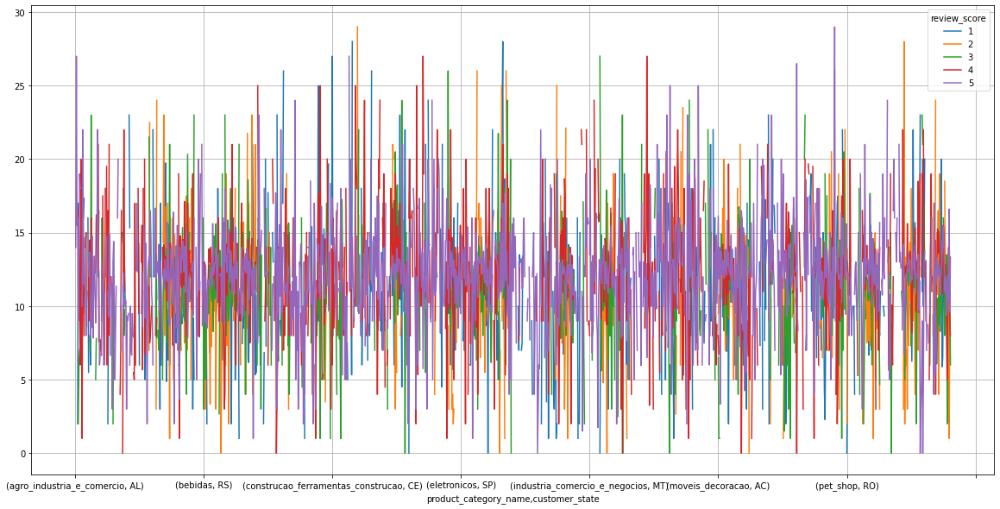

In [81]:
df8.unstack().plot(kind='line',figsize=(20,10), grid=True)

D:\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:337: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


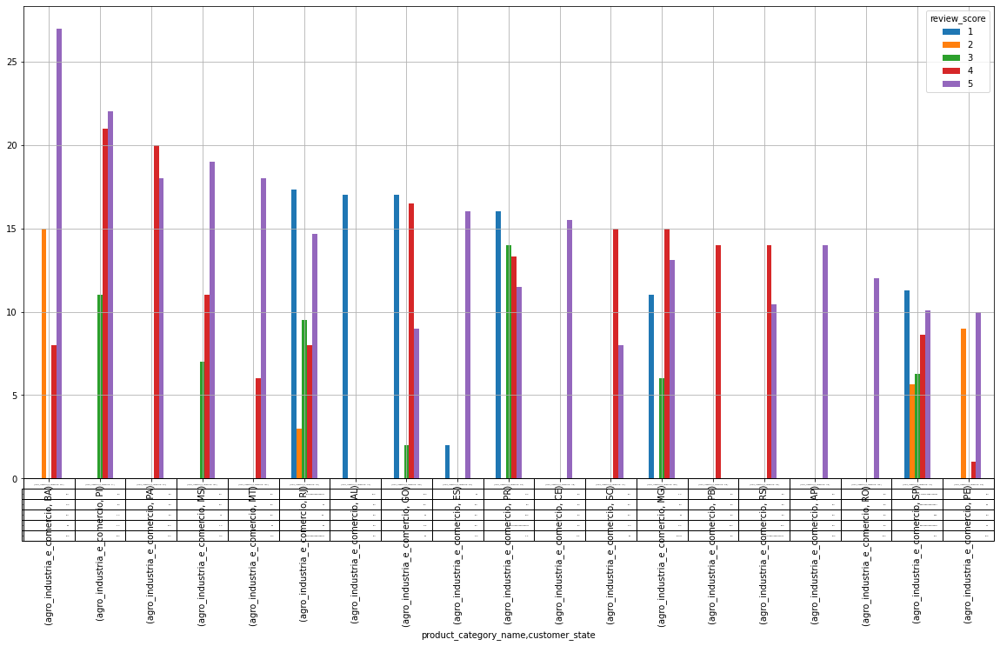

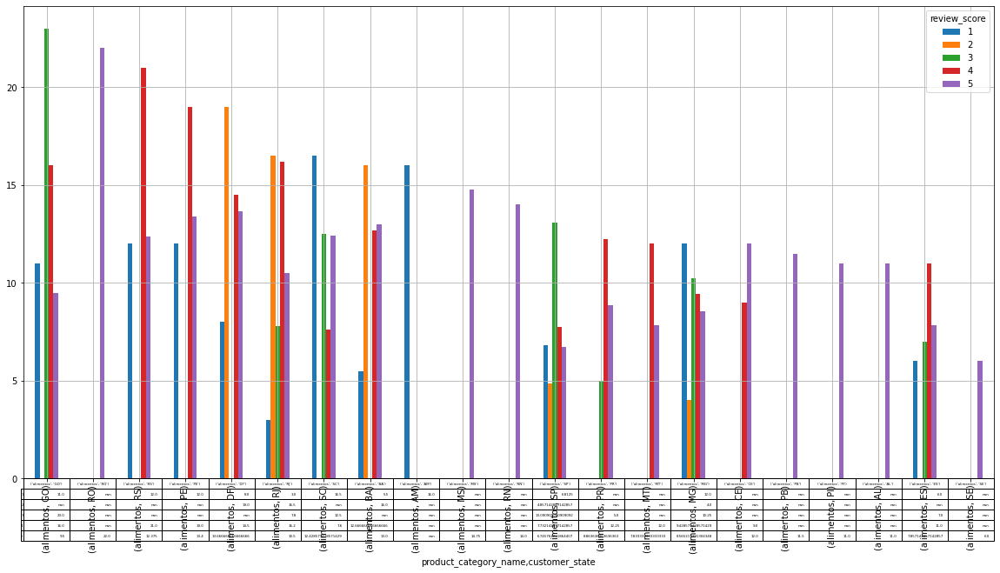

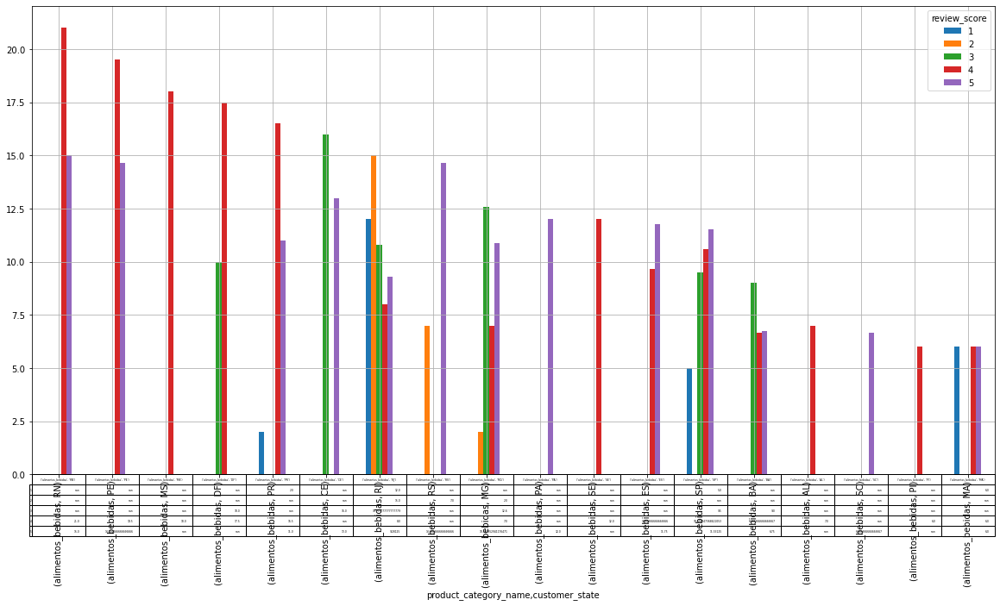

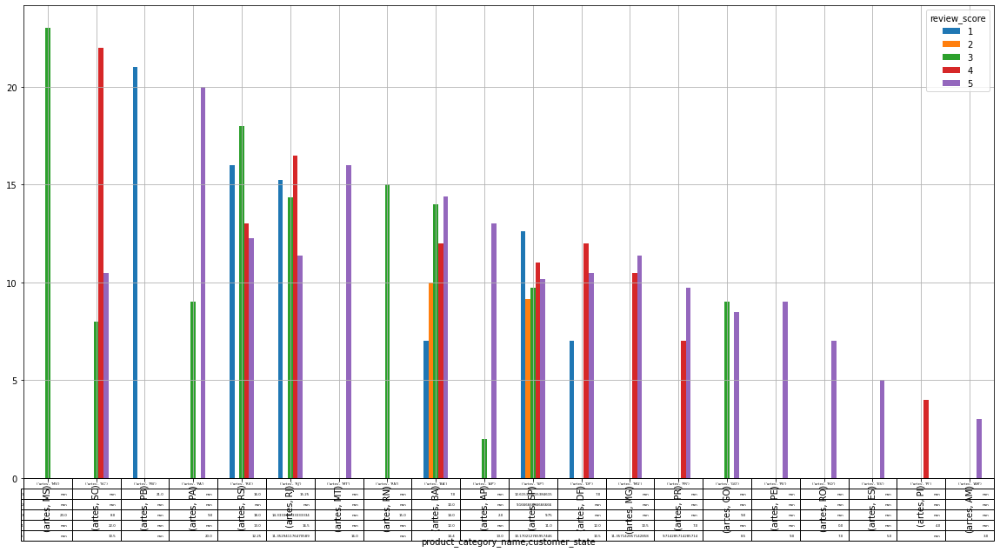

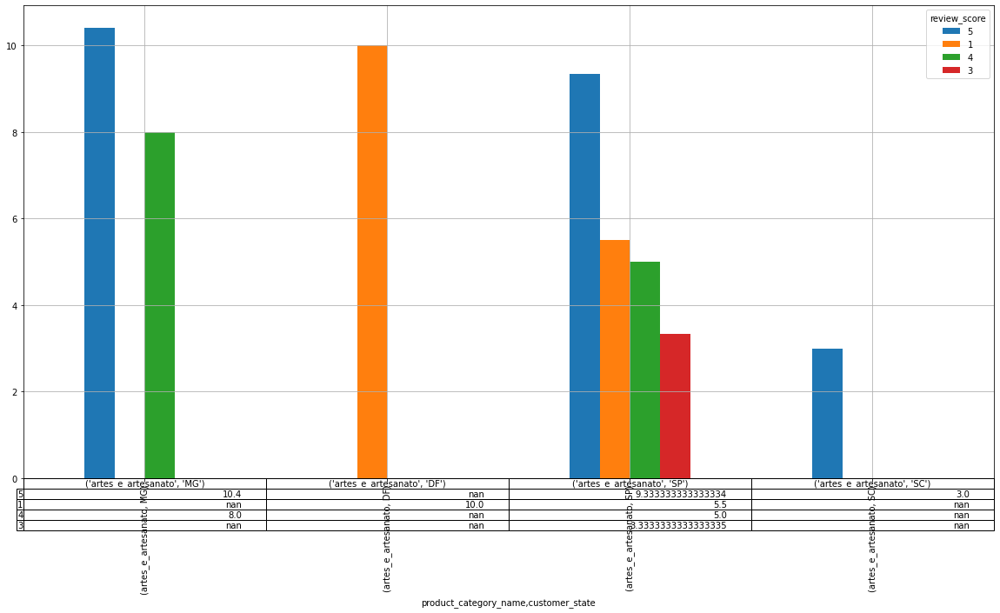

...

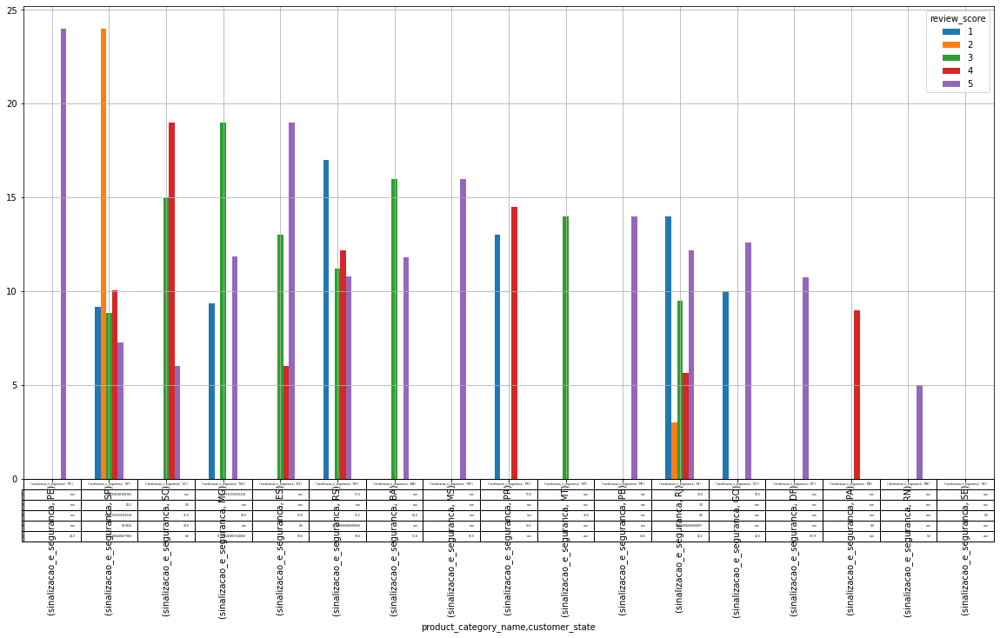

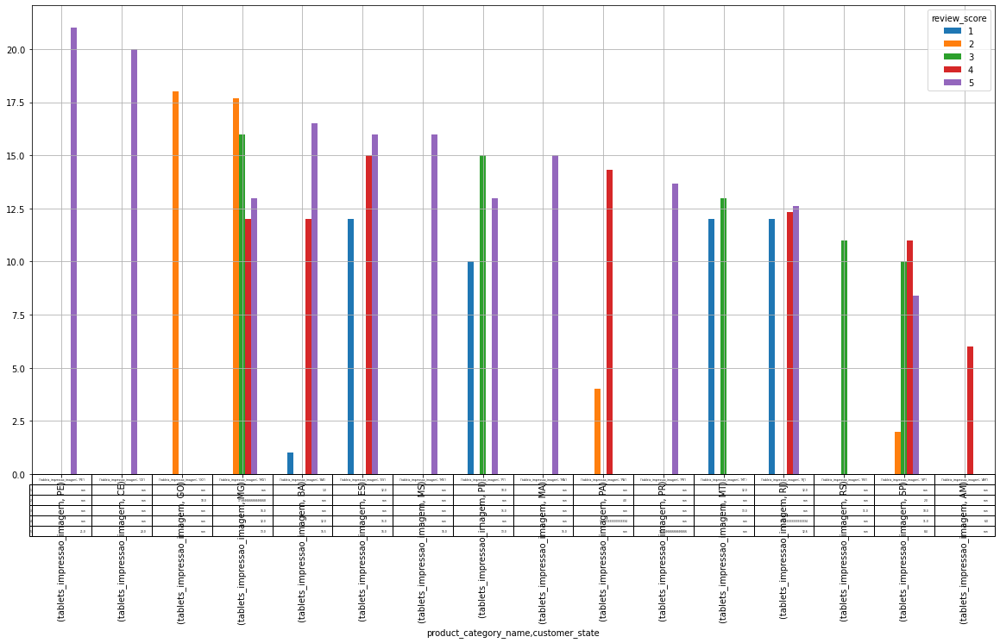

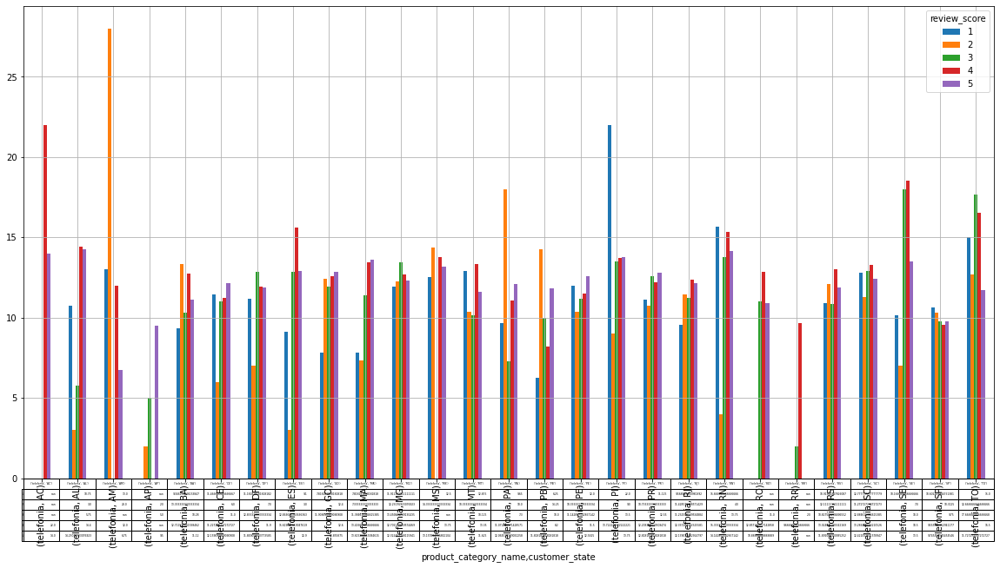

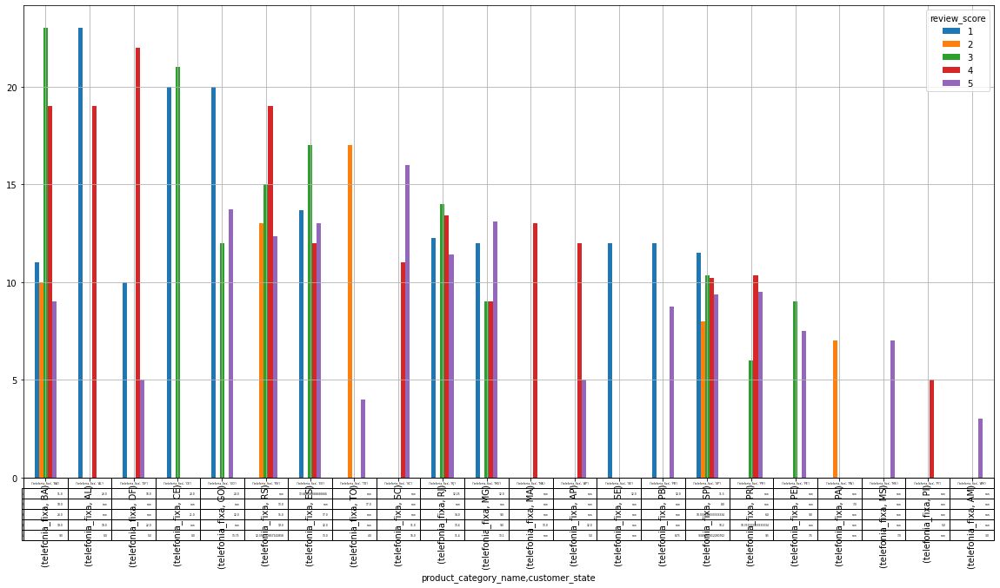

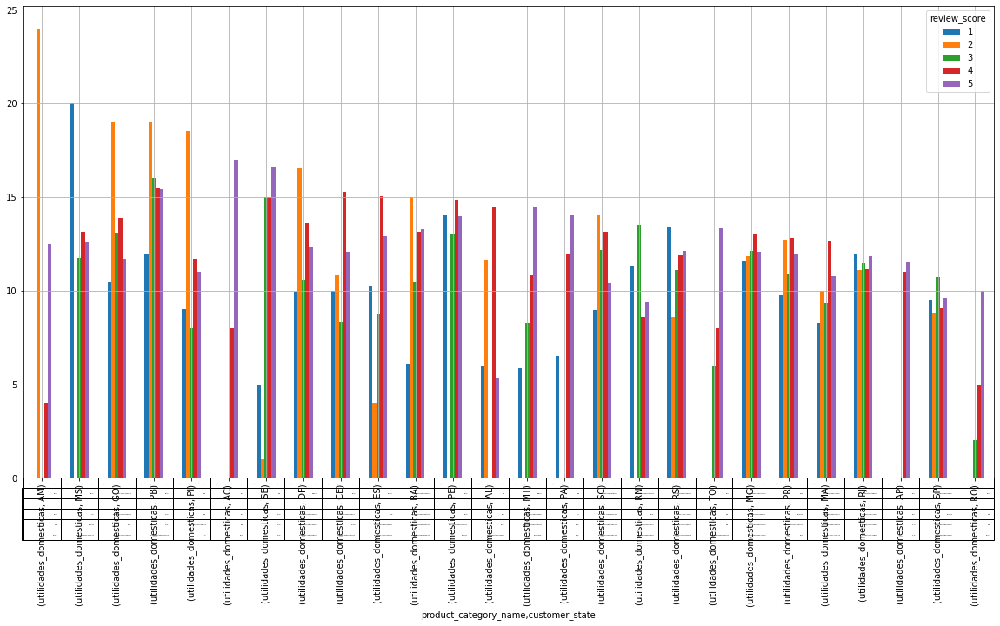

In [82]:
for title, group in df8.groupby('product_category_name'):
    group.unstack().plot(kind='bar',figsize=(20,10), table=True, grid=True)

# Best selling products by state. (Grouped by product and grouped by state)

In [83]:
df9=olist_sellers_mg.groupby(["customer_state","product_category_name"])['product_category_name'].count().sort_values(ascending=False)
df9

customer_state  product_category_name           
SP              cama_mesa_banho                     5233
                beleza_saude                        4146
                esporte_lazer                       3594
                moveis_decoracao                    3484
                utilidades_domesticas               3193
                                                    ... 
RN              construcao_ferramentas_seguranca       1
                casa_construcao                        1
                casa_conforto                          1
DF              artigos_de_festas                      1
AC              artigos_de_natal                       1
Name: product_category_name, Length: 1362, dtype: int64

<AxesSubplot:xlabel='customer_state'>

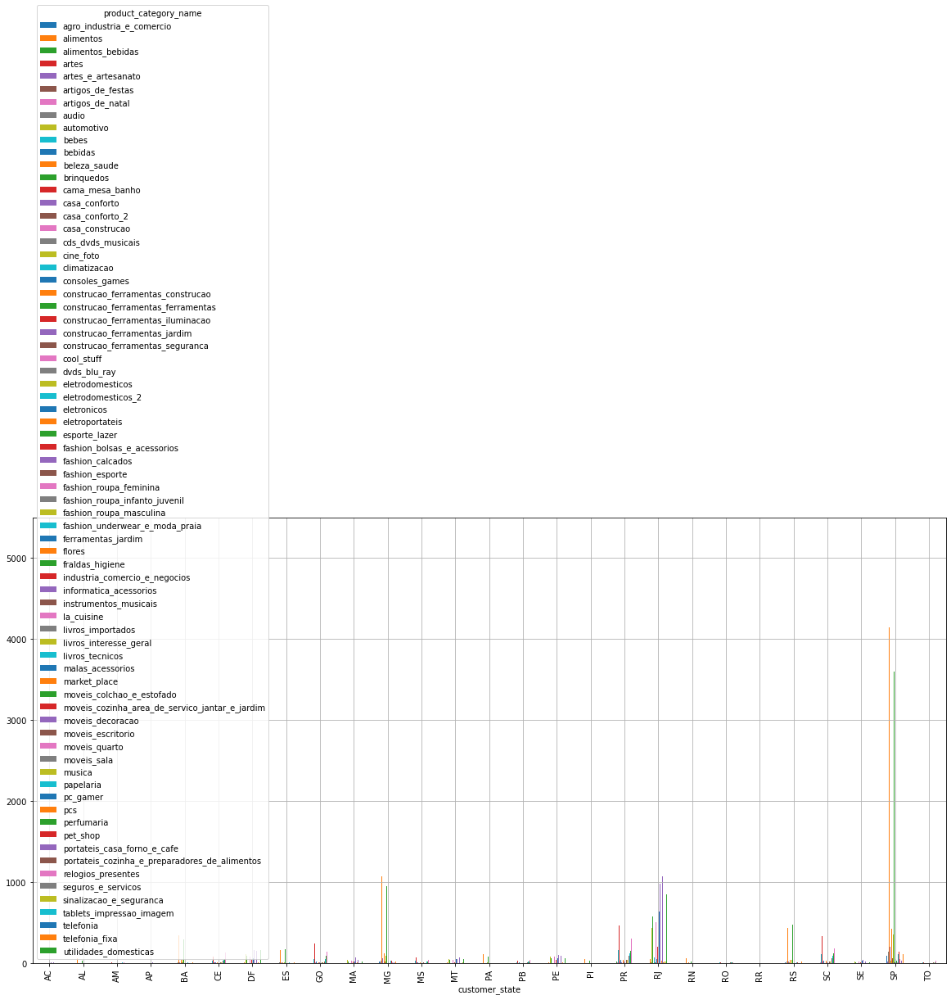

In [84]:
df9.unstack().plot(kind='bar',figsize=(20,10), grid=True)

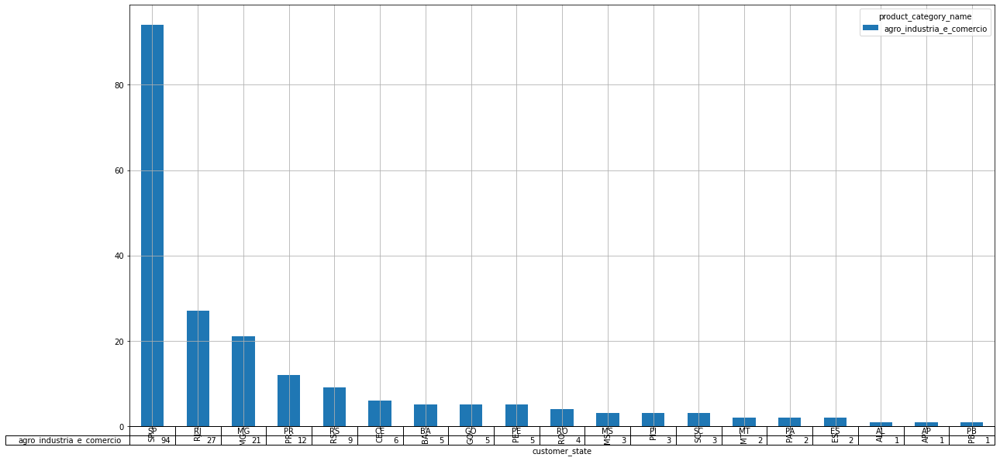

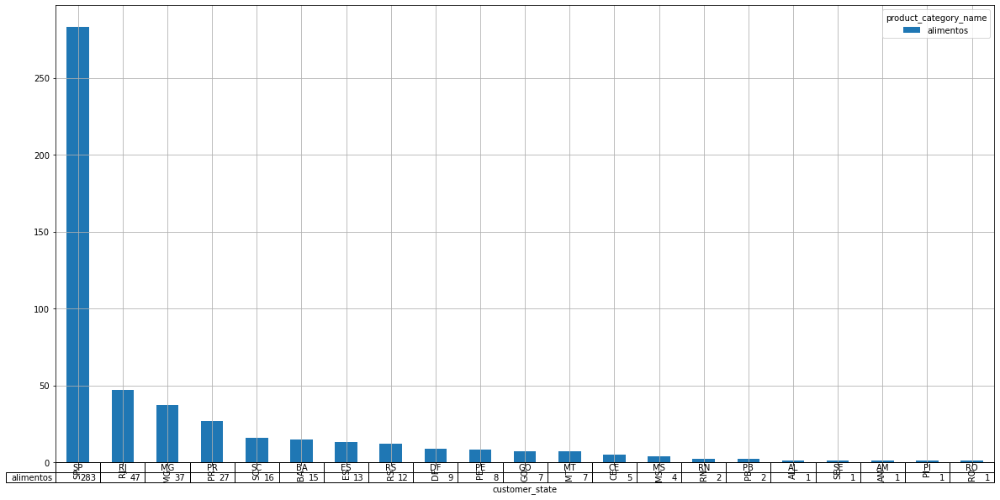

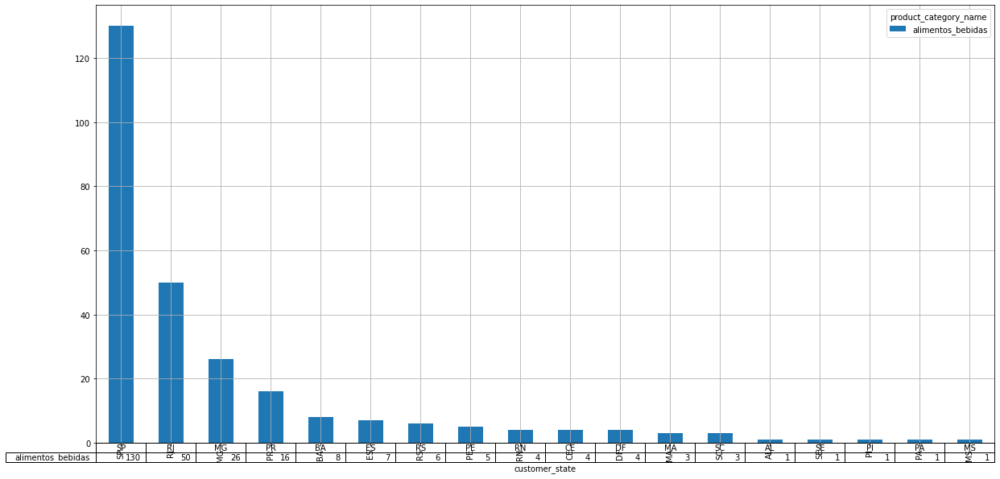

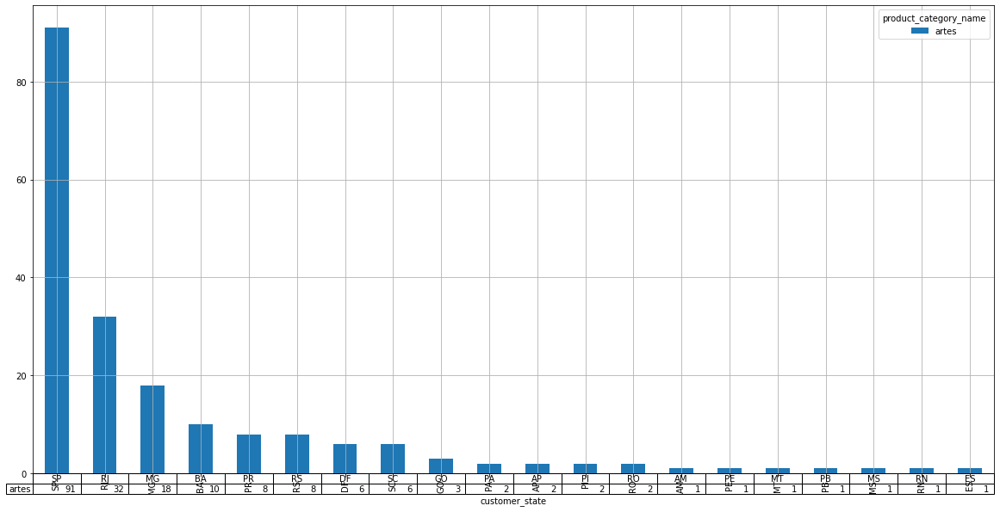

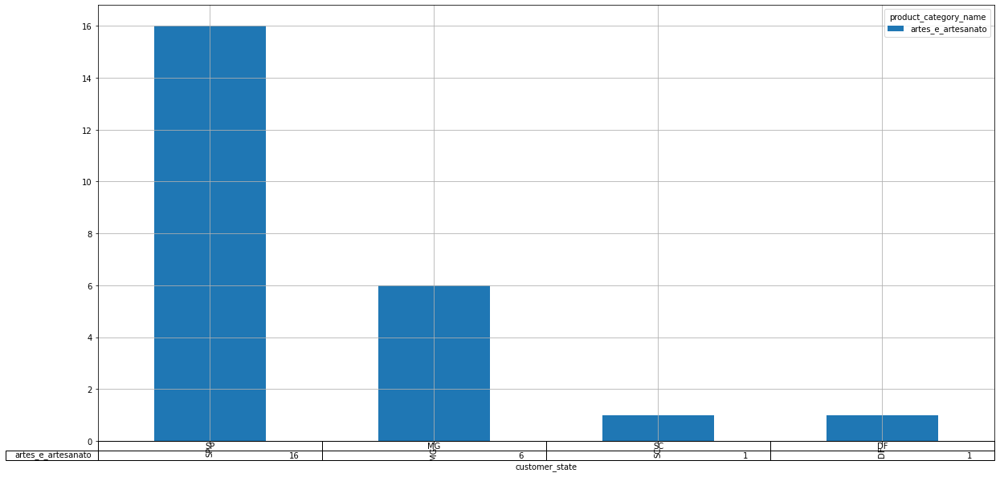

...

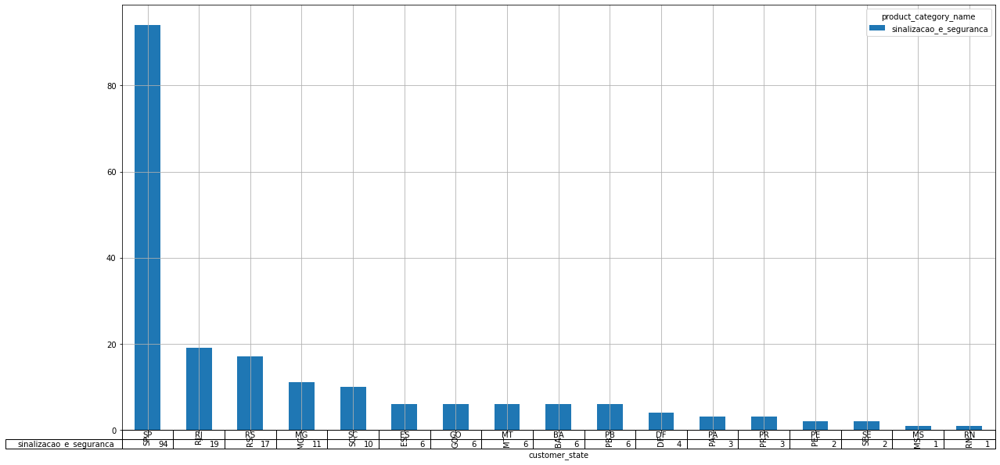

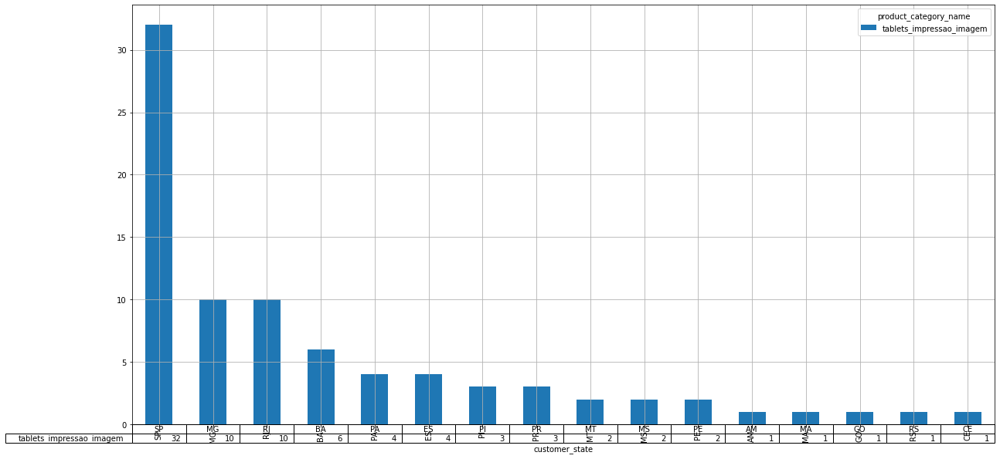

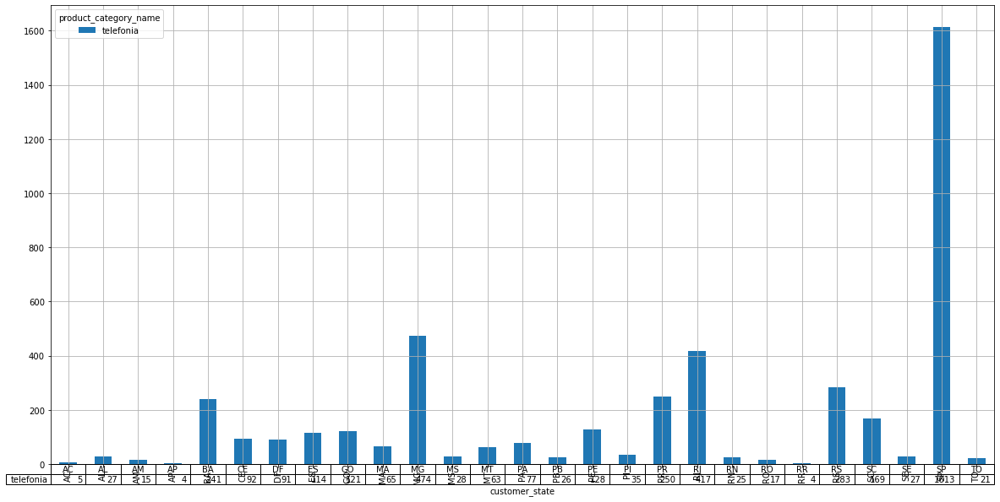

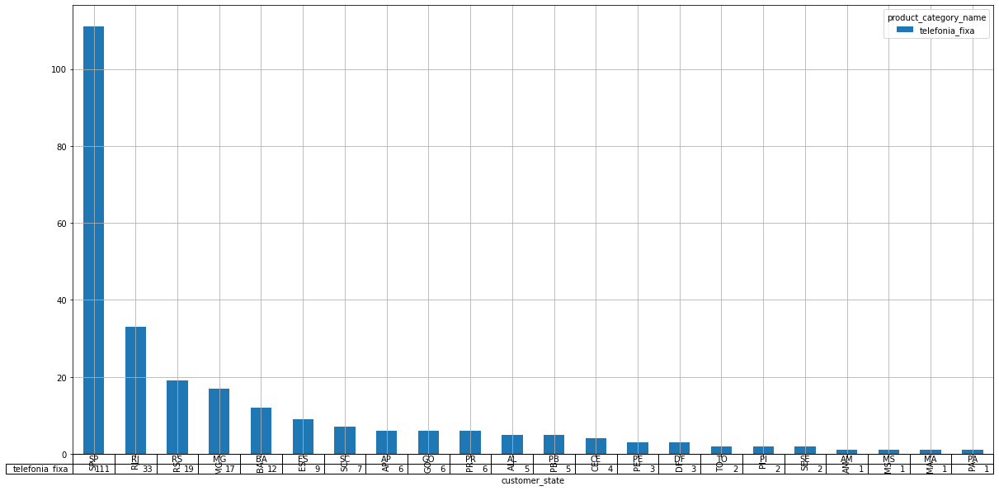

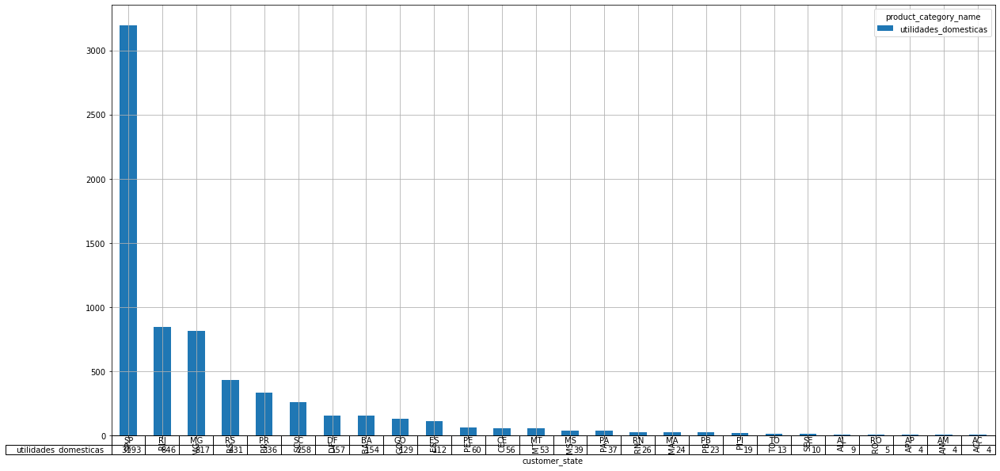

In [85]:
for title, group in df9.groupby('product_category_name'):
    group.unstack().plot(kind='bar',figsize=(20,10), table=True, grid=True)

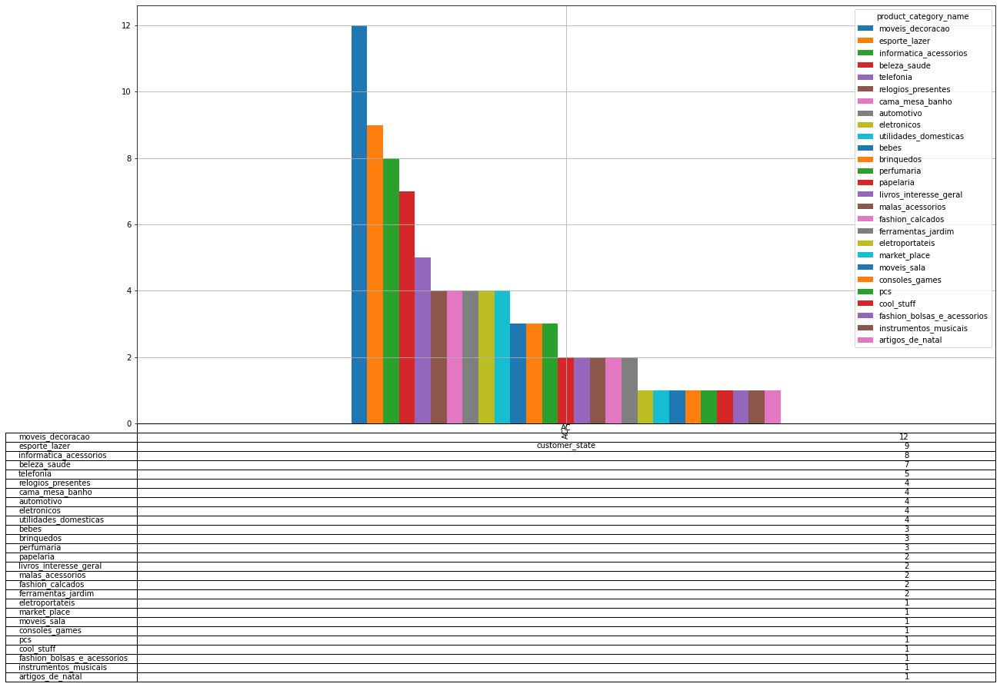

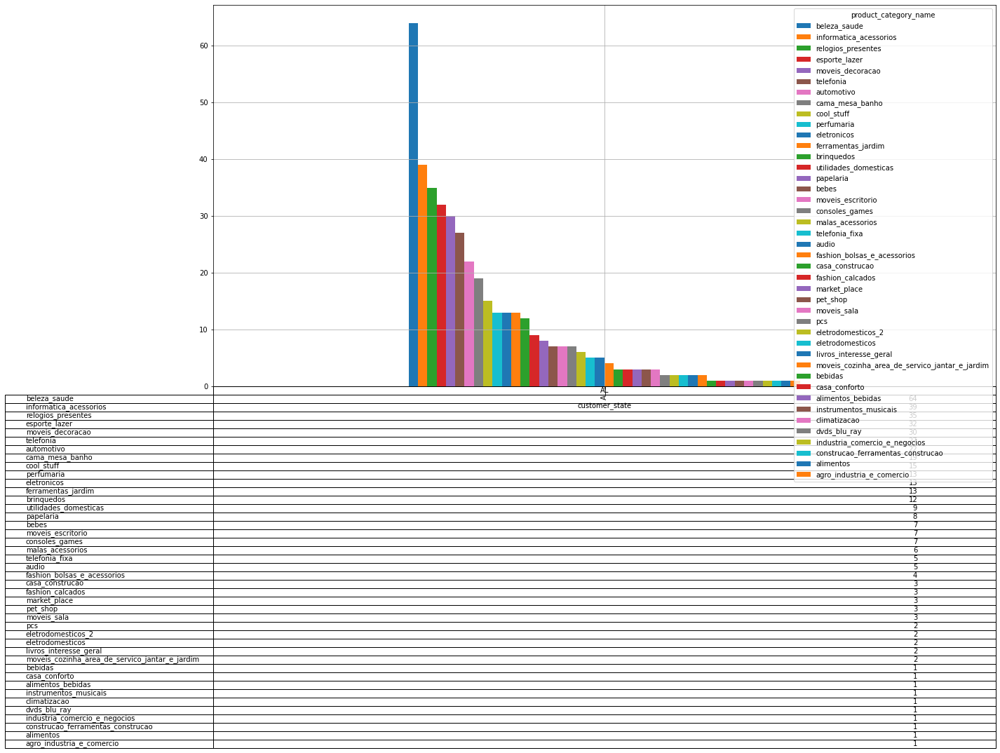

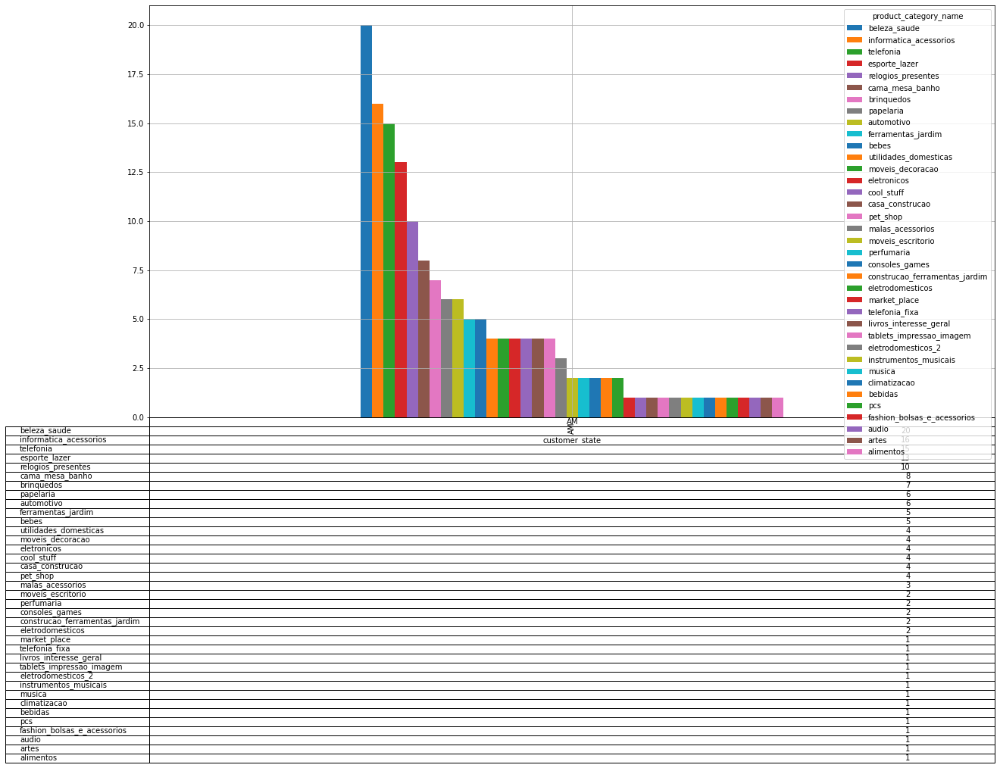

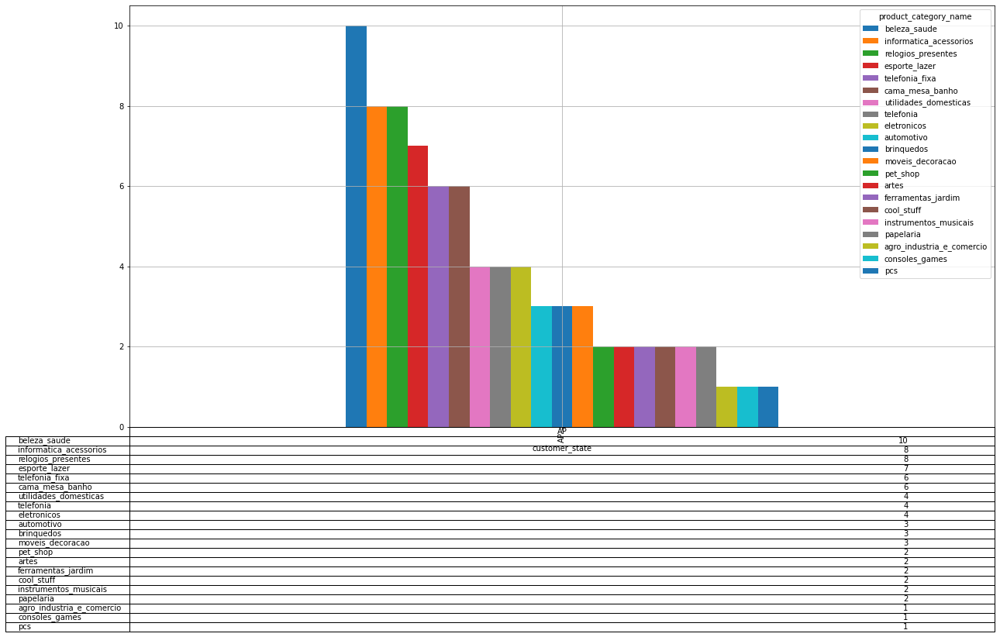

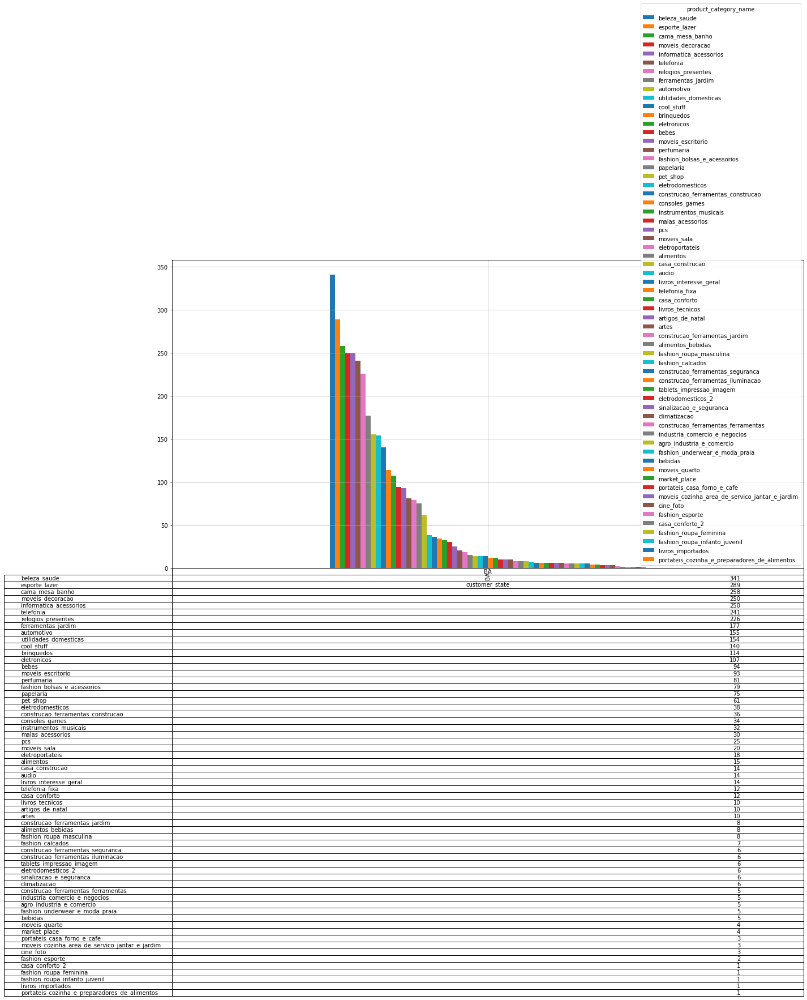

...

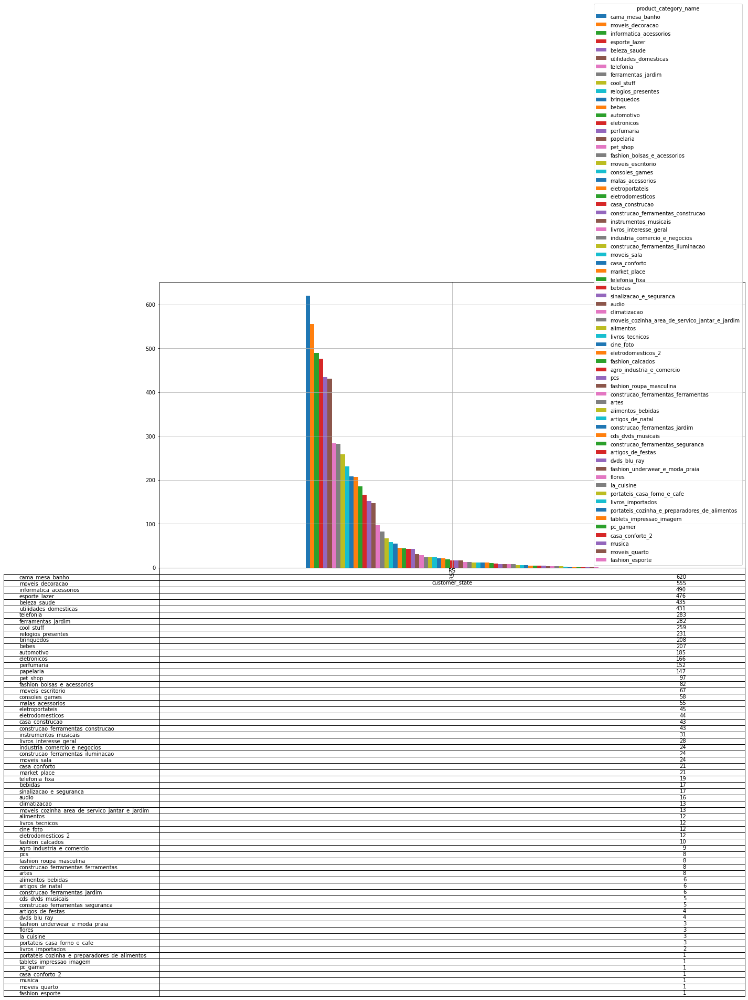

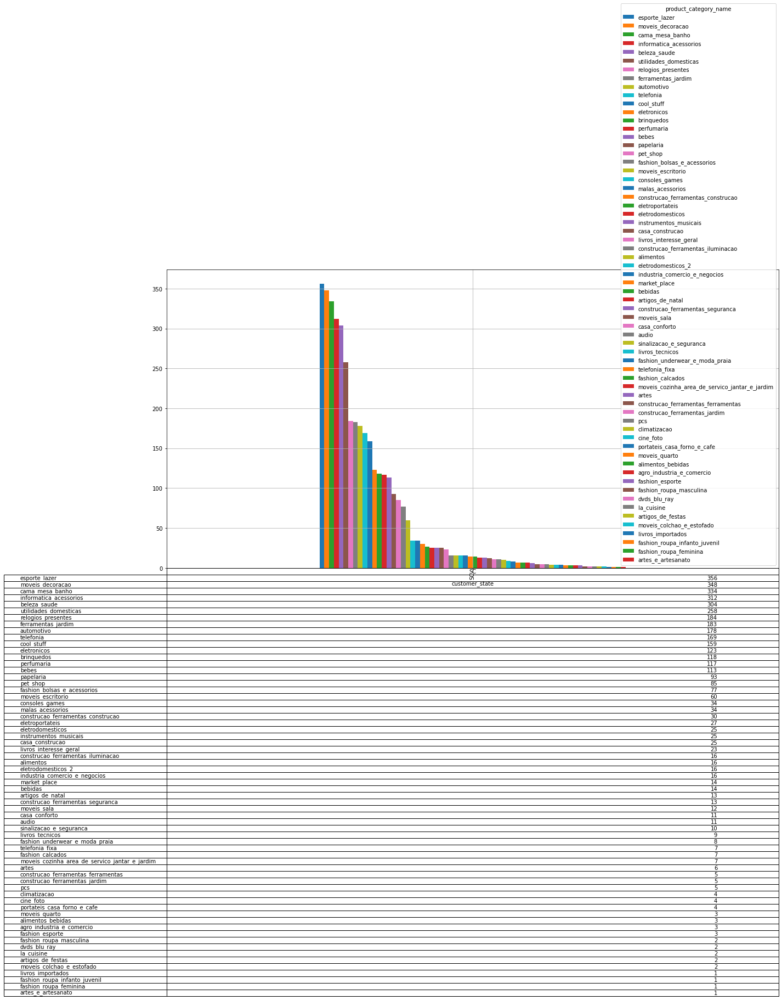

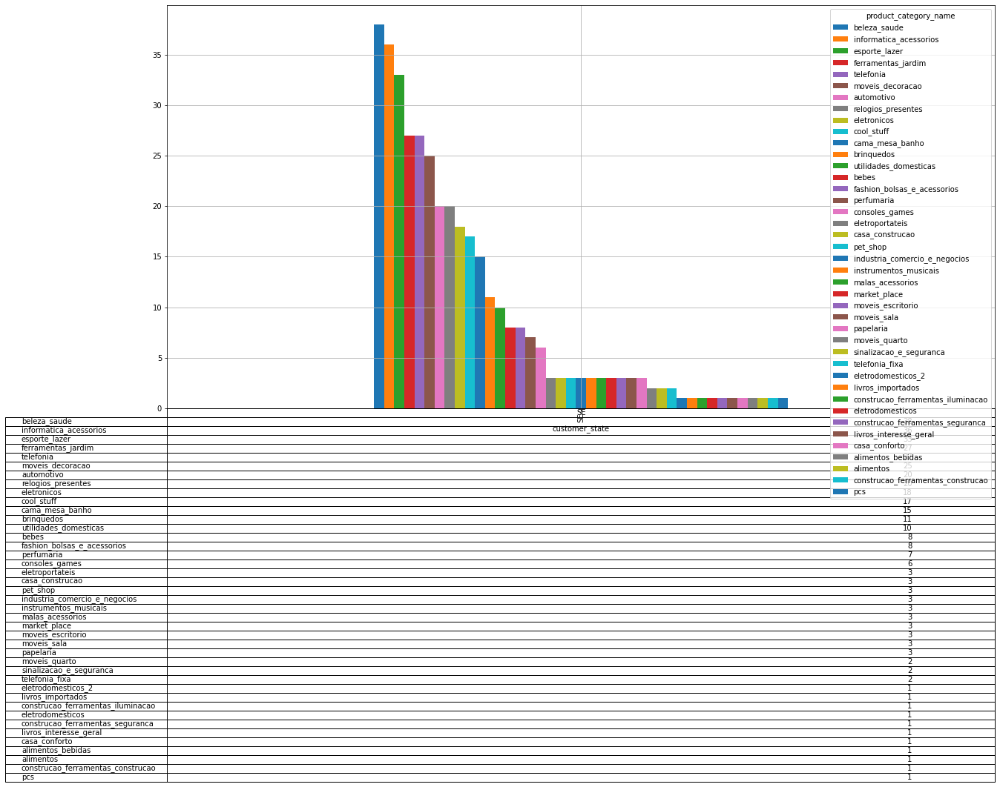

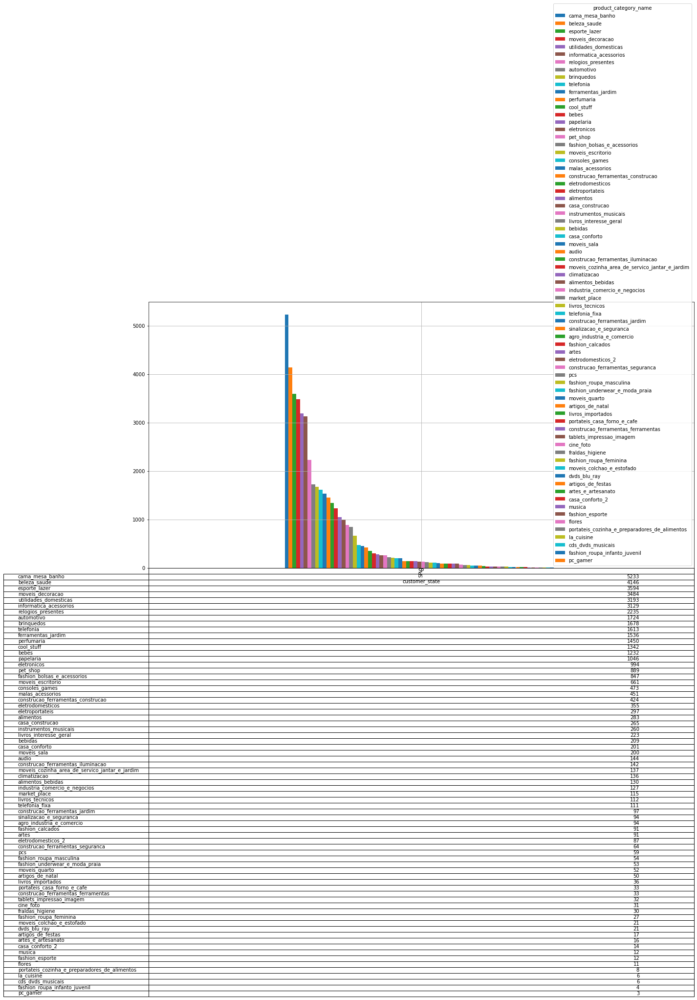

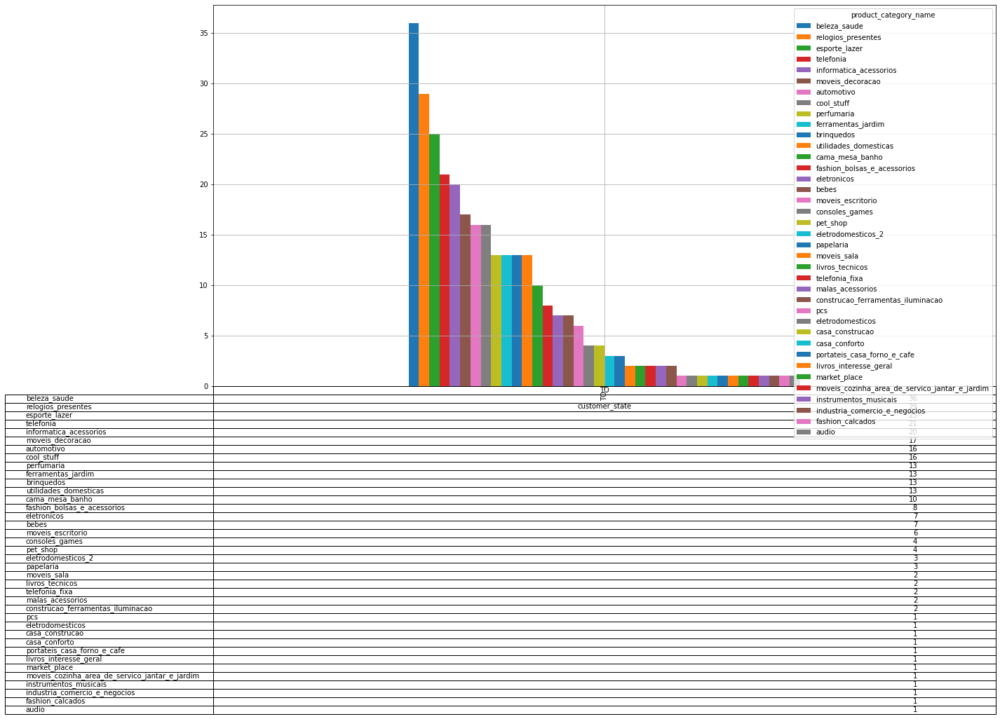

In [86]:
for title, group in df9.groupby('customer_state'):
    group.unstack().plot(kind='bar',figsize=(20,10), table=True, grid=True)